# 1. Introduction

Dermoscopic image classification of skin lesions benefits from robust deep ensembles.
This notebook implements, evaluates, and analyzes an ensemble of CNN, ResNet-50, ViT, DenseNet-121, EfficientNet-B3, ConvNeXt-Tiny, and MobileNetV3 on HAM10000 with rigorous, journal-grade reporting.

# 	2.	Materials and Methods

## 2.1 Environment Setup

### Install Required Libraries (Torch, Vision, Sklearn, etc.)

In [4]:
!pip install -q torch torchvision scikit-learn matplotlib pandas

### Install Additional Dependencies (Statsmodels for McNemar’s Test)

In [86]:
!pip install -q statsmodels

### Import Libraries and Define Device

In [95]:
# Core 
import os
import time
import random
import copy
from pathlib import Path
import warnings
import numpy as np
import pandas as pd

# Plotting
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
from matplotlib.patches import Patch
import seaborn as sns

# Imaging
from PIL import Image
import cv2                        # optional: used for Grad-CAM overlays
from skimage.transform import resize  # used to match CAM mask sizes

# Progress
from tqdm import tqdm

# PyTorch
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import Adam
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset, WeightedRandomSampler

from torchvision import models, transforms
from torchvision.datasets.folder import default_loader

# Specific torchvision models
from torchvision.models import (
    resnet50,            ResNet50_Weights,
    densenet121,         DenseNet121_Weights,
    efficientnet_b3,     EfficientNet_B3_Weights,
    convnext_tiny,       ConvNeXt_Tiny_Weights,
    mobilenet_v3_large,  MobileNet_V3_Large_Weights,
)

# Transformers (ViT)
from transformers import ViTForImageClassification, ViTImageProcessor, ViTConfig

# Grad-CAM
from pytorch_grad_cam import GradCAM as PTGradCAM  # used with CNN/ResNet flows
from pytorch_grad_cam import GradCAM               # used with ViT reshape flow/context manager
from pytorch_grad_cam.utils.image import show_cam_on_image
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget

# SciPy (Hungarian assignment for label-alignment) 
from scipy.optimize import linear_sum_assignment

# Scikit-learn
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
from sklearn.metrics import (
    accuracy_score, f1_score, roc_auc_score,
    confusion_matrix, ConfusionMatrixDisplay,
    classification_report, roc_curve, auc
)

# Statistical tests
from statsmodels.stats.contingency_tables import mcnemar
from scipy.stats import binomtest

# Device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


### Global Label Mapping & Class Names

In [6]:
df = pd.read_csv("/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_metadata.csv")
label_map = {name:i for i,name in enumerate(sorted(df['dx'].unique()))}
class_names = [k for k,_ in sorted(label_map.items(), key=lambda x:x[1])]
df['label'] = df['dx'].map(label_map).astype(int)

### Globals & Paths (Once)

In [7]:
# Canonical class list must already exist (we have it from 'Global Label Mapping & Class Names')
assert 'class_names' in globals() and isinstance(class_names, (list, tuple)) and len(class_names) > 0, \
    "Define class_names first (canonical order)."
NUM_C = len(class_names)

# Image folders and resolver (used throughout the ensemble cells)
IMG_DIRS = [
    "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_1",
    "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_2",
]

def find_image_path_from_id(image_id: str):
    fname = f"{image_id}.jpg"
    for d in IMG_DIRS:
        p = os.path.join(d, fname)
        if os.path.exists(p):
            return p
    return None

### Define ROC-AUC Plotting Utility (Global)

In [8]:
def plot_multiclass_roc(all_labels, all_probs, class_names, title, outfile):
    """
    all_labels: 1D array-like of true integer labels (0..C-1)
    all_probs:  2D array-like of predicted probabilities, shape [N, C]
    class_names: list of class names in the same index order
    """
    y_true = label_binarize(all_labels, classes=list(range(len(class_names))))
    y_prob = np.asarray(all_probs)

    plt.figure(figsize=(10, 8))
    for i, cname in enumerate(class_names):
        fpr, tpr, _ = roc_curve(y_true[:, i], y_prob[:, i])
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, label=f"{cname} (AUC = {roc_auc:.2f})")

    plt.plot([0, 1], [0, 1], 'k--', label='Random')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(title)
    plt.legend(loc='lower right')
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(outfile, dpi=300)
    plt.show()

    macro_auc = roc_auc_score(y_true, y_prob, average='macro')
    micro_auc = roc_auc_score(y_true, y_prob, average='micro')
    print(f"Macro AUC: {macro_auc:.4f}")
    print(f"Micro AUC: {micro_auc:.4f}")

## 2.2 Dataset Preparation

### Custom Dataset Class for HAM10000

In [9]:
class HAM10000Dataset(Dataset):
    def __init__(self, dataframe, image_dirs, transform=None):
        self.data = dataframe
        self.image_dirs = image_dirs
        self.transform = transform
        self.loader = default_loader

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        row = self.data.iloc[idx]
        filename = row['image_id'] + ".jpg"

        # Search for image in both directories
        for d in self.image_dirs:
            img_path = os.path.join(d, filename)
            if os.path.exists(img_path):
                break
        else:
            raise FileNotFoundError(f"Image {filename} not found in provided directories.")

        image = self.loader(img_path).convert("RGB")
        label = torch.tensor(int(row['label']), dtype=torch.long)

        if self.transform:
            image = self.transform(image)

        return image, label

### Load and Prepare HAM10000 Test Dataset

In [10]:
# Point to both image folders
image_dirs = [
    "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_1",
    "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_2",
]

# Load metadata
df = pd.read_csv("/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_metadata.csv")

# Map dx -> integer label (keep a stable, sorted mapping)
label_names = sorted(df["dx"].unique())
label_map = {name: i for i, name in enumerate(label_names)}
df["label"] = df["dx"].map(label_map).astype(int)

# Keep only rows whose image file actually exists in either folder
def exists_in_dirs(img_id: str) -> bool:
    fname = f"{img_id}.jpg"
    return any(os.path.exists(os.path.join(d, fname)) for d in image_dirs)

df = df[df["image_id"].apply(exists_in_dirs)].reset_index(drop=True)

# Create a previewable path column (not used by HAM10000Dataset, but handy for debugging)
def make_path(img_id: str) -> str:
    fname = f"{img_id}.jpg"
    p1 = os.path.join(image_dirs[0], fname)
    p2 = os.path.join(image_dirs[1], fname)
    return p1 if os.path.exists(p1) else p2
df["image_path"] = df["image_id"].apply(make_path)

# Stratified splits: 70% train / 15% val / 15% test
train_df, temp_df = train_test_split(
    df, test_size=0.30, stratify=df["label"], random_state=42
)
val_df, test_df = train_test_split(
    temp_df, test_size=0.50, stratify=temp_df["label"], random_state=42
)

train_df = train_df.reset_index(drop=True)
val_df   = val_df.reset_index(drop=True)
test_df  = test_df.reset_index(drop=True)

print("Split sizes:", len(train_df), len(val_df), len(test_df))
print("Label map:", label_map)

# Transforms
train_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3),
])

val_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3),
])

# Datasets (use HAM10000Dataset class that searches both folders)
train_dataset = HAM10000Dataset(train_df, image_dirs=image_dirs, transform=train_transform)
val_dataset   = HAM10000Dataset(val_df,   image_dirs=image_dirs, transform=val_transform)
test_dataset  = HAM10000Dataset(test_df,  image_dirs=image_dirs, transform=val_transform)

# DataLoaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True,  num_workers=2, pin_memory=True)
val_loader   = DataLoader(val_dataset,   batch_size=32, shuffle=False, num_workers=2, pin_memory=True)
test_loader  = DataLoader(test_dataset,  batch_size=32, shuffle=False, num_workers=2, pin_memory=True)

# Quick sanity check
for imgs, labels in train_loader:
    print("Sample batch:", imgs.shape, labels.shape)
    break

Split sizes: 7010 1502 1503
Label map: {'akiec': 0, 'bcc': 1, 'bkl': 2, 'df': 3, 'mel': 4, 'nv': 5, 'vasc': 6}
Sample batch: torch.Size([32, 3, 224, 224]) torch.Size([32])


### Utility: Visualize Per Class Gradcam (PTGradCAM)

In [11]:
def visualize_per_class_gradcam(model, dataset, class_names, target_layer):
    model.eval()
    seen_classes = set()

    # Convert layer name to actual layer
    target_module = dict(model.named_modules())[target_layer]
    cam = PTGradCAM(model=model, target_layers=[target_module])

    for i in range(len(dataset)):
        image, label = dataset[i]
        if label in seen_classes:
            continue

        img_in = image.unsqueeze(0).to(device)
        with torch.no_grad():
            pred = model(img_in).argmax(1).item()

        if pred == label:
            img_np = image.permute(1, 2, 0).cpu().numpy()
            img_np = (img_np - img_np.min()) / (img_np.max() - img_np.min() + 1e-8)

            grayscale_cam = cam(img_in, targets=[ClassifierOutputTarget(label)])[0]
            overlay = show_cam_on_image(img_np, grayscale_cam, use_rgb=True)

            plt.figure(figsize=(6, 3))
            plt.suptitle(f"Class: {class_names[label]}")
            plt.subplot(1, 2, 1)
            plt.imshow(img_np)
            plt.title("Original")
            plt.axis('off')

            plt.subplot(1, 2, 2)
            plt.imshow(overlay)
            plt.title("Grad-CAM")
            plt.axis('off')
            plt.show()

            seen_classes.add(label)
            if len(seen_classes) == len(class_names):
                break

    try:
        cam.activations_and_grads.release()
    except:
        pass
    del cam

## 2.3 Model Architectures

## CNN (Baseline Model)

In [12]:
class CNNModel(nn.Module):
    def __init__(self, num_classes=7):
        super(CNNModel, self).__init__()
        self.features = nn.Sequential(
            # Block 1
            nn.Conv2d(3, 32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),

            # Block 2
            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),

            # Block 3
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),

            # Block 4
            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),
        )
        # 224x224 -> after 4 pools -> 14x14 feature map with 256 channels
        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(256 * 14 * 14, 512),
            nn.ReLU(inplace=True),
            nn.Dropout(0.5),
            nn.Linear(512, num_classes),
        )

    def forward(self, x):
        x = self.features(x)
        x = self.classifier(x)
        return x

### CNN Training Function with Early Stopping (50 Epochs)

In [13]:
# CNN Training Function with Early Stopping
def train_model(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=50, patience=7):
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    epochs_no_improve = 0

    model.to(device)

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")
        print("-" * 30)

        # Train
        model.train()
        train_loss, train_correct, train_total = 0.0, 0, 0
        for images, labels in tqdm(train_loader, desc="Training", leave=False):
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            train_loss += loss.item() * images.size(0)
            train_correct += (outputs.argmax(1) == labels).sum().item()
            train_total += labels.size(0)

        train_loss /= train_total
        train_acc = train_correct / train_total

        # Validate
        model.eval()
        val_loss, val_correct, val_total = 0.0, 0, 0
        with torch.no_grad():
            for images, labels in tqdm(val_loader, desc="Validating", leave=False):
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = criterion(outputs, labels)

                val_loss += loss.item() * images.size(0)
                val_correct += (outputs.argmax(1) == labels).sum().item()
                val_total += labels.size(0)

        val_loss /= val_total
        val_acc = val_correct / val_total

        print(f"Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}")
        print(f"Val   Loss: {val_loss:.4f}, Val   Acc: {val_acc:.4f}")

        # Early stopping + best checkpoint
        if val_acc > best_acc:
            best_acc = val_acc
            best_model_wts = copy.deepcopy(model.state_dict())
            torch.save(best_model_wts, "/kaggle/working/cnn_ham10000_best_model.pth")
            print("Best CNN model saved.")
            epochs_no_improve = 0
        else:
            epochs_no_improve += 1
            if epochs_no_improve >= patience:
                print(f"\nEarly stopping triggered at epoch {epoch+1}")
                break

    return model, best_model_wts

### CNN Training: 50 Epochs with Early Stopping

In [14]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = CNNModel(num_classes=7).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = Adam(model.parameters(), lr=1e-4)

trained_model, best_model_wts = train_model(
    model, train_loader, val_loader, criterion, optimizer,
    device, num_epochs=50, patience=7
)

# Save best CNN weights
model.load_state_dict(best_model_wts)
torch.save(model.state_dict(), "/kaggle/working/cnn_ham10000_best_model.pth")
print("CNN model saved to /kaggle/working/cnn_ham10000_best_model.pth")


Epoch 1/50
------------------------------


Train Loss: 1.0271, Train Acc: 0.6568
Val   Loss: 0.8047, Val   Acc: 0.7157
Best CNN model saved.

Epoch 2/50
------------------------------


Train Loss: 0.8282, Train Acc: 0.6996
Val   Loss: 0.7748, Val   Acc: 0.7150

Epoch 3/50
------------------------------


Train Loss: 0.7952, Train Acc: 0.7107
Val   Loss: 0.7420, Val   Acc: 0.7210
Best CNN model saved.

Epoch 4/50
------------------------------


Train Loss: 0.7654, Train Acc: 0.7200
Val   Loss: 0.7349, Val   Acc: 0.7417
Best CNN model saved.

Epoch 5/50
------------------------------


Train Loss: 0.7485, Train Acc: 0.7252
Val   Loss: 0.7059, Val   Acc: 0.7357

Epoch 6/50
------------------------------


Train Loss: 0.7203, Train Acc: 0.7352
Val   Loss: 0.6895, Val   Acc: 0.7590
Best CNN model saved.

Epoch 7/50
------------------------------


Train Loss: 0.7009, Train Acc: 0.7327
Val   Loss: 0.6924, Val   Acc: 0.7550

Epoch 8/50
------------------------------


Train Loss: 0.7004, Train Acc: 0.7421
Val   Loss: 0.6521, Val   Acc: 0.7663
Best CNN model saved.

Epoch 9/50
------------------------------


Train Loss: 0.6823, Train Acc: 0.7456
Val   Loss: 0.6439, Val   Acc: 0.7730
Best CNN model saved.

Epoch 10/50
------------------------------


Train Loss: 0.6954, Train Acc: 0.7486
Val   Loss: 0.6681, Val   Acc: 0.7603

Epoch 11/50
------------------------------


Train Loss: 0.6649, Train Acc: 0.7525
Val   Loss: 0.6481, Val   Acc: 0.7623

Epoch 12/50
------------------------------


Train Loss: 0.6529, Train Acc: 0.7514
Val   Loss: 0.6988, Val   Acc: 0.7477

Epoch 13/50
------------------------------


Train Loss: 0.6490, Train Acc: 0.7566
Val   Loss: 0.6490, Val   Acc: 0.7756
Best CNN model saved.

Epoch 14/50
------------------------------


Train Loss: 0.6454, Train Acc: 0.7648
Val   Loss: 0.6442, Val   Acc: 0.7676

Epoch 15/50
------------------------------


Train Loss: 0.6260, Train Acc: 0.7673
Val   Loss: 0.6670, Val   Acc: 0.7763
Best CNN model saved.

Epoch 16/50
------------------------------


Train Loss: 0.6338, Train Acc: 0.7633
Val   Loss: 0.7124, Val   Acc: 0.7690

Epoch 17/50
------------------------------


Train Loss: 0.6399, Train Acc: 0.7605
Val   Loss: 0.6714, Val   Acc: 0.7750

Epoch 18/50
------------------------------


Train Loss: 0.6196, Train Acc: 0.7715
Val   Loss: 0.6362, Val   Acc: 0.7776
Best CNN model saved.

Epoch 19/50
------------------------------


Train Loss: 0.6095, Train Acc: 0.7712
Val   Loss: 0.6245, Val   Acc: 0.7830
Best CNN model saved.

Epoch 20/50
------------------------------


Train Loss: 0.5938, Train Acc: 0.7742
Val   Loss: 0.6301, Val   Acc: 0.7843
Best CNN model saved.

Epoch 21/50
------------------------------


Train Loss: 0.6091, Train Acc: 0.7688
Val   Loss: 0.6048, Val   Acc: 0.7943
Best CNN model saved.

Epoch 22/50
------------------------------


Train Loss: 0.5940, Train Acc: 0.7817
Val   Loss: 0.6157, Val   Acc: 0.7850

Epoch 23/50
------------------------------


Train Loss: 0.5831, Train Acc: 0.7825
Val   Loss: 0.6290, Val   Acc: 0.7883

Epoch 24/50
------------------------------


Train Loss: 0.5623, Train Acc: 0.7867
Val   Loss: 0.6833, Val   Acc: 0.7756

Epoch 25/50
------------------------------


Train Loss: 0.5794, Train Acc: 0.7820
Val   Loss: 0.6089, Val   Acc: 0.7843

Epoch 26/50
------------------------------


Train Loss: 0.5655, Train Acc: 0.7884
Val   Loss: 0.6353, Val   Acc: 0.7883

Epoch 27/50
------------------------------


Train Loss: 0.5508, Train Acc: 0.7833
Val   Loss: 0.6033, Val   Acc: 0.7863

Epoch 28/50
------------------------------


Train Loss: 0.5532, Train Acc: 0.7894
Val   Loss: 0.5753, Val   Acc: 0.8049
Best CNN model saved.

Epoch 29/50
------------------------------


Train Loss: 0.5455, Train Acc: 0.7920
Val   Loss: 0.6251, Val   Acc: 0.7916

Epoch 30/50
------------------------------


Train Loss: 0.5582, Train Acc: 0.7842
Val   Loss: 0.6265, Val   Acc: 0.7916

Epoch 31/50
------------------------------


Train Loss: 0.5610, Train Acc: 0.7843
Val   Loss: 0.6120, Val   Acc: 0.7936

Epoch 32/50
------------------------------


Train Loss: 0.5288, Train Acc: 0.7989
Val   Loss: 0.6001, Val   Acc: 0.7963

Epoch 33/50
------------------------------


Train Loss: 0.5302, Train Acc: 0.7939
Val   Loss: 0.6053, Val   Acc: 0.7976

Epoch 34/50
------------------------------


Train Loss: 0.5440, Train Acc: 0.7963
Val   Loss: 0.6119, Val   Acc: 0.7903

Epoch 35/50
------------------------------


Train Loss: 0.5164, Train Acc: 0.7991
Val   Loss: 0.6253, Val   Acc: 0.7976

Early stopping triggered at epoch 35
CNN model saved to /kaggle/working/cnn_ham10000_best_model.pth


### Reload the Model

In [14]:
cnn_model = CNNModel(num_classes=7)
cnn_model.load_state_dict(torch.load("/kaggle/input/kaggleinputham10000-model-weights/cnn_ham10000_best_model.pth", map_location=device))
cnn_model = cnn_model.to(device)
cnn_model.eval()

CNNModel(
  (features): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU(inplace=True)
    (7): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (8): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU(inplace=True)
    (11): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (12): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(256, eps=1e-05, momentum=0.1, aff

### Evaluate on Test Set — Metrics & Confusion Matrix

Testing: 100%|██████████| 47/47 [00:13<00:00,  3.42it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Classification Report:

              precision    recall  f1-score   support

       akiec       0.50      0.37      0.42        49
         bcc       0.61      0.62      0.62        77
         bkl       0.54      0.56      0.55       165
          df       0.00      0.00      0.00        17
         mel       0.54      0.46      0.50       167
          nv       0.87      0.92      0.90      1006
        vasc       0.77      0.45      0.57        22

    accuracy                           0.78      1503
   macro avg       0.55      0.48      0.51      1503
weighted avg       0.76      0.78      0.77      1503

Test Accuracy: 0.7798
Weighted F1 Score: 0.7693
ROC AUC Score: 0.9352967677146928


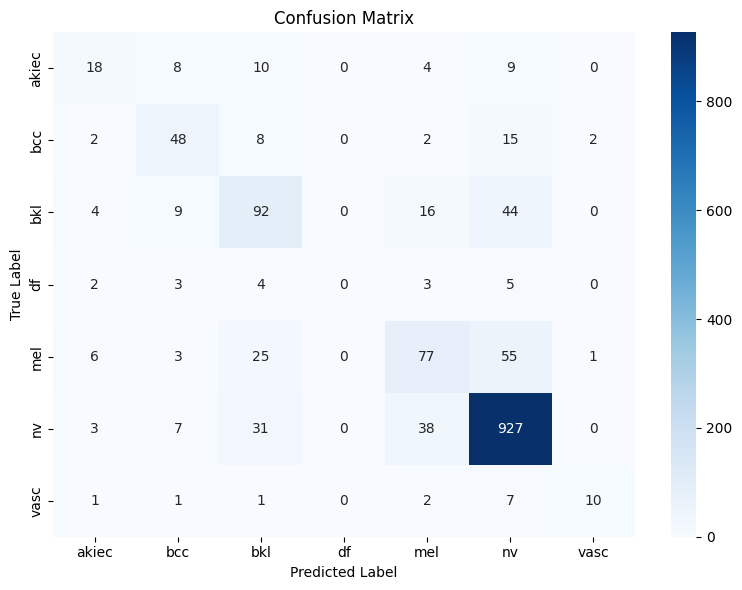

Confusion matrix saved to 'confusion_matrix.png'.


In [15]:
all_preds = []
all_labels = []
all_probs = []

cnn_model.eval()
with torch.no_grad():
    for images, labels in tqdm(test_loader, desc="Testing"):
        images, labels = images.to(device), labels.to(device)
        outputs = cnn_model(images)
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())

# Convert to NumPy arrays
all_preds = np.array(all_preds)
all_labels = np.array(all_labels)
all_probs = np.array(all_probs)

# Accuracy, F1 score
acc = accuracy_score(all_labels, all_preds)
f1 = f1_score(all_labels, all_preds, average="weighted")

# ROC AUC (one-vs-rest)
try:
    auc_score = roc_auc_score(all_labels, all_probs, multi_class="ovr")
except:
    auc_score = "N/A (AUC needs >1 class in test set)"

# Print metrics
print("\nClassification Report:\n")
print(classification_report(all_labels, all_preds, target_names=class_names))
print(f"Test Accuracy: {acc:.4f}")
print(f"Weighted F1 Score: {f1:.4f}")
print(f"ROC AUC Score: {auc_score}")

# Confusion Matrix Plot
cm = confusion_matrix(all_labels, all_preds)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.tight_layout()
plt.savefig("/kaggle/working/confusion_matrix.png", dpi=300)
plt.show()

print("Confusion matrix saved to 'confusion_matrix.png'.")

### ROC‑AUC Curves

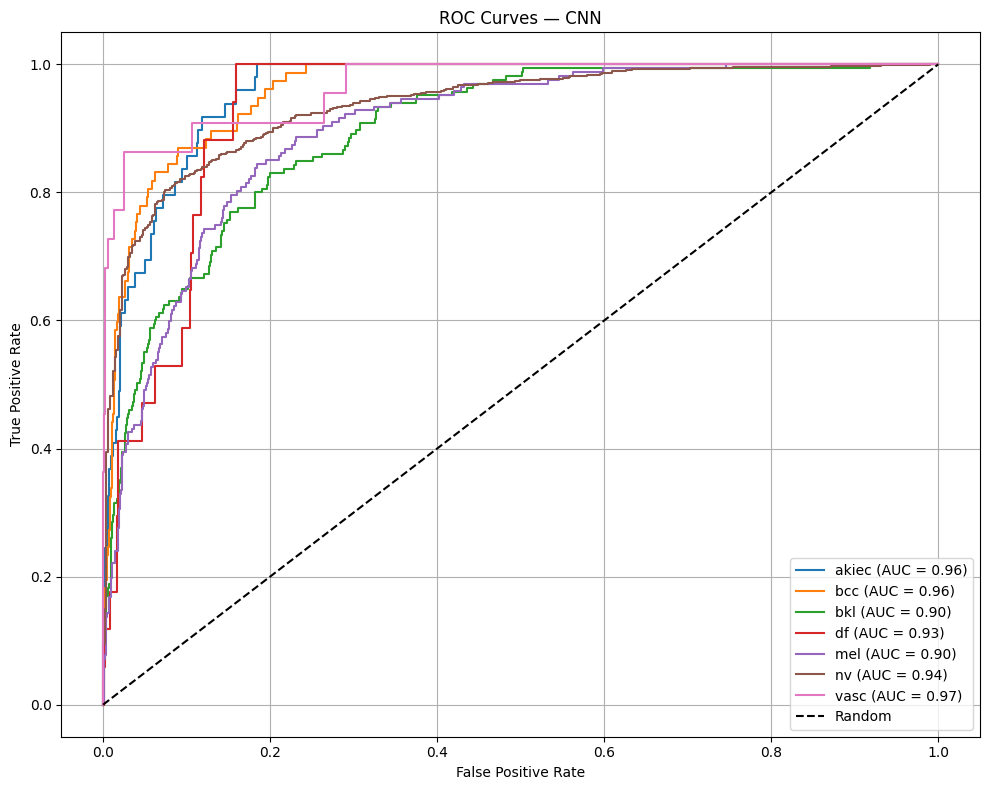

Macro AUC: 0.9353
Micro AUC: 0.9697


In [16]:
plot_multiclass_roc(
    all_labels=all_labels,
    all_probs=all_probs,
    class_names=class_names,
    title="ROC Curves — CNN",
    outfile="/kaggle/working/roc_curves_cnn.png"
)

### Grad-CAM Generation for Test Images — CNN (Plot + Save, with Fallback)

[Info] No correct predictions for classes: ['df']. Falling back to first available sample.


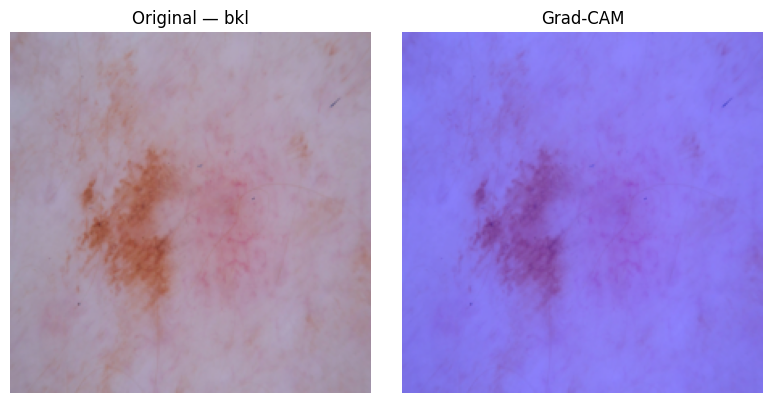

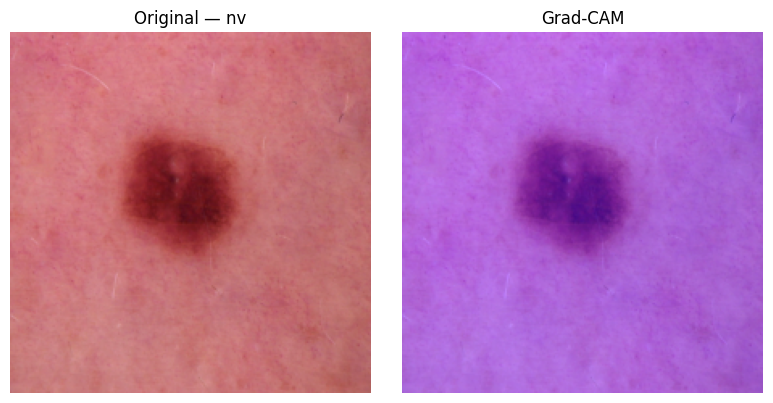

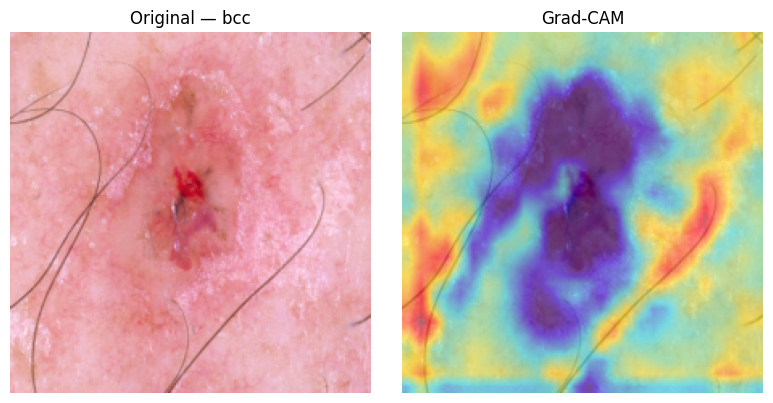

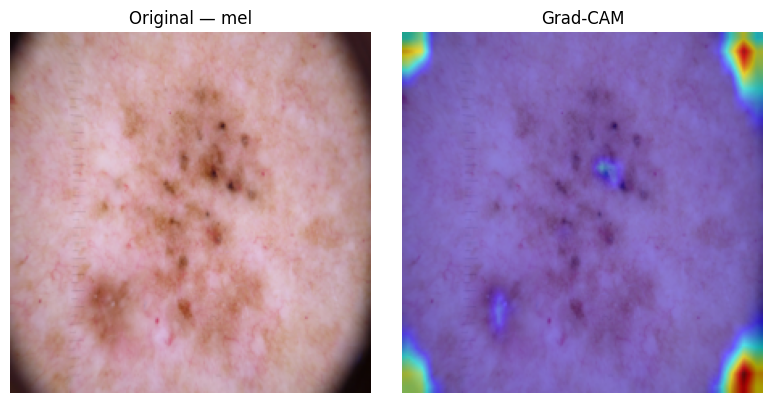

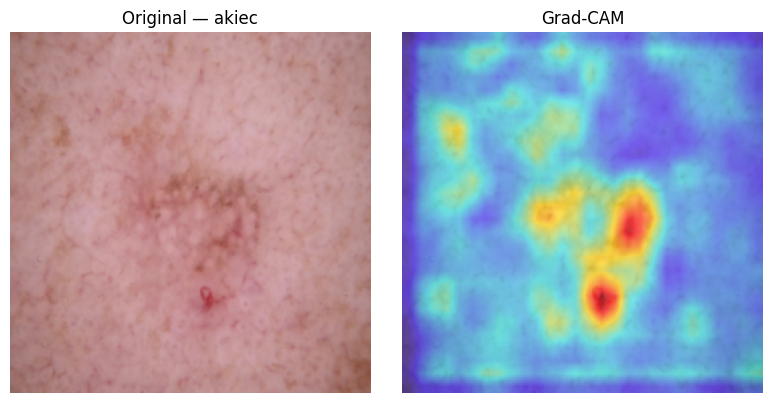

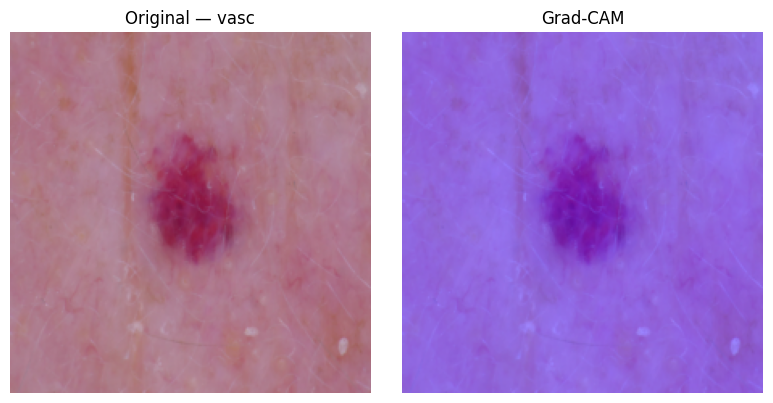

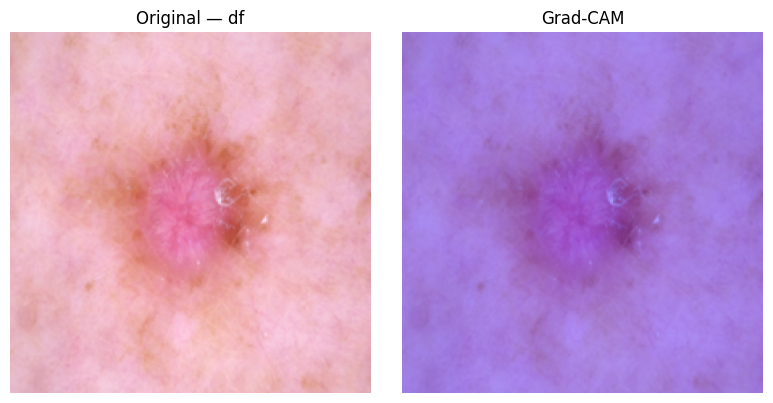

Saved CNN Grad‑CAM images to: /kaggle/working/gradcam_cnn_per_class


In [17]:
# Sanity checks
assert 'cnn_model' in globals(), "cnn_model not found. Reload the trained CNN first."
assert 'test_loader' in globals(), "test_loader not found."
assert 'class_names' in globals(), "class_names not found."
assert 'device' in globals(), "device not set."

# Helpers
def inv_norm_05(img_t):
    """Invert Normalize([0.5]*3,[0.5]*3) -> RGB [0,1]. img_t: CHW tensor."""
    x = img_t.detach().cpu().clone()
    for c in range(3):
        x[c] = x[c] * 0.5 + 0.5
    return x.clamp(0, 1).permute(1, 2, 0).numpy()

def find_last_conv_module(net: nn.Module):
    last = None
    for m in net.modules():
        if isinstance(m, nn.Conv2d):
            last = m
    if last is None:
        raise RuntimeError("No Conv2d layer found in the CNN.")
    return last

# Setup Grad‑CAM
cnn_model.eval()
target_layer = find_last_conv_module(cnn_model)
cam = PTGradCAM(model=cnn_model, target_layers=[target_layer])

got = {c: False for c in class_names}
cam_results = {}

# Pass 1: prefer correctly predicted examples
for images, labels in test_loader:
    images, labels = images.to(device), labels.to(device)
    with torch.no_grad():
        preds = cnn_model(images).argmax(1)

    for i in range(images.size(0)):
        t_lbl = labels[i].item()
        p_lbl = preds[i].item()
        cname = class_names[t_lbl]
        if got[cname] or p_lbl != t_lbl:
            continue

        it = images[i].unsqueeze(0).requires_grad_(True)
        cnn_model.zero_grad()
        gcam = cam(input_tensor=it, targets=[ClassifierOutputTarget(p_lbl)])[0]

        rgb01 = inv_norm_05(images[i])
        cam_img = show_cam_on_image(rgb01, gcam, use_rgb=True)

        cam_results[cname] = (rgb01, cam_img)  # store original (denorm) + overlay
        got[cname] = True

    if all(got.values()):
        break

# Pass 2: fallback for missing classes (use first available, even if misclassified)
if not all(got.values()):
    missing = [c for c, v in got.items() if not v]
    print(f"[Info] No correct predictions for classes: {missing}. Falling back to first available sample.")
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        for i in range(images.size(0)):
            t_lbl = labels[i].item()
            cname = class_names[t_lbl]
            if got[cname]:
                continue

            it = images[i].unsqueeze(0).requires_grad_(True)
            cnn_model.zero_grad()
            # drive CAM toward the true label for visualization
            gcam = cam(input_tensor=it, targets=[ClassifierOutputTarget(t_lbl)])[0]

            rgb01 = inv_norm_05(images[i])
            cam_img = show_cam_on_image(rgb01, gcam, use_rgb=True)

            cam_results[cname] = (rgb01, cam_img)
            got[cname] = True

        if all(got.values()):
            break

# Plot & save
out_dir = Path("/kaggle/working/gradcam_cnn_per_class")
out_dir.mkdir(parents=True, exist_ok=True)

if not cam_results:
    print("[Warning] No Grad‑CAM images generated for CNN. Check model/loader.")
else:
    for cname, (orig_rgb01, cam_img) in cam_results.items():
        plt.figure(figsize=(8, 4))
        plt.subplot(1, 2, 1); plt.imshow(orig_rgb01); plt.title(f"Original — {cname}"); plt.axis('off')
        plt.subplot(1, 2, 2); plt.imshow(cam_img);    plt.title("Grad‑CAM");          plt.axis('off')
        plt.tight_layout()
        save_path = out_dir / f"gradcam_{cname}.png"
        plt.savefig(save_path, dpi=300, bbox_inches="tight", pad_inches=0.05)
        plt.show()
    print(f"Saved CNN Grad‑CAM images to: {out_dir.resolve()}")

# Cleanup hooks
try:
    cam.activations_and_grads.release()
except Exception:
    pass
del cam

## ResNet-50

### Custom Dataset Loader

In [18]:
class SkinLesionDataset(Dataset):
    def __init__(self, df, img_dirs, transform=None):
        self.df = df.reset_index(drop=True)
        self.img_dirs = img_dirs
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        img_id = self.df.iloc[idx]['image_id']
        img_name = img_id + ".jpg"

        for img_dir in self.img_dirs:
            img_path = os.path.join(img_dir, img_name)
            if os.path.exists(img_path):
                image = Image.open(img_path).convert("RGB")
                break
        else:
            raise FileNotFoundError(f"{img_name} not found in {self.img_dirs}")

        # Ensure numeric label -> torch.long tensor
        label = int(self.df.iloc[idx]['label'])
        label = torch.tensor(label, dtype=torch.long)

        if self.transform:
            image = self.transform(image)

        return image, label

### Data Preparation

In [19]:
# Metadata
df = pd.read_csv("/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_metadata.csv")

# Label encoding
label_dict = {label: idx for idx, label in enumerate(df['dx'].unique())}
df['label'] = df['dx'].map(label_dict)
df['image_id'] = df['image_id'].astype(str)

# Train/Val/Test split
train_df, test_df = train_test_split(df, test_size=0.2, stratify=df['label'], random_state=42)
train_df, val_df = train_test_split(train_df, test_size=0.1, stratify=train_df['label'], random_state=42)

# Reset index to prevent DataLoader bugs
train_df = train_df.reset_index(drop=True)
val_df = val_df.reset_index(drop=True)
test_df = test_df.reset_index(drop=True)

### Transforms

In [20]:
train_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(20),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])

test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])

### Dataset and DataLoader Setup

In [21]:
img_dirs = [
    "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_1",
    "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_2"
]

train_dataset = SkinLesionDataset(train_df, img_dirs, transform=train_transform)
val_dataset   = SkinLesionDataset(val_df, img_dirs, transform=test_transform)
test_dataset  = SkinLesionDataset(test_df, img_dirs, transform=test_transform)

### Handle Class Imbalance

In [22]:
class_counts = train_df['label'].value_counts().sort_index().values
weights = 1.0 / torch.tensor(class_counts, dtype=torch.float)
sample_weights = weights[train_df['label'].values]
sampler = WeightedRandomSampler(sample_weights, num_samples=len(sample_weights), replacement=True)

### DataLoader Setup

In [23]:
train_loader = DataLoader(train_dataset, batch_size=32, sampler=sampler, num_workers=2)
val_loader   = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=2)
test_loader  = DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=2)

### Define ResNet50 Architecture

In [24]:
# Define ResNet50 model
def get_resnet50_model(num_classes=7):
    model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)  # load pretrained ResNet50
    for param in model.parameters():
        param.requires_grad = False  # freeze all layers

    # Replace the fully connected layer
    num_ftrs = model.fc.in_features
    model.fc = nn.Linear(num_ftrs, num_classes)
    return model

### Prepare Model, Loss, Optimizer

In [25]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

resnet_model = get_resnet50_model(num_classes=7)
resnet_model = resnet_model.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(resnet_model.fc.parameters(), lr=1e-4)

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 194MB/s]


### Define Training Function (with Early Stopping)

In [26]:
def train_model_resnet50(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=50, patience=5):
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    epochs_no_improve = 0

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")
        print("-" * 50)

        # Training
        model.train()
        running_loss, correct_train, total_train = 0.0, 0, 0
        for images, labels in tqdm(train_loader, desc="Training", leave=False):
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss  += loss.item() * images.size(0)
            correct_train += (outputs.argmax(1) == labels).sum().item()
            total_train   += labels.size(0)

        train_loss = running_loss / total_train
        train_acc  = correct_train / total_train

        # Validation
        model.eval()
        val_running, correct_val, total_val = 0.0, 0, 0
        with torch.no_grad():
            for images, labels in tqdm(val_loader, desc="Validation", leave=False):
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss    = criterion(outputs, labels)

                val_running += loss.item() * images.size(0)
                correct_val += (outputs.argmax(1) == labels).sum().item()
                total_val   += labels.size(0)

        val_loss = val_running / total_val
        val_acc  = correct_val / total_val

        print(f"Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.4f}")
        print(f"Val   Loss: {val_loss:.4f} | Val   Acc: {val_acc:.4f}")

        # Early stopping logic
        if val_acc > best_acc:
            best_acc = val_acc
            best_model_wts = copy.deepcopy(model.state_dict())
            print("Best ResNet50 model updated.")
            epochs_no_improve = 0
        else:
            epochs_no_improve += 1
            if epochs_no_improve >= patience:
                print("Early stopping triggered.")
                break

    return model, best_model_wts

### Train the Model

In [28]:
resnet_model, best_model_wts = train_model_resnet50(
    model=resnet_model,
    train_loader=train_loader,
    val_loader=val_loader,
    criterion=criterion,
    optimizer=optimizer,
    device=device,
    num_epochs=50,
    patience=5
)

# Save best model weights right after training finishes
resnet_model.load_state_dict(best_model_wts)
torch.save(resnet_model.state_dict(), "/kaggle/working/resnet50_ham10000.pth")
print("ResNet50 model saved to /kaggle/working/resnet50_ham10000.pth")


Epoch 1/50
--------------------------------------------------


Train Loss: 1.8036 | Train Acc: 0.3750
Val   Loss: 1.6589 | Val   Acc: 0.5461
Best ResNet50 model updated.

Epoch 2/50
--------------------------------------------------


Train Loss: 1.5838 | Train Acc: 0.5240
Val   Loss: 1.5126 | Val   Acc: 0.5673
Best ResNet50 model updated.

Epoch 3/50
--------------------------------------------------


Train Loss: 1.4552 | Train Acc: 0.5710
Val   Loss: 1.4174 | Val   Acc: 0.5399

Epoch 4/50
--------------------------------------------------


Train Loss: 1.3658 | Train Acc: 0.5810
Val   Loss: 1.3232 | Val   Acc: 0.5998
Best ResNet50 model updated.

Epoch 5/50
--------------------------------------------------


Train Loss: 1.2971 | Train Acc: 0.5882
Val   Loss: 1.2552 | Val   Acc: 0.5960

Epoch 6/50
--------------------------------------------------


Train Loss: 1.2592 | Train Acc: 0.6006
Val   Loss: 1.2168 | Val   Acc: 0.6035
Best ResNet50 model updated.

Epoch 7/50
--------------------------------------------------


Train Loss: 1.2006 | Train Acc: 0.6148
Val   Loss: 1.1981 | Val   Acc: 0.5973

Epoch 8/50
--------------------------------------------------


Train Loss: 1.1678 | Train Acc: 0.6222
Val   Loss: 1.1314 | Val   Acc: 0.6097
Best ResNet50 model updated.

Epoch 9/50
--------------------------------------------------


Train Loss: 1.1385 | Train Acc: 0.6351
Val   Loss: 1.0950 | Val   Acc: 0.6309
Best ResNet50 model updated.

Epoch 10/50
--------------------------------------------------


Train Loss: 1.1122 | Train Acc: 0.6307
Val   Loss: 1.0540 | Val   Acc: 0.6334
Best ResNet50 model updated.

Epoch 11/50
--------------------------------------------------


Train Loss: 1.0882 | Train Acc: 0.6398
Val   Loss: 1.0895 | Val   Acc: 0.6172

Epoch 12/50
--------------------------------------------------


Train Loss: 1.0759 | Train Acc: 0.6441
Val   Loss: 1.0875 | Val   Acc: 0.6097

Epoch 13/50
--------------------------------------------------


Train Loss: 1.0232 | Train Acc: 0.6675
Val   Loss: 1.0112 | Val   Acc: 0.6484
Best ResNet50 model updated.

Epoch 14/50
--------------------------------------------------


Train Loss: 1.0218 | Train Acc: 0.6657
Val   Loss: 1.0338 | Val   Acc: 0.6284

Epoch 15/50
--------------------------------------------------


Train Loss: 1.0054 | Train Acc: 0.6612
Val   Loss: 1.0083 | Val   Acc: 0.6446

Epoch 16/50
--------------------------------------------------


Train Loss: 0.9785 | Train Acc: 0.6838
Val   Loss: 1.0218 | Val   Acc: 0.6284

Epoch 17/50
--------------------------------------------------


Train Loss: 0.9833 | Train Acc: 0.6761
Val   Loss: 0.9618 | Val   Acc: 0.6521
Best ResNet50 model updated.

Epoch 18/50
--------------------------------------------------


Train Loss: 0.9529 | Train Acc: 0.6922
Val   Loss: 0.9508 | Val   Acc: 0.6596
Best ResNet50 model updated.

Epoch 19/50
--------------------------------------------------


Train Loss: 0.9296 | Train Acc: 0.6981
Val   Loss: 1.0080 | Val   Acc: 0.6359

Epoch 20/50
--------------------------------------------------


Train Loss: 0.9292 | Train Acc: 0.6936
Val   Loss: 0.9630 | Val   Acc: 0.6471

Epoch 21/50
--------------------------------------------------


Train Loss: 0.9197 | Train Acc: 0.6981
Val   Loss: 0.9796 | Val   Acc: 0.6297

Epoch 22/50
--------------------------------------------------


Train Loss: 0.9043 | Train Acc: 0.7061
Val   Loss: 0.8849 | Val   Acc: 0.6783
Best ResNet50 model updated.

Epoch 23/50
--------------------------------------------------


Train Loss: 0.9159 | Train Acc: 0.6931
Val   Loss: 0.9715 | Val   Acc: 0.6384

Epoch 24/50
--------------------------------------------------


Train Loss: 0.9104 | Train Acc: 0.6939
Val   Loss: 0.9323 | Val   Acc: 0.6571

Epoch 25/50
--------------------------------------------------


Train Loss: 0.8806 | Train Acc: 0.7019
Val   Loss: 0.9192 | Val   Acc: 0.6596

Epoch 26/50
--------------------------------------------------


Train Loss: 0.8672 | Train Acc: 0.7173
Val   Loss: 0.9023 | Val   Acc: 0.6658

Epoch 27/50
--------------------------------------------------


Train Loss: 0.8664 | Train Acc: 0.7105
Val   Loss: 0.9092 | Val   Acc: 0.6696
Early stopping triggered.
ResNet50 model saved to /kaggle/working/resnet50_ham10000.pth


### Reload the Model

In [27]:
resnet_model = get_resnet50_model(num_classes=7)  # same function used earlier
resnet_model.load_state_dict(
    torch.load("/kaggle/input/resnet50-ham10000-model-weights/resnet50_ham10000.pth", map_location=device)
)
resnet_model = resnet_model.to(device)
resnet_model.eval()

print("ResNet-50 model reloaded from /kaggle/working/resnet50_ham10000.pth")

ResNet-50 model reloaded from /kaggle/working/resnet50_ham10000.pth


### Evaluate on Test Set — Metrics & Confusion Matrix

Testing: 100%|██████████| 63/63 [00:16<00:00,  3.76it/s]



Classification Report:

              precision    recall  f1-score   support

       akiec       0.52      0.58      0.55       220
         bcc       0.95      0.71      0.81      1341
         bkl       0.25      0.61      0.35        23
          df       0.37      0.57      0.45       223
         mel       0.29      0.82      0.43        28
          nv       0.43      0.62      0.51       103
        vasc       0.33      0.60      0.42        65

    accuracy                           0.67      2003
   macro avg       0.45      0.65      0.50      2003
weighted avg       0.77      0.67      0.70      2003

Test Accuracy: 0.6745
Weighted F1 Score: 0.7047
ROC AUC Score: 0.9187471850112114


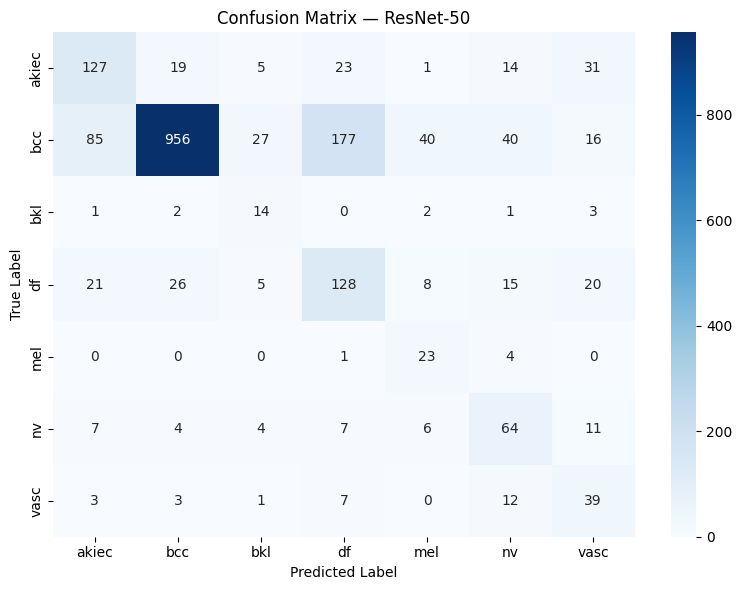

Confusion matrix saved to 'confusion_matrix_resnet50.png'.


In [28]:
resnet_model.eval()

all_preds = []
all_labels = []
all_probs = []

with torch.no_grad():
    for images, labels in tqdm(test_loader, desc="Testing"):
        images, labels = images.to(device), labels.to(device)
        outputs = resnet_model(images)
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())

# Convert to NumPy arrays
all_preds = np.array(all_preds)
all_labels = np.array(all_labels)
all_probs = np.array(all_probs)

# Metrics
acc = accuracy_score(all_labels, all_preds)
f1 = f1_score(all_labels, all_preds, average="weighted")

# ROC AUC (one-vs-rest)
try:
    auc_score = roc_auc_score(all_labels, all_probs, multi_class="ovr")
except ValueError:
    auc_score = "N/A (AUC needs >1 class in test set)"

# Report
print("\nClassification Report:\n")
print(classification_report(all_labels, all_preds, target_names=class_names))
print(f"Test Accuracy: {acc:.4f}")
print(f"Weighted F1 Score: {f1:.4f}")
print(f"ROC AUC Score: {auc_score}")

# Confusion Matrix
cm = confusion_matrix(all_labels, all_preds)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix — ResNet-50")
plt.tight_layout()
plt.savefig("/kaggle/working/confusion_matrix_resnet50.png", dpi=300)
plt.show()

print("Confusion matrix saved to 'confusion_matrix_resnet50.png'.")

### ROC‑AUC Curves

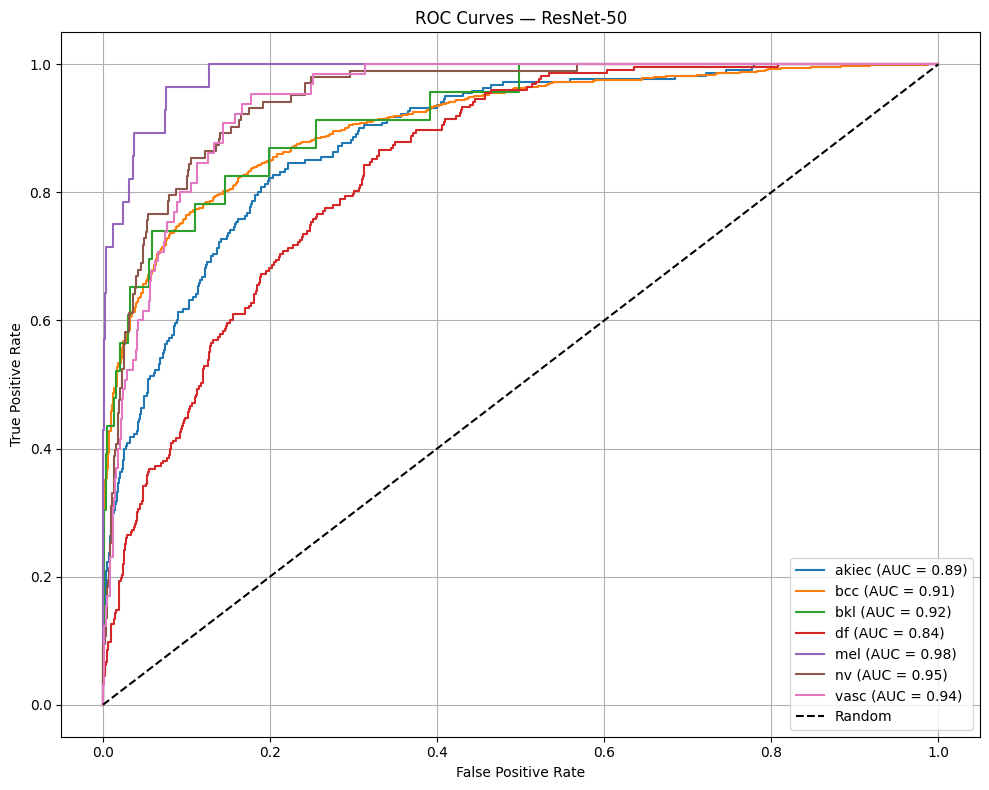

Macro AUC: 0.9187
Micro AUC: 0.9319


In [29]:
plot_multiclass_roc(
    all_labels=all_labels,
    all_probs=all_probs,
    class_names=class_names,
    title="ROC Curves — ResNet-50",
    outfile="/kaggle/working/roc_curves_resnet50.png"
)

### Grad‑CAM Generation for Test Images — ResNet‑50 (Plot + Save, with Fallback)

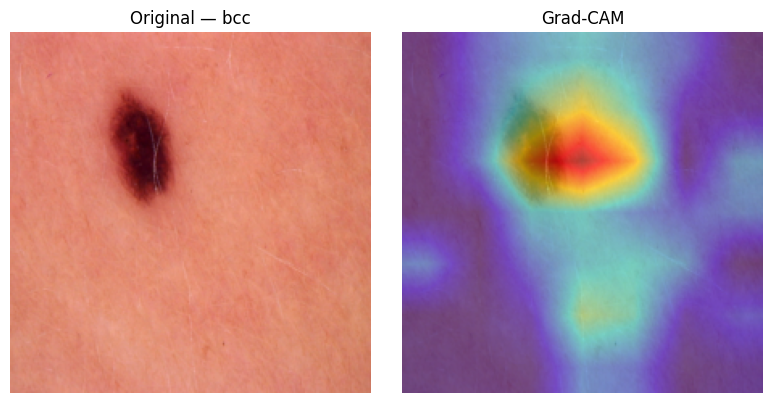

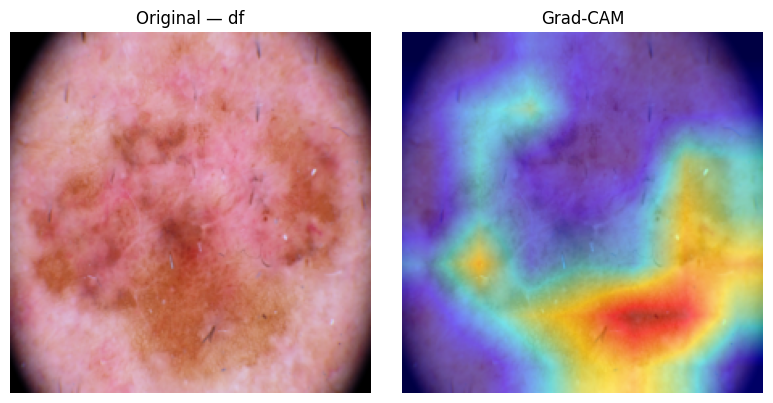

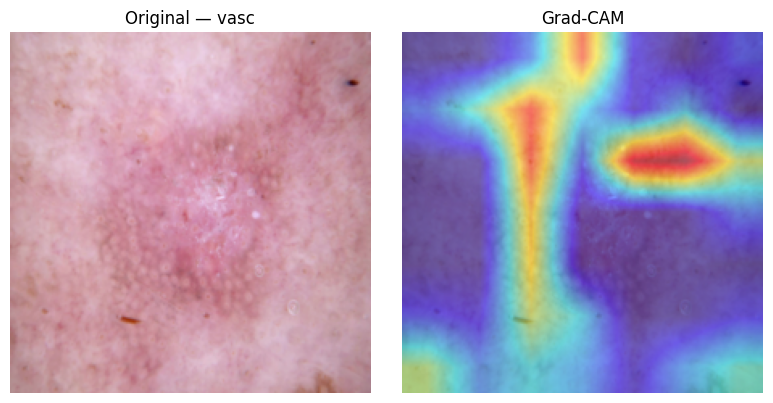

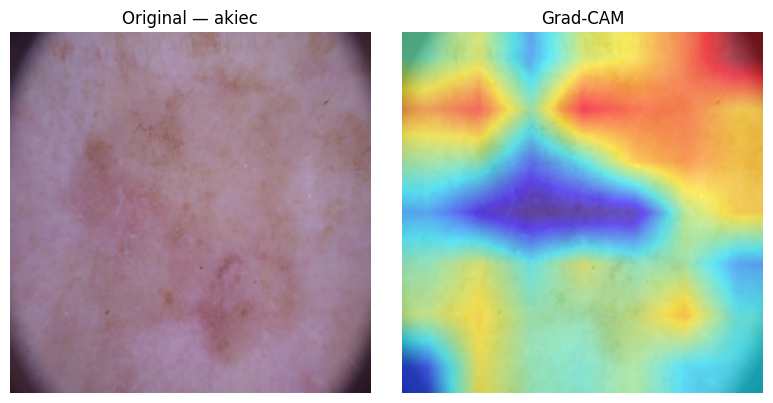

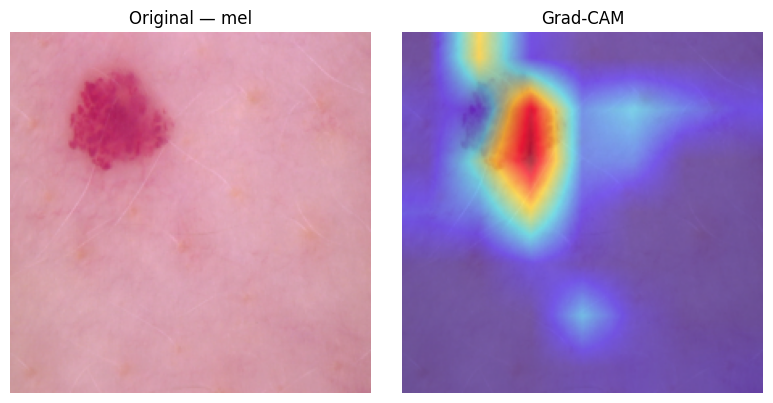

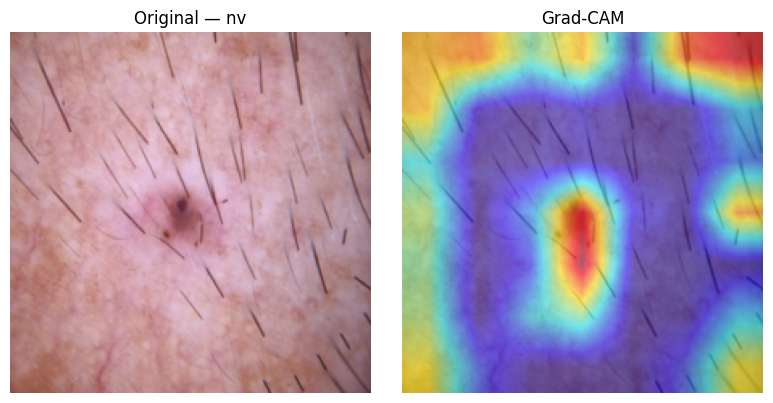

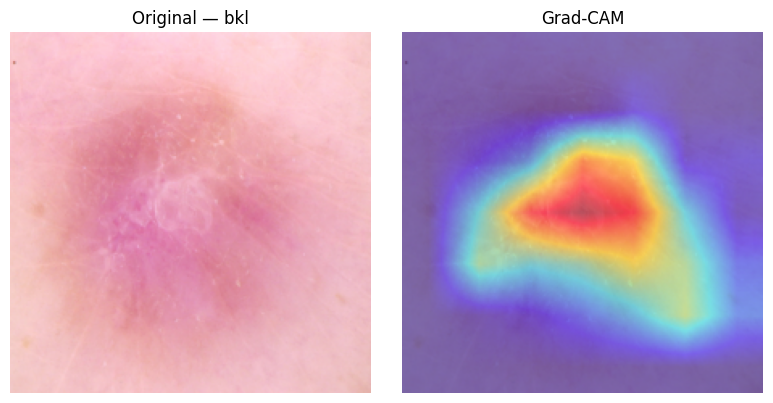

Saved ResNet‑50 Grad‑CAM images to: /kaggle/working/gradcam_resnet50_per_class


In [30]:
# Sanity checks
assert 'resnet_model' in globals(), "resnet_model not found. Reload/train it first."
assert 'test_loader'   in globals(), "test_loader not found."
assert 'class_names'   in globals(), "class_names not found."
assert 'device'        in globals(), "device not set (cuda/cpu)."

# Helpers (invert ImageNet normalization for correct colors)
IMAGENET_MEAN = [0.485, 0.456, 0.406]
IMAGENET_STD  = [0.229, 0.224, 0.225]

def inv_imagenet_norm(img_t):
    """Invert Normalize(IMAGENET_MEAN, IMAGENET_STD) -> RGB [0,1]. img_t: CHW tensor."""
    x = img_t.detach().cpu().clone()
    for c, m, s in zip(range(3), IMAGENET_MEAN, IMAGENET_STD):
        x[c] = x[c] * s + m
    return x.clamp(0, 1).permute(1, 2, 0).numpy()

def find_last_conv_module(net: nn.Module):
    last = None
    for m in net.modules():
        if isinstance(m, nn.Conv2d):
            last = m
    if last is None:
        raise RuntimeError("No Conv2d layer found in the model.")
    return last

# Setup Grad‑CAM target layer (best for ResNet‑50: last bottleneck conv)
resnet_model.eval()
target_layer = getattr(resnet_model.layer4[-1], "conv3", None)
if target_layer is None:  # fallback in case of different variant
    target_layer = find_last_conv_module(resnet_model)

cam = PTGradCAM(model=resnet_model, target_layers=[target_layer])

# Collect one image per class (prefer correctly predicted), else fallback
got = {c: False for c in class_names}
cam_results = {}

# Pass 1 — prefer correct examples
for images, labels in test_loader:
    images, labels = images.to(device), labels.to(device)
    with torch.no_grad():
        preds = resnet_model(images).argmax(1)

    for i in range(images.size(0)):
        t_lbl = labels[i].item()
        p_lbl = preds[i].item()
        cname = class_names[t_lbl]
        if got[cname] or p_lbl != t_lbl:
            continue

        it = images[i].unsqueeze(0).requires_grad_(True)
        resnet_model.zero_grad()
        gcam = cam(input_tensor=it, targets=[ClassifierOutputTarget(p_lbl)])[0]

        rgb01 = inv_imagenet_norm(images[i])
        cam_img = show_cam_on_image(rgb01, gcam, use_rgb=True)

        cam_results[cname] = (rgb01, cam_img)
        got[cname] = True
    if all(got.values()):
        break

# Pass 2 — fallback: take first available even if misclassified
if not all(got.values()):
    missing = [c for c, v in got.items() if not v]
    print(f"[Info] No correct predictions for classes: {missing}. Falling back to first available sample.")
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        for i in range(images.size(0)):
            t_lbl = labels[i].item()
            cname = class_names[t_lbl]
            if got[cname]:
                continue

            it = images[i].unsqueeze(0).requires_grad_(True)
            resnet_model.zero_grad()
            # drive CAM toward the TRUE label for visualization
            gcam = cam(input_tensor=it, targets=[ClassifierOutputTarget(t_lbl)])[0]

            rgb01 = inv_imagenet_norm(images[i])
            cam_img = show_cam_on_image(rgb01, gcam, use_rgb=True)

            cam_results[cname] = (rgb01, cam_img)
            got[cname] = True
        if all(got.values()):
            break

# Plot & save
out_dir = Path("/kaggle/working/gradcam_resnet50_per_class")
out_dir.mkdir(parents=True, exist_ok=True)

if not cam_results:
    print("[Warning] No Grad‑CAM images generated for ResNet‑50. Check model/loader.")
else:
    for cname, (orig_rgb01, cam_img) in cam_results.items():
        plt.figure(figsize=(8, 4))
        plt.subplot(1, 2, 1); plt.imshow(orig_rgb01); plt.title(f"Original — {cname}"); plt.axis('off')
        plt.subplot(1, 2, 2); plt.imshow(cam_img);   plt.title("Grad‑CAM");          plt.axis('off')
        plt.tight_layout()
        sp = out_dir / f"gradcam_{cname}.png"
        plt.savefig(sp, dpi=300, bbox_inches="tight", pad_inches=0.05)
        plt.show()
    print(f"Saved ResNet‑50 Grad‑CAM images to: {out_dir.resolve()}")

# Cleanup hooks
try:
    cam.activations_and_grads.release()
except Exception:
    pass
del cam

## Vision Transformer (ViT)

### Load ViT Processor

In [31]:
# Load image processor for ViT
processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224")

preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

### Define Custom Dataset Class

In [32]:
class HAM10000ViTDataset(Dataset):
    def __init__(self, dataframe, image_dirs, processor, transform=None):
        """
        Args:
            dataframe: Pandas DataFrame with columns ['image_id', 'label'].
            image_dirs: List of folders where HAM10000 images are stored.
            processor: HuggingFace ViTImageProcessor.
            transform: Optional torchvision transform (applied before processor).
        """
        self.df = dataframe
        self.image_dirs = image_dirs
        self.processor = processor
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        img_filename = row["image_id"] + ".jpg"

        # Find the image in one of the directories
        img_path = None
        for folder in self.image_dirs:
            candidate = os.path.join(folder, img_filename)
            if os.path.exists(candidate):
                img_path = candidate
                break

        if img_path is None:
            raise FileNotFoundError(f"Image {img_filename} not found in given folders.")

        # Load image
        image = Image.open(img_path).convert("RGB")

        # Optional torchvision transforms (e.g., augmentation)
        if self.transform:
            image = self.transform(image)

        # Processor: resize, normalize -> pixel_values
        encodings = self.processor(image, return_tensors="pt")

        return {
            "pixel_values": encodings["pixel_values"].squeeze(0),
            "labels": torch.tensor(row["label"], dtype=torch.long)
        }

### Create ViT-Compatible Datasets and Dataloaders

In [33]:
# Define where the image folders are
image_dirs = [
    "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_1",
    "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_2"
]

# Create datasets
train_dataset = HAM10000ViTDataset(train_df, image_dirs, processor)
val_dataset   = HAM10000ViTDataset(val_df,   image_dirs, processor)
test_dataset  = HAM10000ViTDataset(test_df,  image_dirs, processor)

# Create data loaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader   = DataLoader(val_dataset,   batch_size=16, shuffle=False)
test_loader  = DataLoader(test_dataset,  batch_size=16, shuffle=False)

### Define & Initialize ViT Model

In [34]:
vit_model = ViTForImageClassification.from_pretrained(
    "google/vit-base-patch16-224",
    num_labels=len(class_names),
    label2id={name: i for i, name in enumerate(class_names)},
    id2label={i: name for i, name in enumerate(class_names)},
    ignore_mismatched_sizes=True
).to(device)

# Load fine-tuned weights (use weights_only=True for speed & safety)
vit_model.load_state_dict(torch.load(
    "/kaggle/input/vit-ham10000-model-weights/vit_ham10000_best_model.pth",
    map_location=device,
    weights_only=True
))

vit_model.eval()
print("ViT model initialized and fine-tuned weights loaded successfully")

config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized because the shapes did not match:
- classifier.bias: found shape torch.Size([1000]) in the checkpoint and torch.Size([7]) in the model instantiated
- classifier.weight: found shape torch.Size([1000, 768]) in the checkpoint and torch.Size([7, 768]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


ViT model initialized and fine-tuned weights loaded successfully


### Train ViT — Early Stopping + Save Best

In [54]:
# ViT training (dict-based DataLoader: batch["pixel_values"], batch["labels"])
criterion   = nn.CrossEntropyLoss()
optimizer   = Adam(vit_model.parameters(), lr=2e-5)
num_epochs  = 50
patience    = 5

best_val_acc       = 0.0
epochs_no_improve  = 0
best_model_wts     = deepcopy(vit_model.state_dict())  # from copy import deepcopy
vit_model.to(device)

for epoch in range(num_epochs):
    print(f"\nEpoch {epoch+1}/{num_epochs}")
    print("-" * 30)

    # Train 
    vit_model.train()
    train_loss, train_correct, train_n = 0.0, 0, 0

    for batch in tqdm(train_loader, desc="Training", leave=False):
        inputs = batch["pixel_values"].to(device)
        labels = batch["labels"].to(device)

        optimizer.zero_grad()
        outputs = vit_model(inputs).logits
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        bs = labels.size(0)
        train_loss   += loss.item() * bs
        train_correct += (outputs.argmax(1) == labels).sum().item()
        train_n      += bs

    train_loss /= max(1, train_n)
    train_acc   = train_correct / max(1, train_n)

    # Validate 
    vit_model.eval()
    val_loss, val_correct, val_n = 0.0, 0, 0

    with torch.no_grad():
        for batch in tqdm(val_loader, desc="Validating", leave=False):
            inputs = batch["pixel_values"].to(device)
            labels = batch["labels"].to(device)

            outputs = vit_model(inputs).logits
            loss    = criterion(outputs, labels)

            bs = labels.size(0)
            val_loss   += loss.item() * bs
            val_correct += (outputs.argmax(1) == labels).sum().item()
            val_n      += bs

    val_loss /= max(1, val_n)
    val_acc   = val_correct / max(1, val_n)

    print(f"Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.4f}")
    print(f"Val   Loss: {val_loss:.4f} | Val   Acc: {val_acc:.4f}")

    # Early stopping on Val Acc 
    if val_acc > best_val_acc:
        best_val_acc      = val_acc
        best_model_wts    = deepcopy(vit_model.state_dict())
        epochs_no_improve = 0
        print("Best ViT weights updated.")
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            print(f"\nEarly stopping at epoch {epoch+1}")
            break

# Restore best and save 
vit_model.load_state_dict(best_model_wts)
out_path = "/kaggle/working/vit_ham10000_best_model.pth"
torch.save(vit_model.state_dict(), out_path)
print(f"Saved: {out_path} | Best Val Acc: {best_val_acc:.4f}")


Epoch 1/50
------------------------------


Train Loss: 0.0278 | Train Acc: 0.9922
Val   Loss: 0.4688 | Val   Acc: 0.8741
Best ViT weights updated.

Epoch 2/50
------------------------------


Train Loss: 0.0228 | Train Acc: 0.9933
Val   Loss: 0.4531 | Val   Acc: 0.8753
Best ViT weights updated.

Epoch 3/50
------------------------------


Train Loss: 0.0128 | Train Acc: 0.9961
Val   Loss: 0.4855 | Val   Acc: 0.8653

Epoch 4/50
------------------------------


Train Loss: 0.0216 | Train Acc: 0.9925
Val   Loss: 0.4578 | Val   Acc: 0.8703

Epoch 5/50
------------------------------


Train Loss: 0.0152 | Train Acc: 0.9951
Val   Loss: 0.5117 | Val   Acc: 0.8728

Epoch 6/50
------------------------------


Train Loss: 0.0070 | Train Acc: 0.9979
Val   Loss: 0.5175 | Val   Acc: 0.8853
Best ViT weights updated.

Epoch 7/50
------------------------------


Train Loss: 0.0007 | Train Acc: 1.0000
Val   Loss: 0.5477 | Val   Acc: 0.8766

Epoch 8/50
------------------------------


Train Loss: 0.0004 | Train Acc: 1.0000
Val   Loss: 0.5154 | Val   Acc: 0.8840

Epoch 9/50
------------------------------


Train Loss: 0.0002 | Train Acc: 1.0000
Val   Loss: 0.5288 | Val   Acc: 0.8853

Epoch 10/50
------------------------------


Train Loss: 0.0002 | Train Acc: 1.0000
Val   Loss: 0.5409 | Val   Acc: 0.8853

Epoch 11/50
------------------------------


Train Loss: 0.0002 | Train Acc: 1.0000
Val   Loss: 0.5509 | Val   Acc: 0.8853

Early stopping at epoch 11
Saved: /kaggle/working/vit_ham10000_best_model.pth | Best Val Acc: 0.8853


### Save Fine-tuned ViT Model & Processor in Hugging Face Format (with Reload Test)

In [36]:
# Ensure the model has the best weights loaded
vit_model.load_state_dict(
    torch.load("/kaggle/input/vit-ham10000-model-weights/vit_ham10000_best_model.pth", map_location="cpu")
)
vit_model.eval()

# Save both model and processor in Hugging Face format
save_dir = "/kaggle/working/vit_ham10000_finetuned"
vit_model.save_pretrained(save_dir)
processor.save_pretrained(save_dir)

print(f"ViT model and processor saved to {save_dir}")

# Example: reload later
vit_model = ViTForImageClassification.from_pretrained(save_dir).to(device)
processor = ViTImageProcessor.from_pretrained(save_dir)
vit_model.eval()

print("Reloaded ViT model and processor successfully.")

ViT model and processor saved to /kaggle/working/vit_ham10000_finetuned
Reloaded ViT model and processor successfully.


### Load Fine-tuned ViT and Evaluate on Test Set

Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized because the shapes did not match:
- classifier.bias: found shape torch.Size([1000]) in the checkpoint and torch.Size([7]) in the model instantiated
- classifier.weight: found shape torch.Size([1000, 768]) in the checkpoint and torch.Size([7, 768]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.



Classification Report:

              precision    recall  f1-score   support

       akiec       0.74      0.74      0.74       220
         bcc       0.91      0.97      0.94      1341
         bkl       0.86      0.52      0.65        23
          df       0.81      0.66      0.73       223
         mel       0.95      0.75      0.84        28
          nv       0.82      0.76      0.79       103
        vasc       0.83      0.37      0.51        65

    accuracy                           0.87      2003
   macro avg       0.85      0.68      0.74      2003
weighted avg       0.87      0.87      0.87      2003

Test Accuracy: 0.8747
Weighted F1 Score: 0.8676
ROC AUC Score: 0.9757847285925182


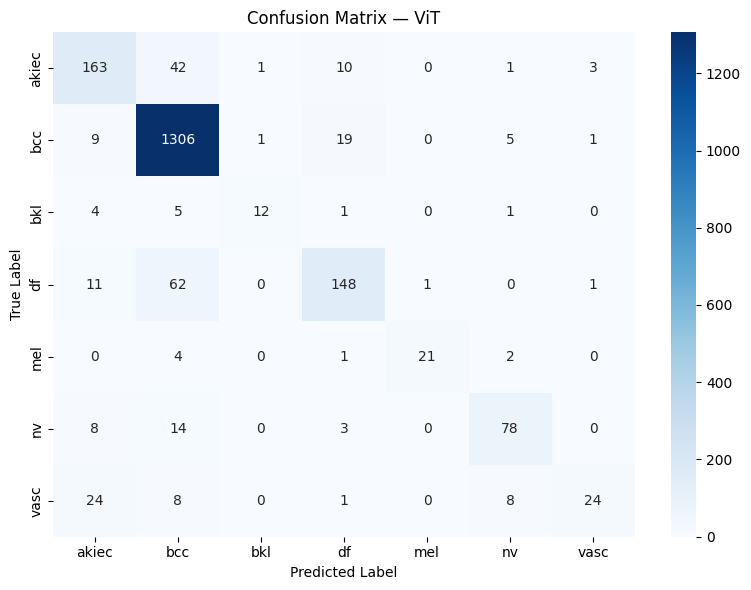

In [38]:
# Reload processor
processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224")

# Recreate architecture with correct num_labels
vit_model = ViTForImageClassification.from_pretrained(
    "google/vit-base-patch16-224",
    num_labels=len(class_names),
    ignore_mismatched_sizes=True
).to(device)

# Load fine-tuned weights
vit_model.load_state_dict(torch.load("/kaggle/input/vit-ham10000-model-weights/vit_ham10000_best_model.pth", map_location=device))
vit_model.eval()

# Evaluation
all_preds, all_labels, all_probs = [], [], []
with torch.no_grad():
    for batch in test_loader:
        pixel_values = batch["pixel_values"].to(device)
        labels = batch["labels"].to(device)

        logits = vit_model(pixel_values).logits
        probs = torch.softmax(logits, dim=1)
        preds = probs.argmax(1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())

# Metrics
all_preds = np.array(all_preds)
all_labels = np.array(all_labels)
all_probs = np.array(all_probs)

acc = accuracy_score(all_labels, all_preds)
f1 = f1_score(all_labels, all_preds, average="weighted")
try:
    auc_score = roc_auc_score(all_labels, all_probs, multi_class="ovr")
except ValueError:
    auc_score = "N/A (AUC needs >1 class in test set)"

print("\nClassification Report:\n")
print(classification_report(all_labels, all_preds, target_names=class_names))
print(f"Test Accuracy: {acc:.4f}")
print(f"Weighted F1 Score: {f1:.4f}")
print(f"ROC AUC Score: {auc_score}")

# Confusion matrix
cm = confusion_matrix(all_labels, all_preds)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix — ViT")
plt.tight_layout()
plt.savefig("/kaggle/working/confusion_matrix_vit.png", dpi=300)
plt.show()

### ViT Grad-CAM Wrapper & Reshape Transform

In [39]:
class ViTWrapper(nn.Module):
    def __init__(self, model):
        super().__init__()
        self.model = model
        self.model.eval()
    def forward(self, x):
        return self.model(x).logits

def vit_reshape_transform(tensor, height=14, width=14):
    # remove class token, then B x (H*W) x C -> B x C x H x W
    tensor = tensor[:, 1:, :]
    return tensor.reshape(tensor.size(0), height, width, -1).permute(0, 3, 1, 2)

### ROC‑AUC Curves - ViT

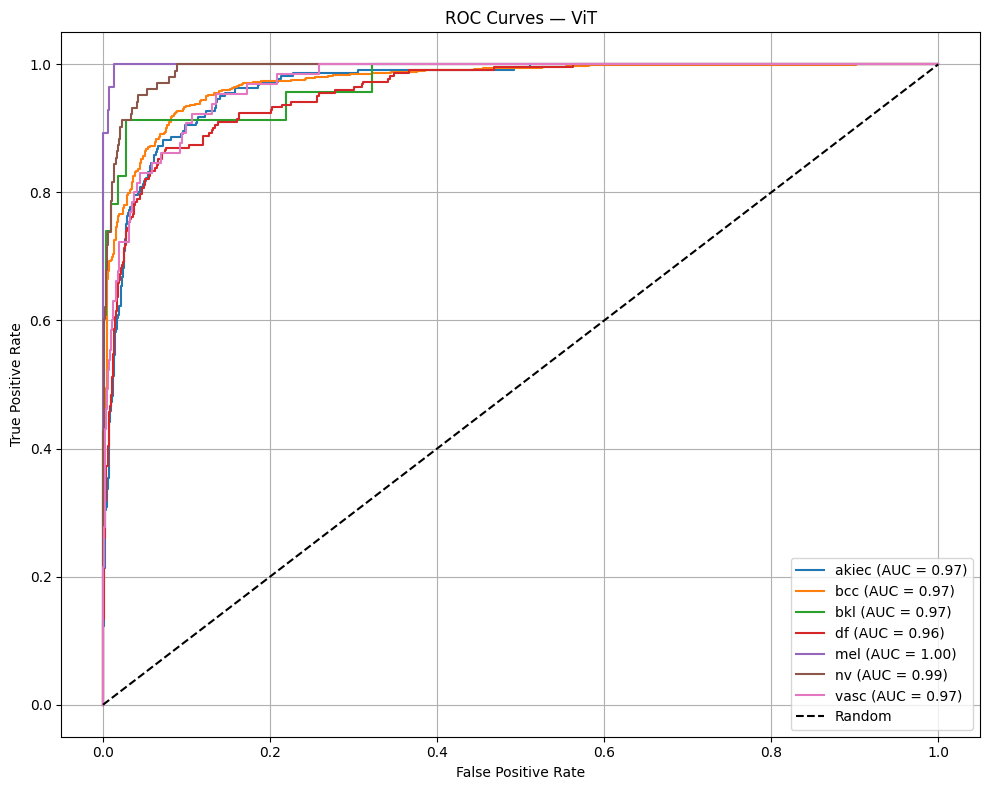

Macro AUC: 0.9758
Micro AUC: 0.9879


In [40]:
plot_multiclass_roc(
    all_labels=np.array(all_labels),
    all_probs=np.array(all_probs),
    class_names=class_names,
    title="ROC Curves — ViT",
    outfile="/kaggle/working/roc_curves_vit.png"
)

### Grad‑CAM Generation for Test Images — ViT (Plot + Save, with Fallback)

ViT Grad-CAM (correct pass):   4%|▍         | 76/2003 [00:00<00:17, 109.09it/s]


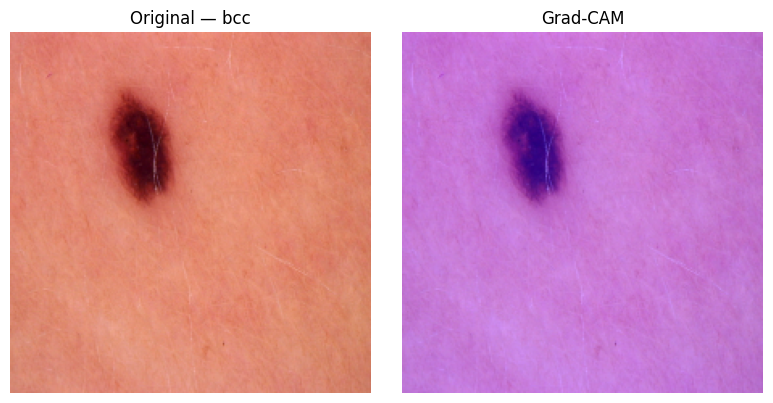

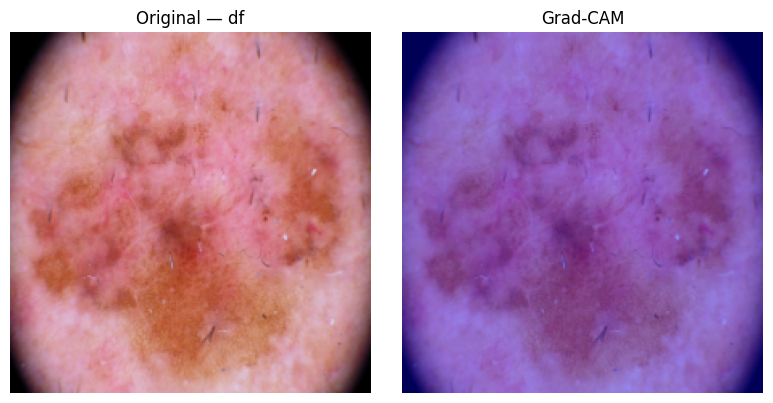

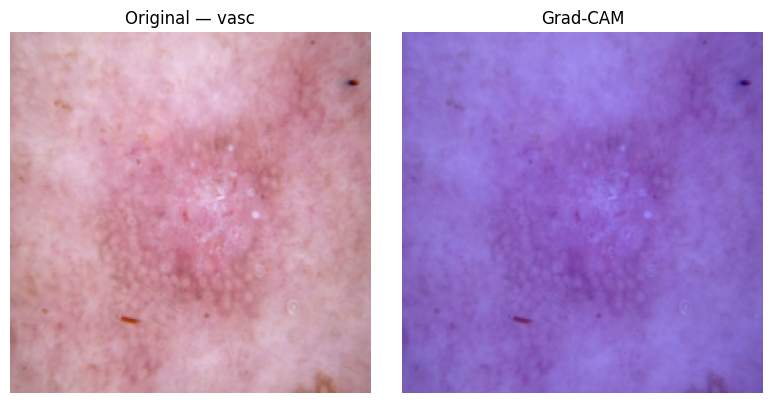

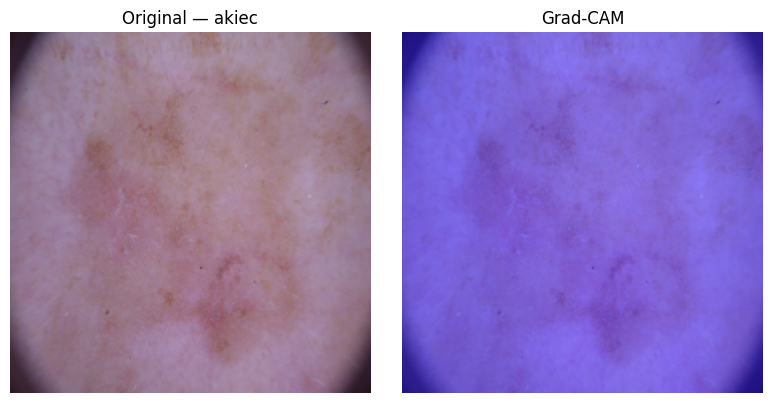

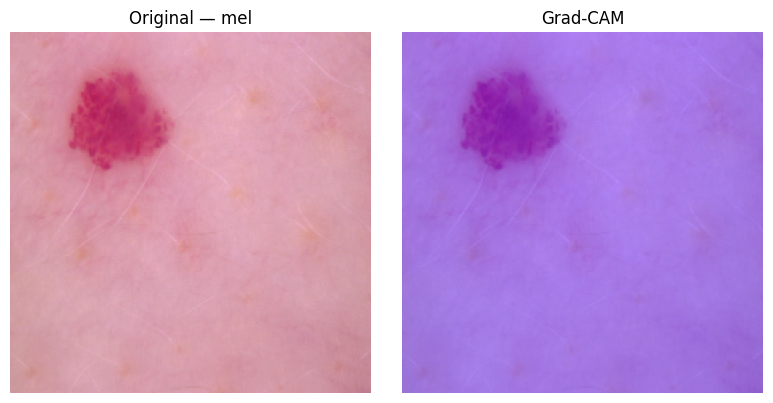

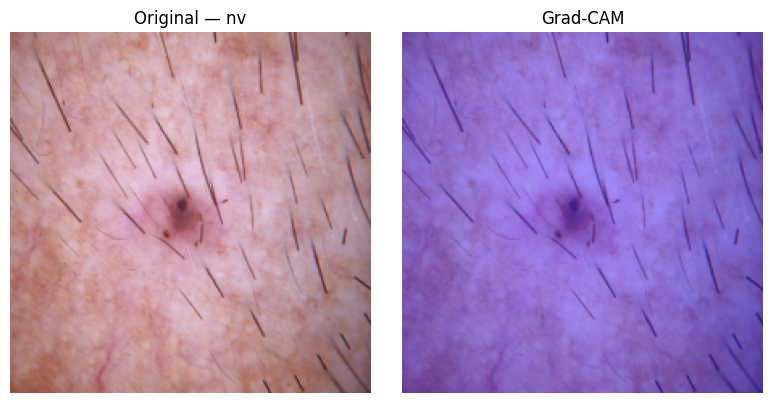

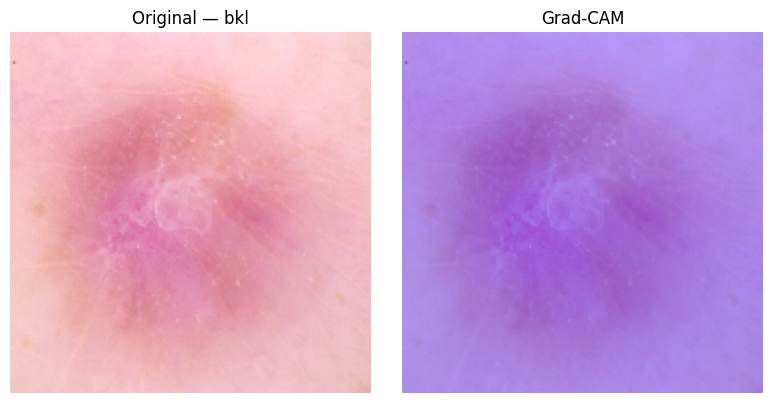

Saved ViT Grad-CAM images to: /kaggle/working/gradcam_vit_per_class


In [41]:
# Sanity checks / required objects
assert 'vit_model'   in globals(), "vit_model not found. Train or reload ViT first."
assert 'test_df'     in globals(), "test_df not found. Create your splits first."
assert 'class_names' in globals(), "class_names not found. Define from label_map."
assert 'device'      in globals(), "device not set (cuda/cpu)."

# Use the same processor used during training
vit_processor = globals().get('vit_processor', None)
if vit_processor is None:
    from transformers import ViTImageProcessor
    vit_processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224")

# Minimal wrappers
if 'ViTWrapper' not in globals():
    class ViTWrapper(nn.Module):
        def __init__(self, model):
            super().__init__()
            self.model = model
            self.model.eval()
        def forward(self, x):
            return self.model(x).logits

if 'vit_reshape_transform' not in globals():
    def vit_reshape_transform(tensor, height=14, width=14):
        tensor = tensor[:, 1:, :]
        return tensor.reshape(tensor.size(0), height, width, -1).permute(0, 3, 1, 2)

# Helpers
def _load_rgb01(path):
    return np.asarray(Image.open(path).convert("RGB")).astype(np.float32) / 255.0

def _row_to_path(row):
    image_id = row["image_id"]
    for d in image_dirs:
        candidate = os.path.join(d, image_id + ".jpg")
        if os.path.exists(candidate):
            return candidate
    return None  # Not found in any directory

# Prepare model + target layer
vit_model.eval()
wrapped_vit = ViTWrapper(vit_model)
try:
    target_layers = [vit_model.vit.encoder.layer[-1].output]
except:
    target_layers = [list(vit_model.vit.encoder.layer)[-1].output]

got = {c: False for c in class_names}
cam_results = {}

# Pass 1 — prefer correct predictions
with GradCAM(model=wrapped_vit, target_layers=target_layers, reshape_transform=vit_reshape_transform) as cam:
    for _, row in tqdm(test_df.iterrows(), total=len(test_df), desc="ViT Grad-CAM (correct pass)"):
        lbl = int(row["label"])
        cname = class_names[lbl]
        if got[cname]:
            continue

        p = _row_to_path(row)
        if p is None or not os.path.exists(p):
            continue

        pil_img = Image.open(p).convert("RGB")
        enc = vit_processor(images=pil_img, return_tensors="pt")
        x = enc["pixel_values"].to(device)

        with torch.no_grad():
            pred = vit_model(x).logits.argmax(1).item()
        if pred != lbl:
            continue

        rgb01 = _load_rgb01(p)
        grayscale_cam = cam(input_tensor=x, targets=[ClassifierOutputTarget(lbl)])[0]

        # Resize original to Grad-CAM mask size
        rgb01_resized = resize(rgb01, (grayscale_cam.shape[0], grayscale_cam.shape[1]), preserve_range=True)

        cam_img = show_cam_on_image(rgb01_resized.astype(np.float32), grayscale_cam, use_rgb=True)
        cam_results[cname] = (rgb01_resized, cam_img)
        got[cname] = True

        if all(got.values()):
            break

# Pass 2 — fallback if some classes missing
if not all(got.values()):
    missing = [c for c, v in got.items() if not v]
    print(f"[Info] No correct predictions for classes: {missing}. Falling back to first available sample.")
    with GradCAM(model=wrapped_vit, target_layers=target_layers, reshape_transform=vit_reshape_transform) as cam:
        for _, row in tqdm(test_df.iterrows(), total=len(test_df), desc="ViT Grad-CAM (fallback pass)"):
            lbl = int(row["label"])
            cname = class_names[lbl]
            if got[cname]:
                continue

            p = _row_to_path(row)
            if p is None or not os.path.exists(p):
                continue

            pil_img = Image.open(p).convert("RGB")
            enc = vit_processor(images=pil_img, return_tensors="pt")
            x = enc["pixel_values"].to(device)

            rgb01 = _load_rgb01(p)
            grayscale_cam = cam(input_tensor=x, targets=[ClassifierOutputTarget(lbl)])[0]

            rgb01_resized = resize(rgb01, (grayscale_cam.shape[0], grayscale_cam.shape[1]), preserve_range=True)

            cam_img = show_cam_on_image(rgb01_resized.astype(np.float32), grayscale_cam, use_rgb=True)
            cam_results[cname] = (rgb01_resized, cam_img)
            got[cname] = True

            if all(got.values()):
                break

# Plot & save
out_dir = Path("/kaggle/working/gradcam_vit_per_class")
out_dir.mkdir(parents=True, exist_ok=True)

if not cam_results:
    print("[Warning] No Grad-CAM images generated for ViT. Check model/paths.")
else:
    for cname, (orig_rgb01, cam_img) in cam_results.items():
        plt.figure(figsize=(8, 4))
        plt.subplot(1, 2, 1); plt.imshow(orig_rgb01);  plt.title(f"Original — {cname}"); plt.axis('off')
        plt.subplot(1, 2, 2); plt.imshow(cam_img);     plt.title("Grad-CAM");           plt.axis('off')
        plt.tight_layout()
        save_path = out_dir / f"gradcam_{cname}.png"
        plt.savefig(save_path, dpi=300, bbox_inches="tight", pad_inches=0.05)
        plt.show()
    print(f"Saved ViT Grad-CAM images to: {out_dir.resolve()}")

# Cleanup
try:
    cam.activations_and_grads.release()
except:
    pass
del cam

## DenseNet-121

### Load Metadata, Resolve Image Paths, and Prepare Train/Val/Test

In [42]:
# Load metadata (reuse global df that already exists)
df = pd.read_csv("/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_metadata.csv")

# We already created label_map/class_names globally, reuse them:
if 'label_map' not in globals():
    label_map = {name:i for i,name in enumerate(sorted(df['dx'].unique()))}
if 'class_names' not in globals():
    class_names = [k for k,_ in sorted(label_map.items(), key=lambda x:x[1])]

# Resolve image paths
image_dir_1 = "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_1/"
image_dir_2 = "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_2/"

def resolve_path(img_id):
    p1 = os.path.join(image_dir_1, f"{img_id}.jpg")
    p2 = os.path.join(image_dir_2, f"{img_id}.jpg")
    if os.path.exists(p1): return p1
    if os.path.exists(p2): return p2
    return None  # safer than assuming part_2 exists

df["path"] = df["image_id"].apply(resolve_path)
df = df.dropna(subset=["path"]).reset_index(drop=True)

# Reuse the same mapping
df["label"] = df["dx"].map(label_map).astype(int)

# Split (80/16/20)
train_df, test_df = train_test_split(df, test_size=0.20, stratify=df["label"], random_state=42)
train_df, val_df  = train_test_split(train_df, test_size=0.20, stratify=train_df["label"], random_state=42)

### Transforms - DenseNet

In [43]:
train_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])

val_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])

### Custom Dataset Class for HAM10000 Skin Lesion Images

In [44]:
class SkinLesionDataset(Dataset):
    def __init__(self, dataframe, transform=None):
        self.dataframe = dataframe
        self.transform = transform

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        row = self.dataframe.iloc[idx]
        img = Image.open(row["path"]).convert("RGB")
        label = row["label"]

        if self.transform:
            img = self.transform(img)
        return img, label

### DataLoaders (DenseNet)

In [45]:
train_dataset = SkinLesionDataset(train_df, transform=train_transform)
val_dataset   = SkinLesionDataset(val_df,   transform=val_transform)
test_dataset  = SkinLesionDataset(test_df,  transform=val_transform)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True,  num_workers=2, pin_memory=True)
val_loader   = DataLoader(val_dataset,   batch_size=32, shuffle=False, num_workers=2, pin_memory=True)
test_loader  = DataLoader(test_dataset,  batch_size=32, shuffle=False, num_workers=2, pin_memory=True)

### Define DenseNet121 Model

In [46]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Modern API: weights=... instead of pretrained=True
densenet = densenet121(weights=DenseNet121_Weights.DEFAULT)
densenet.classifier = nn.Linear(densenet.classifier.in_features, len(class_names))
densenet = densenet.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet.parameters(), lr=1e-4)

Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 158MB/s] 


### Train Model with Early Stopping (FIXED to return best_model_wts)

In [47]:
def train_model(model, criterion, optimizer, train_loader, val_loader, device, num_epochs=50, patience=5):
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    patience_counter = 0

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")
        model.train()
        running_loss, running_corrects = 0.0, 0

        for inputs, labels in tqdm(train_loader, desc="Training", leave=False):
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            preds = outputs.argmax(1)
            running_loss    += loss.item() * inputs.size(0)
            running_corrects += (preds == labels).sum().item()

        epoch_loss = running_loss / len(train_loader.dataset)
        epoch_acc  = running_corrects / len(train_loader.dataset)
        print(f"Train Loss: {epoch_loss:.4f} | Train Acc: {epoch_acc:.4f}")

        # Validation
        model.eval()
        val_corrects = 0
        with torch.no_grad():
            for inputs, labels in tqdm(val_loader, desc="Validating", leave=False):
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                preds = outputs.argmax(1)
                val_corrects += (preds == labels).sum().item()

        val_acc = val_corrects / len(val_loader.dataset)
        print(f"Val   Acc: {val_acc:.4f}")

        if val_acc > best_acc:
            best_acc = val_acc
            best_model_wts = copy.deepcopy(model.state_dict())
            patience_counter = 0
            print("Best DenseNet121 model updated.")
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print("Early stopping!")
                break

    return model, best_model_wts

### Train & Save Best Weights

In [83]:
densenet, best_model_wts = train_model(
    densenet, criterion, optimizer, train_loader, val_loader,
    device, num_epochs=50, patience=5
)

# Save best weights
densenet.load_state_dict(best_model_wts)
torch.save(densenet.state_dict(), "/kaggle/working/densenet121_ham10000.pth")
print("DenseNet121 model saved to /kaggle/working/densenet121_ham10000.pth")


Epoch 1/50


Train Loss: 0.7218 | Train Acc: 0.7535


Val   Acc: 0.8060
Best DenseNet121 model updated.

Epoch 2/50


Train Loss: 0.4505 | Train Acc: 0.8394


Val   Acc: 0.8203
Best DenseNet121 model updated.

Epoch 3/50


Train Loss: 0.3445 | Train Acc: 0.8774


Val   Acc: 0.8291
Best DenseNet121 model updated.

Epoch 4/50


Train Loss: 0.2643 | Train Acc: 0.9079


Val   Acc: 0.8403
Best DenseNet121 model updated.

Epoch 5/50


Train Loss: 0.2094 | Train Acc: 0.9270


Val   Acc: 0.8422
Best DenseNet121 model updated.

Epoch 6/50


Train Loss: 0.1548 | Train Acc: 0.9479


Val   Acc: 0.8690
Best DenseNet121 model updated.

Epoch 7/50


Train Loss: 0.1322 | Train Acc: 0.9540


Val   Acc: 0.8553

Epoch 8/50


Train Loss: 0.1109 | Train Acc: 0.9611


Val   Acc: 0.8440

Epoch 9/50


Train Loss: 0.1056 | Train Acc: 0.9622


Val   Acc: 0.8590

Epoch 10/50


Train Loss: 0.0778 | Train Acc: 0.9750


Val   Acc: 0.8696
Best DenseNet121 model updated.

Epoch 11/50


Train Loss: 0.0654 | Train Acc: 0.9796


Val   Acc: 0.8472

Epoch 12/50


Train Loss: 0.0839 | Train Acc: 0.9700


Val   Acc: 0.8621

Epoch 13/50


Train Loss: 0.0456 | Train Acc: 0.9863


Val   Acc: 0.8615

Epoch 14/50


Train Loss: 0.0483 | Train Acc: 0.9839


Val   Acc: 0.8596

Epoch 15/50


Train Loss: 0.0476 | Train Acc: 0.9839


Val   Acc: 0.8578
Early stopping!
DenseNet121 model saved to /kaggle/working/densenet121_ham10000.pth


### Reload the Model — DenseNet121

In [48]:
densenet = densenet121(weights=None)
densenet.classifier = nn.Linear(densenet.classifier.in_features, len(class_names))
densenet.load_state_dict(torch.load("/kaggle/input/densenet121-ham10000-model-weights/densenet121_ham10000.pth", map_location=device))
densenet = densenet.to(device)
densenet.eval()

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

### Evaluate on Test Set — Accuracy, F1, AUC, Confusion Matrix

Testing: 100%|██████████| 63/63 [00:14<00:00,  4.31it/s]



Classification Report:

              precision    recall  f1-score   support

       akiec       0.74      0.80      0.77        65
         bcc       0.80      0.79      0.79       103
         bkl       0.84      0.73      0.78       220
          df       0.79      0.83      0.81        23
         mel       0.72      0.57      0.64       223
          nv       0.92      0.97      0.94      1341
        vasc       0.93      0.93      0.93        28

    accuracy                           0.88      2003
   macro avg       0.82      0.80      0.81      2003
weighted avg       0.87      0.88      0.87      2003

Test Accuracy: 0.8787
Weighted F1 Score: 0.8742
ROC AUC Score: 0.978595727039948


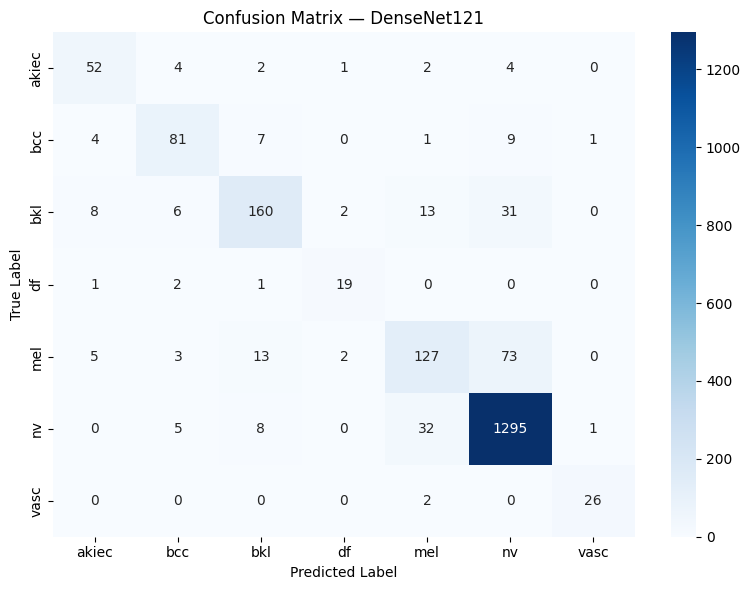

Saved: confusion_matrix_densenet121.png


In [49]:
all_preds, all_labels, all_probs = [], [], []

densenet.eval()
with torch.no_grad():
    for images, labels in tqdm(test_loader, desc="Testing"):
        images = images.to(device)
        outputs = densenet(images)
        probs = torch.softmax(outputs, dim=1)
        preds = probs.argmax(1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.numpy())
        all_probs.extend(probs.cpu().numpy())

all_preds  = np.array(all_preds)
all_labels = np.array(all_labels)
all_probs  = np.array(all_probs)

acc = accuracy_score(all_labels, all_preds)
f1  = f1_score(all_labels, all_preds, average="weighted")
try:
    auc_score = roc_auc_score(all_labels, all_probs, multi_class="ovr")
except ValueError:
    auc_score = "N/A (AUC needs >1 class in test set)"

print("\nClassification Report:\n")
print(classification_report(all_labels, all_preds, target_names=class_names))
print(f"Test Accuracy: {acc:.4f}")
print(f"Weighted F1 Score: {f1:.4f}")
print(f"ROC AUC Score: {auc_score}")

cm = confusion_matrix(all_labels, all_preds)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label"); plt.ylabel("True Label")
plt.title("Confusion Matrix — DenseNet121")
plt.tight_layout()
plt.savefig("/kaggle/working/confusion_matrix_densenet121.png", dpi=300)
plt.show()
print("Saved: confusion_matrix_densenet121.png")

### ROC‑AUC Curves - DenseNet121

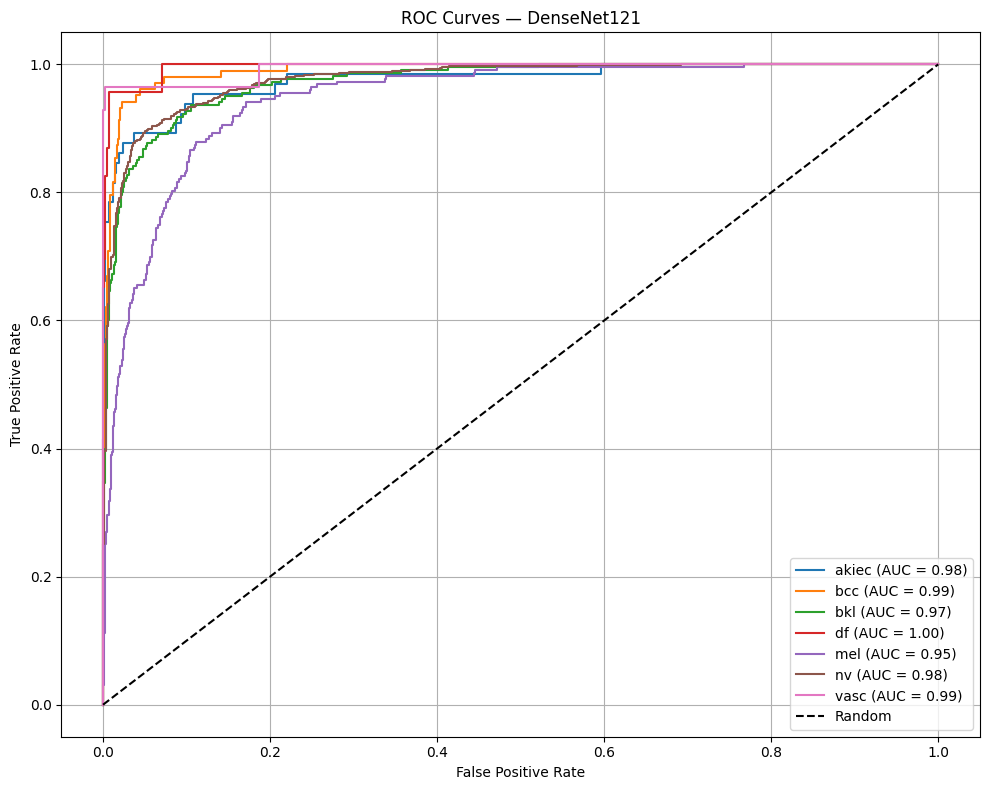

Macro AUC: 0.9786
Micro AUC: 0.9892


In [50]:
plot_multiclass_roc(
    all_labels=np.array(all_labels),
    all_probs=np.array(all_probs),
    class_names=class_names,
    title="ROC Curves — DenseNet121",
    outfile="/kaggle/working/roc_curves_densenet121.png"
)

### Grad‑CAM Generation for Test Images — DenseNet‑121 (Plot + Save, with Fallback)

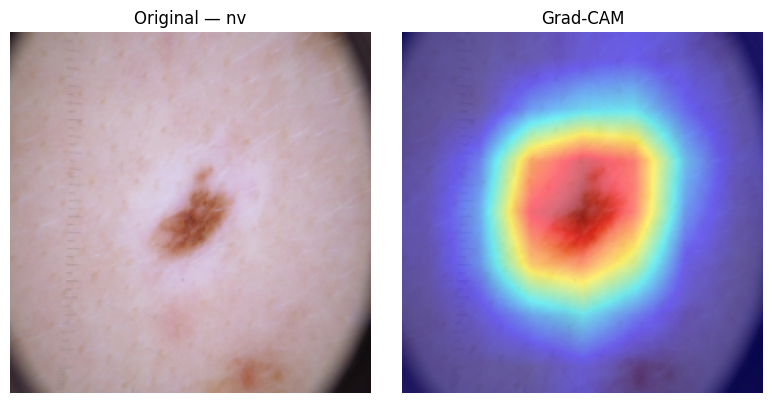

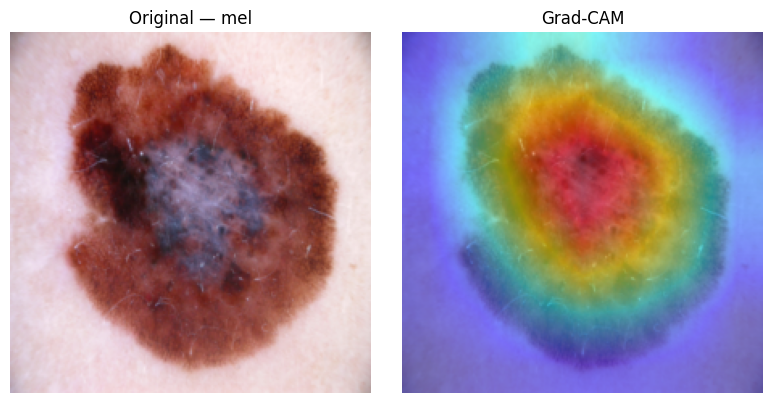

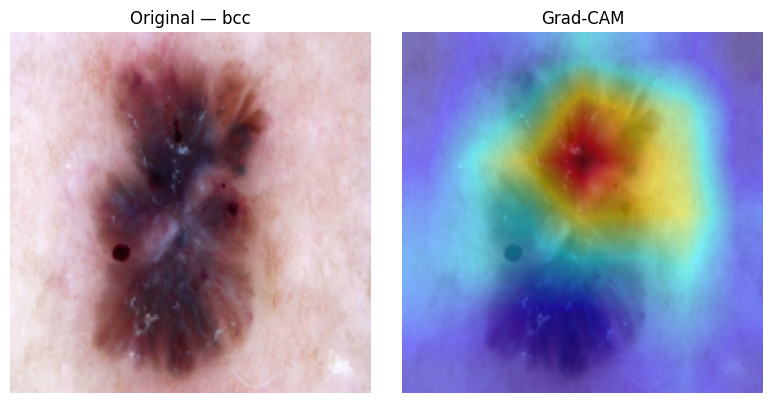

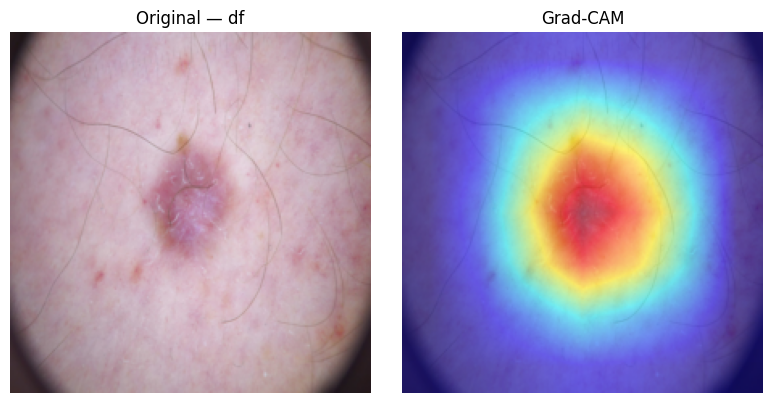

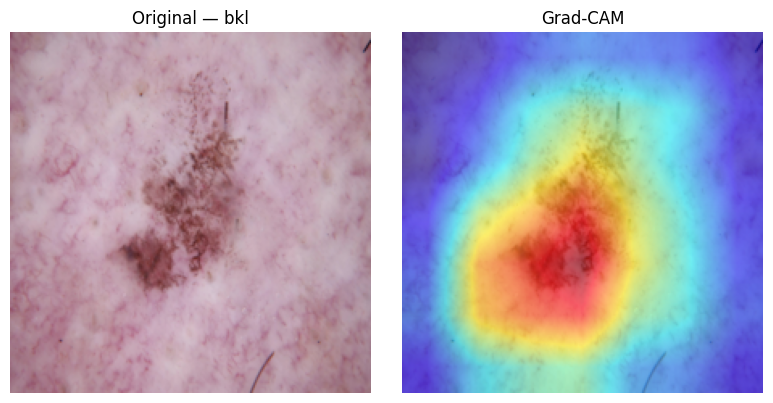

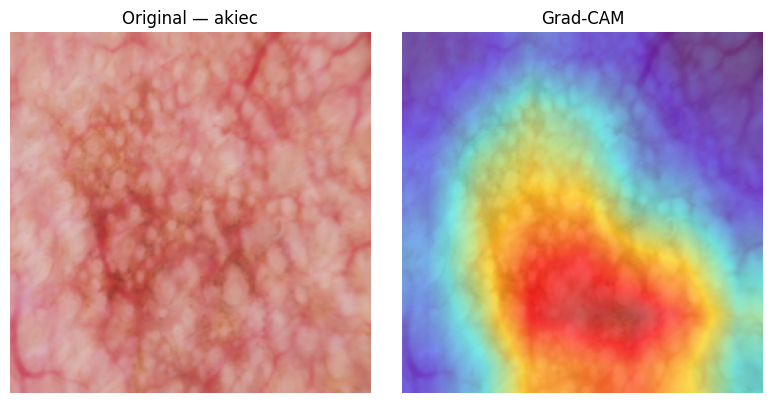

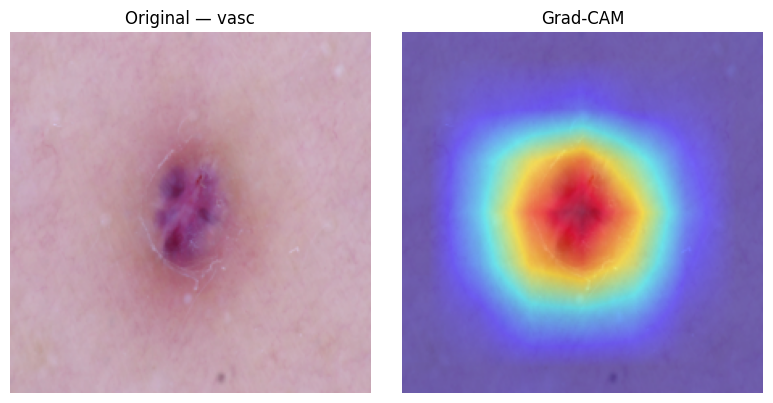

Saved DenseNet‑121 Grad‑CAM images to: /kaggle/working/gradcam_densenet121_per_class


In [51]:
# Sanity checks
assert 'densenet' in globals(), "densenet model not found. Train/reload DenseNet‑121 first."
assert 'test_loader' in globals(), "test_loader not found."
assert 'class_names' in globals(), "class_names not found."
assert 'device' in globals(), "device not found (cuda/cpu)."

# Inverse of normalize([0.5]*3, [0.5]*3) for correct colors
def inv_norm_05(img_t):
    x = img_t.detach().cpu().clone()
    for c in range(3):
        x[c] = x[c] * 0.5 + 0.5
    return x.clamp(0,1).permute(1,2,0).numpy()  # HWC, [0,1]

# Find the last conv layer (good default CAM target)
def _find_last_conv(m: nn.Module):
    last = None
    for mod in m.modules():
        if isinstance(mod, nn.Conv2d):
            last = mod
    if last is None:
        raise RuntimeError("No Conv2d layer found in DenseNet.")
    return last

densenet.eval()
target_layer = _find_last_conv(densenet)
cam = PTGradCAM(model=densenet, target_layers=[target_layer])

# Collect one image per class (prefer correct predictions), else fallback
got = {c: False for c in class_names}
cam_results = {}

# Pass 1 — correct predictions
for images, labels in test_loader:
    images, labels = images.to(device), labels.to(device)
    with torch.no_grad():
        preds = densenet(images).argmax(1)

    for i in range(images.size(0)):
        t_lbl = labels[i].item()
        p_lbl = preds[i].item()
        cname = class_names[t_lbl]
        if got[cname] or p_lbl != t_lbl:
            continue

        it = images[i].unsqueeze(0).requires_grad_(True)
        densenet.zero_grad()
        gcam = cam(input_tensor=it, targets=[ClassifierOutputTarget(p_lbl)])[0]

        rgb01 = inv_norm_05(images[i])
        cam_img = show_cam_on_image(rgb01, gcam, use_rgb=True)

        cam_results[cname] = (images[i].cpu(), cam_img)
        got[cname] = True
    if all(got.values()):
        break

# Pass 2 — fallback (first available, even if misclassified)
if not all(got.values()):
    missing = [c for c,v in got.items() if not v]
    print(f"[Info] No correct predictions for classes: {missing}. Falling back to first available sample.")
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        for i in range(images.size(0)):
            t_lbl = labels[i].item()
            cname = class_names[t_lbl]
            if got[cname]:
                continue

            it = images[i].unsqueeze(0).requires_grad_(True)
            densenet.zero_grad()
            gcam = cam(input_tensor=it, targets=[ClassifierOutputTarget(t_lbl)])[0]

            rgb01 = inv_norm_05(images[i])
            cam_img = show_cam_on_image(rgb01, gcam, use_rgb=True)

            cam_results[cname] = (images[i].cpu(), cam_img)
            got[cname] = True
        if all(got.values()):
            break

# Plot & save
out_dir = Path("/kaggle/working/gradcam_densenet121_per_class")
out_dir.mkdir(parents=True, exist_ok=True)

if not cam_results:
    print("[Warning] No Grad‑CAM images generated for DenseNet‑121. Check model/loader.")
else:
    for cname, (img_t, cam_img) in cam_results.items():
        orig = inv_norm_05(img_t)
        plt.figure(figsize=(8,4))
        plt.subplot(1,2,1); plt.imshow(orig);   plt.title(f"Original — {cname}"); plt.axis('off')
        plt.subplot(1,2,2); plt.imshow(cam_img); plt.title("Grad‑CAM");           plt.axis('off')
        plt.tight_layout()
        save_path = out_dir / f"gradcam_{cname}.png"
        plt.savefig(save_path, dpi=300, bbox_inches="tight", pad_inches=0.05)
        plt.show()
    print(f"Saved DenseNet‑121 Grad‑CAM images to: {out_dir.resolve()}")

# Cleanup hooks
try:
    cam.activations_and_grads.release()
except Exception:
    pass
del cam

## EfficientNet-B3

### Add/Ensure Image Paths — EfficientNet‑B3

In [52]:
image_dir_1 = "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_1/"
image_dir_2 = "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_2/"

def resolve_path(img_id):
    f1 = os.path.join(image_dir_1, f"{img_id}.jpg")
    f2 = os.path.join(image_dir_2, f"{img_id}.jpg")
    return f1 if os.path.exists(f1) else f2

df["path"] = df["image_id"].apply(resolve_path)
# labels already set globally: df['label'] = df['dx'].map(label_map).astype(int)

### Transforms — EfficientNet‑B3 (300×300)

In [53]:
train_transform = transforms.Compose([
    transforms.Resize((300, 300)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])

val_transform = transforms.Compose([
    transforms.Resize((300, 300)),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])

### Train/Val/Test Split & DataLoaders — EfficientNet‑B3

In [54]:
# 70/15/15 or 80/10/10
train_df, temp_df = train_test_split(df, test_size=0.30, stratify=df["label"], random_state=42)
val_df,   test_df = train_test_split(temp_df, test_size=0.50, stratify=temp_df["label"], random_state=42)

train_dataset = SkinLesionDataset(train_df, transform=train_transform)
val_dataset   = SkinLesionDataset(val_df,   transform=val_transform)
test_dataset  = SkinLesionDataset(test_df,  transform=val_transform)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True,  num_workers=2, pin_memory=True)
val_loader   = DataLoader(val_dataset,   batch_size=32, shuffle=False, num_workers=2, pin_memory=True)
test_loader  = DataLoader(test_dataset,  batch_size=32, shuffle=False, num_workers=2, pin_memory=True)

### Initialize EfficientNet‑B3

In [55]:
effnet = efficientnet_b3(weights=EfficientNet_B3_Weights.IMAGENET1K_V1)
effnet.classifier[1] = nn.Linear(effnet.classifier[1].in_features, len(class_names))
effnet = effnet.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(effnet.parameters(), lr=1e-4)

Downloading: "https://download.pytorch.org/models/efficientnet_b3_rwightman-b3899882.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b3_rwightman-b3899882.pth
100%|██████████| 47.2M/47.2M [00:00<00:00, 160MB/s] 


### Train Function — EfficientNet‑B3 (Early Stopping)

In [56]:
def train_model_effnet(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=50, patience=5):
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    patience_counter = 0

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")
        model.train()
        running_loss, running_corrects = 0.0, 0

        for inputs, labels in tqdm(train_loader, desc="Training", leave=False):
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward(); optimizer.step()

            preds = outputs.argmax(1)
            running_loss += loss.item() * inputs.size(0)
            running_corrects += (preds == labels).sum().item()

        train_loss = running_loss / len(train_loader.dataset)
        train_acc  = running_corrects / len(train_loader.dataset)

        # Validation
        model.eval()
        val_corrects = 0
        with torch.no_grad():
            for inputs, labels in tqdm(val_loader, desc="Validating", leave=False):
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                preds = outputs.argmax(1)
                val_corrects += (preds == labels).sum().item()

        val_acc = val_corrects / len(val_loader.dataset)
        print(f"Train Loss: {train_loss:.4f} Acc: {train_acc:.4f} | Val Acc: {val_acc:.4f}")

        if val_acc > best_acc:
            best_acc = val_acc
            best_model_wts = copy.deepcopy(model.state_dict())
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print("Early stopping!")
                break

    return model, best_model_wts

### Train & Save Best — EfficientNet‑B3

In [93]:
effnet, best_wts = train_model_effnet(
    effnet, train_loader, val_loader, criterion, optimizer, device,
    num_epochs=50, patience=5
)
effnet.load_state_dict(best_wts)
torch.save(effnet.state_dict(), "/kaggle/working/efficientnet_b3_best.pth")
print("EfficientNet‑B3 model saved to /kaggle/working/efficientnet_b3_best.pth")


Epoch 1/50


Train Loss: 0.8368 Acc: 0.7264 | Val Acc: 0.8109

Epoch 2/50


Train Loss: 0.4932 Acc: 0.8267 | Val Acc: 0.8535

Epoch 3/50


Train Loss: 0.3482 Acc: 0.8752 | Val Acc: 0.8668

Epoch 4/50


Train Loss: 0.2606 Acc: 0.9074 | Val Acc: 0.8662

Epoch 5/50


Train Loss: 0.2037 Acc: 0.9295 | Val Acc: 0.8768

Epoch 6/50


Train Loss: 0.1624 Acc: 0.9417 | Val Acc: 0.8955

Epoch 7/50


Train Loss: 0.1167 Acc: 0.9589 | Val Acc: 0.9028

Epoch 8/50


Train Loss: 0.1068 Acc: 0.9659 | Val Acc: 0.8935

Epoch 9/50


Train Loss: 0.0809 Acc: 0.9728 | Val Acc: 0.8941

Epoch 10/50


Train Loss: 0.0741 Acc: 0.9767 | Val Acc: 0.8901

Epoch 11/50


Train Loss: 0.0581 Acc: 0.9807 | Val Acc: 0.9021

Epoch 12/50


Train Loss: 0.0517 Acc: 0.9837 | Val Acc: 0.8975
Early stopping!
EfficientNet‑B3 model saved to /kaggle/working/efficientnet_b3_best.pth


### Reload the Model — EfficientNet‑B3

In [57]:
# Reload the Model — EfficientNet‑B3 (run this only if restarted the kernel)
effnet = efficientnet_b3(weights=None)
effnet.classifier[1] = nn.Linear(effnet.classifier[1].in_features, len(class_names))
effnet.load_state_dict(torch.load("/kaggle/input/efficientnetb3-ham10000-model-weights/efficientnet_b3_best.pth", map_location=device))
effnet = effnet.to(device)
effnet.eval()

EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 40, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(40, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=40, bias=False)
            (1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(40, 10, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(10, 40, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActiv

### Evaluate on Test Set — EfficientNet‑B3

Testing: 100%|██████████| 47/47 [00:09<00:00,  4.84it/s]



Classification Report:

              precision    recall  f1-score   support

       akiec       0.79      0.69      0.74        49
         bcc       0.88      0.74      0.80        77
         bkl       0.78      0.81      0.80       165
          df       1.00      0.41      0.58        17
         mel       0.75      0.75      0.75       167
          nv       0.95      0.97      0.96      1006
        vasc       0.95      0.91      0.93        22

    accuracy                           0.90      1503
   macro avg       0.87      0.76      0.79      1503
weighted avg       0.90      0.90      0.90      1503

Test Accuracy: 0.8982
Weighted F1 Score: 0.8964
ROC AUC Score: 0.981209635930277


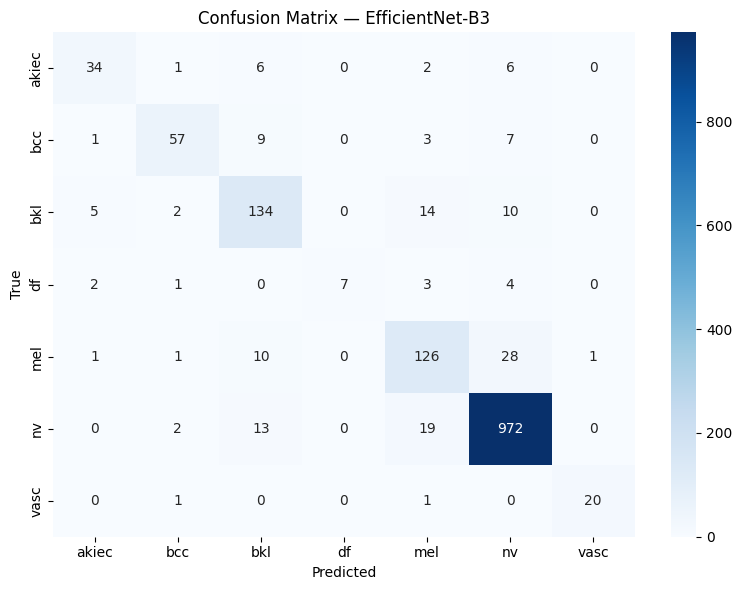

In [58]:
all_preds, all_labels, all_probs = [], [], []

effnet.eval()
with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing"):
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = effnet(inputs)
        probs = torch.softmax(outputs, dim=1)
        preds = probs.argmax(1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())

all_preds  = np.array(all_preds)
all_labels = np.array(all_labels)
all_probs  = np.array(all_probs)

acc = accuracy_score(all_labels, all_preds)
f1  = f1_score(all_labels, all_preds, average="weighted")
try:
    auc_score = roc_auc_score(all_labels, all_probs, multi_class="ovr")
except ValueError:
    auc_score = "N/A (AUC needs >1 class in test set)"

print("\nClassification Report:\n")
print(classification_report(all_labels, all_preds, target_names=class_names))
print(f"Test Accuracy: {acc:.4f}")
print(f"Weighted F1 Score: {f1:.4f}")
print(f"ROC AUC Score: {auc_score}")

cm = confusion_matrix(all_labels, all_preds)
plt.figure(figsize=(8,6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted"); plt.ylabel("True")
plt.title("Confusion Matrix — EfficientNet‑B3")
plt.tight_layout()
plt.savefig("/kaggle/working/confusion_matrix_efficientnetb3.png", dpi=300)
plt.show()

### ROC‑AUC Curves — EfficientNet‑B3

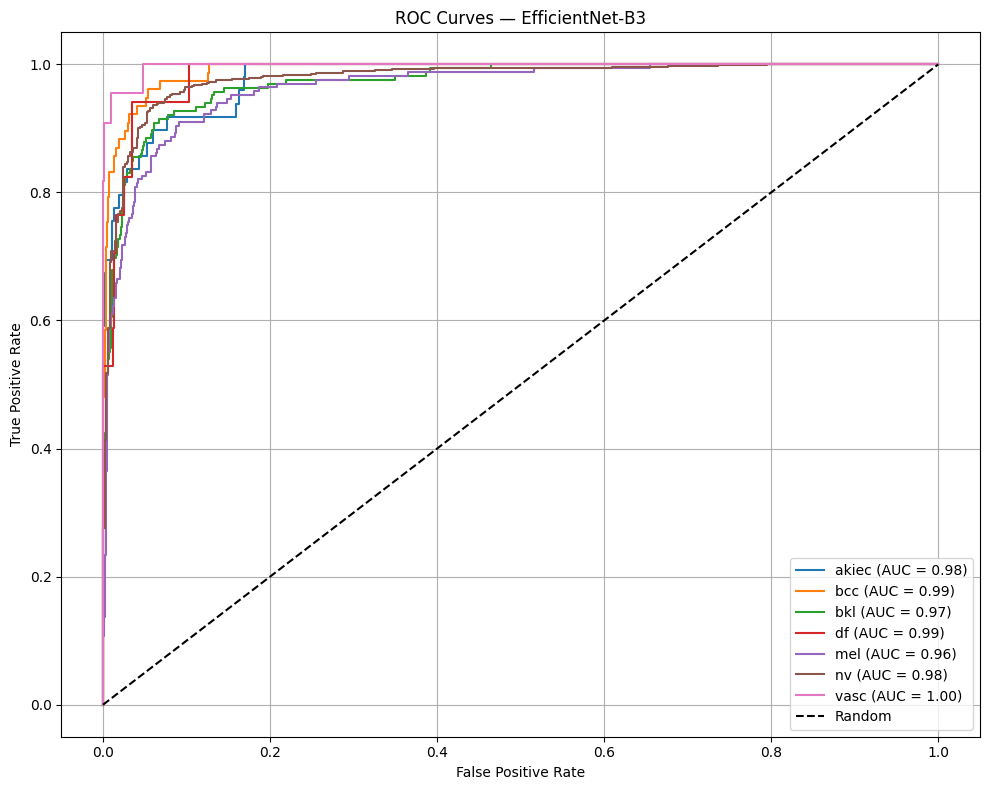

Macro AUC: 0.9812
Micro AUC: 0.9904


In [59]:
plot_multiclass_roc(
    all_labels=all_labels,
    all_probs=all_probs,
    class_names=class_names,
    title="ROC Curves — EfficientNet‑B3",
    outfile="/kaggle/working/roc_curves_efficientnetb3.png"
)

### Grad‑CAM Generation for Test Images — EfficientNet‑B3 (Plot + Save, with Fallback)

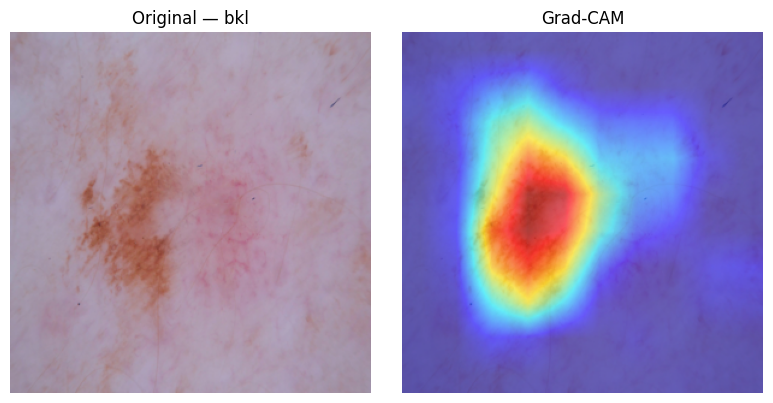

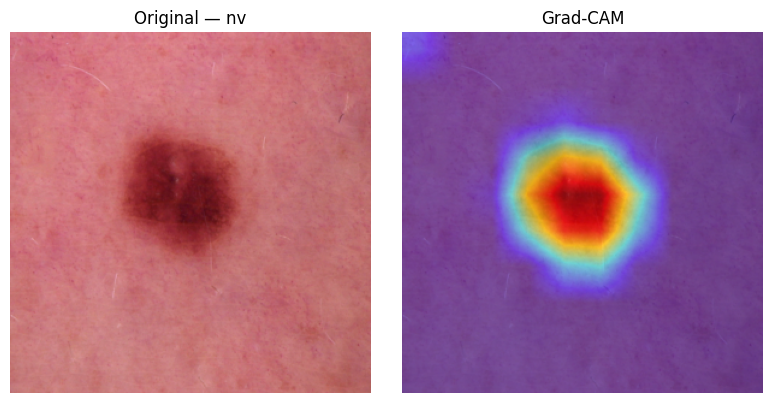

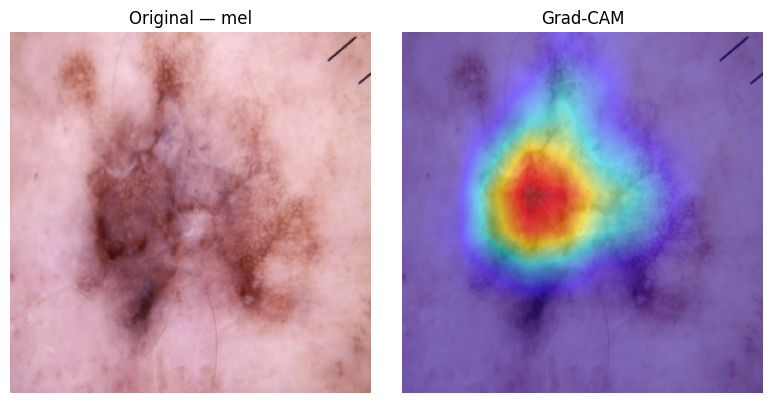

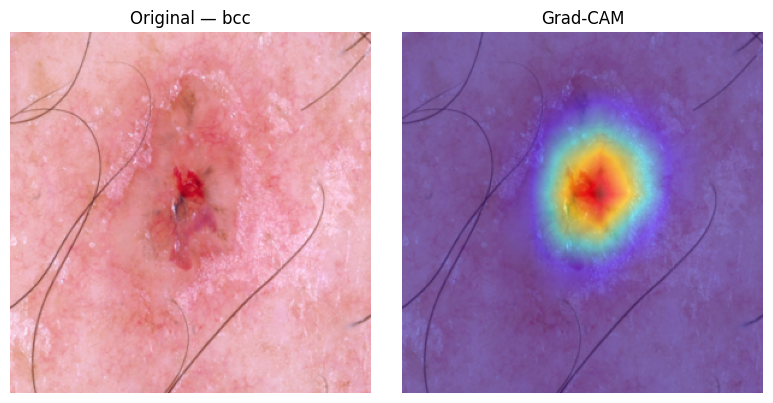

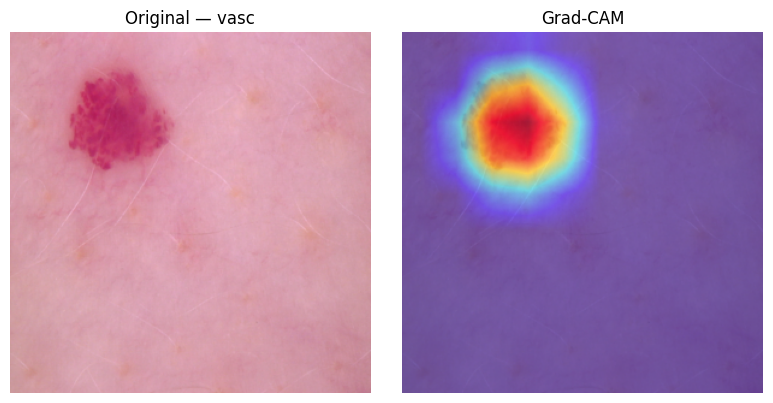

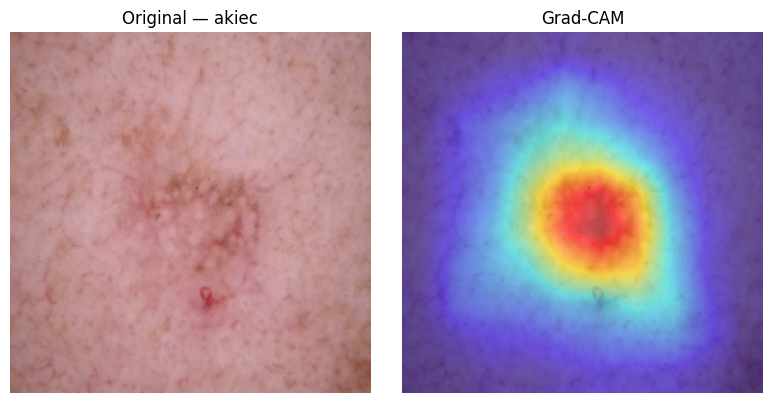

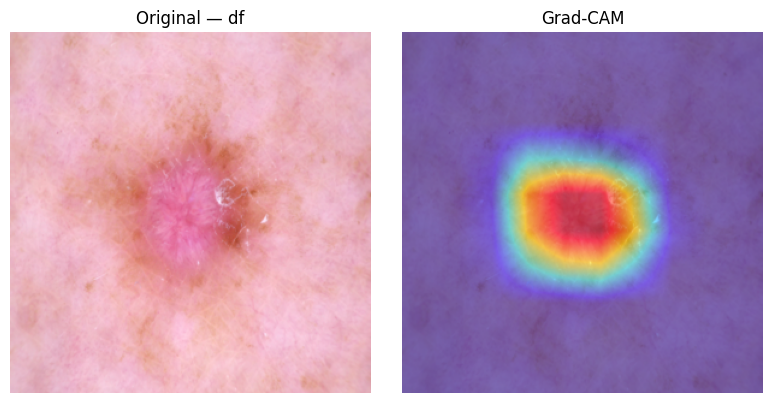

Saved EfficientNet-B3 Grad-CAM images to: /kaggle/working/gradcam_efficientnet_b3_per_class


In [60]:
# Pick objects / sanity checks
effnet_model = globals().get("effnet", None) or globals().get("effnet_model", None)
assert effnet_model is not None, "EfficientNet-B3 model not found."
test_loader_effnet = globals().get("test_loader_effnet", None) or globals().get("test_loader", None)
assert test_loader_effnet is not None, "Test loader not found."
assert 'class_names' in globals(), "class_names not found."
assert 'device' in globals(), "device not found."

# Helper functions
def inv_norm_05(img_t):
    """Invert Normalize([0.5]*3,[0.5]*3) to RGB [0,1]. img_t: CHW tensor."""
    x = img_t.detach().cpu().clone()
    for c in range(3):
        x[c] = x[c] * 0.5 + 0.5
    return x.clamp(0, 1).permute(1, 2, 0).numpy()

def find_last_conv_module(net: nn.Module):
    last = None
    for m in net.modules():
        if isinstance(m, nn.Conv2d):
            last = m
    if last is None:
        raise RuntimeError("No Conv2d layer found in the model.")
    return last

# Setup Grad-CAM
effnet_model.eval()
target_layer = find_last_conv_module(effnet_model)
cam = PTGradCAM(model=effnet_model, target_layers=[target_layer])

got = {c: False for c in class_names}
cam_results = {}

# Pass 1: prefer correctly predicted examples
for images, labels in test_loader_effnet:
    images, labels = images.to(device), labels.to(device)
    with torch.no_grad():
        preds = effnet_model(images).argmax(1)

    for i in range(images.size(0)):
        t_lbl = labels[i].item()
        p_lbl = preds[i].item()
        cname = class_names[t_lbl]
        if got[cname] or p_lbl != t_lbl:
            continue

        it = images[i].unsqueeze(0).requires_grad_(True)
        effnet_model.zero_grad()
        grayscale_cam = cam(input_tensor=it, targets=[ClassifierOutputTarget(p_lbl)])[0]

        rgb01 = inv_norm_05(images[i])
        cam_img = show_cam_on_image(rgb01, grayscale_cam, use_rgb=True)

        cam_results[cname] = (rgb01, cam_img)
        got[cname] = True

    if all(got.values()):
        break

# Pass 2: fallback for missing classes
if not all(got.values()):
    missing = [c for c, v in got.items() if not v]
    print(f"[Info] No correct predictions for classes: {missing}. Falling back to first available sample.")
    for images, labels in test_loader_effnet:
        images, labels = images.to(device), labels.to(device)
        for i in range(images.size(0)):
            t_lbl = labels[i].item()
            cname = class_names[t_lbl]
            if got[cname]:
                continue

            it = images[i].unsqueeze(0).requires_grad_(True)
            effnet_model.zero_grad()
            grayscale_cam = cam(input_tensor=it, targets=[ClassifierOutputTarget(t_lbl)])[0]

            rgb01 = inv_norm_05(images[i])
            cam_img = show_cam_on_image(rgb01, grayscale_cam, use_rgb=True)

            cam_results[cname] = (rgb01, cam_img)
            got[cname] = True

        if all(got.values()):
            break

# Plot & save
out_dir = Path("/kaggle/working/gradcam_efficientnet_b3_per_class")
out_dir.mkdir(parents=True, exist_ok=True)

if not cam_results:
    print("[Warning] No Grad-CAM images generated for EfficientNet-B3.")
else:
    for cname, (orig_rgb01, cam_img) in cam_results.items():
        plt.figure(figsize=(8, 4))
        plt.subplot(1, 2, 1); plt.imshow(orig_rgb01); plt.title(f"Original — {cname}"); plt.axis('off')
        plt.subplot(1, 2, 2); plt.imshow(cam_img);     plt.title("Grad-CAM");          plt.axis('off')
        plt.tight_layout()
        sp = out_dir / f"gradcam_{cname}.png"
        plt.savefig(sp, dpi=300, bbox_inches="tight", pad_inches=0.05)
        plt.show()
    print(f"Saved EfficientNet-B3 Grad-CAM images to: {out_dir.resolve()}")

# Cleanup hooks
try:
    cam.activations_and_grads.release()
except Exception:
    pass
del cam

## ConvNeXt-Tiny

### Reproducibility & ImageNet Normalization Setup

In [61]:
def set_seed(seed=42):
    random.seed(seed); np.random.seed(seed); torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)
set_seed(42)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ImageNet stats (ConvNeXt expects these)
IMAGENET_MEAN = [0.485, 0.456, 0.406]
IMAGENET_STD  = [0.229, 0.224, 0.225]

### Dataset, Fixed Label Map, Splits, Transforms, Loaders

In [62]:
# Dataset class that reads PIL images from df['path'] and returns (tensor, label)
class SkinLesionDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        p = self.df.loc[idx, "path"]
        y = int(self.df.loc[idx, "label"])
        img = Image.open(p).convert("RGB")
        if self.transform:
            img = self.transform(img)
        return img, y

# Resolve image paths from both folders
img_dir1 = "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_1"
img_dir2 = "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_2"

def resolve_path(img_id):
    p1 = os.path.join(img_dir1, f"{img_id}.jpg")
    p2 = os.path.join(img_dir2, f"{img_id}.jpg")
    return p1 if os.path.exists(p1) else p2

# Load metadata
df = pd.read_csv("/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_metadata.csv")
df["path"] = df["image_id"].apply(resolve_path)

# Use a stable label mapping (alphabetical is fine)
class_names = sorted(df["dx"].unique().tolist())
label_map = {name: i for i, name in enumerate(class_names)}
df["label"] = df["dx"].map(label_map).astype(int)

# Split 70/15/15 stratified
train_df, temp_df = train_test_split(
    df, test_size=0.30, stratify=df["label"], random_state=42
)
val_df, test_df = train_test_split(
    temp_df, test_size=0.50, stratify=temp_df["label"], random_state=42
)

print("Split sizes:", len(train_df), len(val_df), len(test_df))
print("Classes:", class_names)

# Use ImageNet normalization everywhere for ConvNeXt
train_tf = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize(IMAGENET_MEAN, IMAGENET_STD),
])
eval_tf = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(IMAGENET_MEAN, IMAGENET_STD),
])

# Datasets & loaders
train_ds = SkinLesionDataset(train_df, transform=train_tf)
val_ds   = SkinLesionDataset(val_df,   transform=eval_tf)
test_ds  = SkinLesionDataset(test_df,  transform=eval_tf)

train_loader = DataLoader(train_ds, batch_size=32, shuffle=True,  num_workers=2, pin_memory=True)
val_loader   = DataLoader(val_ds,   batch_size=32, shuffle=False, num_workers=2, pin_memory=True)
test_loader  = DataLoader(test_ds,  batch_size=32, shuffle=False, num_workers=2, pin_memory=True)

Split sizes: 7010 1502 1503
Classes: ['akiec', 'bcc', 'bkl', 'df', 'mel', 'nv', 'vasc']


### Model Init (ConvNeXt‑Tiny), Loss, Optimizer, Scheduler

In [63]:
convnext = convnext_tiny(weights=ConvNeXt_Tiny_Weights.IMAGENET1K_V1)
convnext.classifier[2] = nn.Linear(convnext.classifier[2].in_features, len(class_names))
convnext = convnext.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(convnext.parameters(), lr=1e-4, weight_decay=1e-2)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, mode="max", patience=2, factor=0.5, verbose=True
)

Downloading: "https://download.pytorch.org/models/convnext_tiny-983f1562.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny-983f1562.pth
100%|██████████| 109M/109M [00:00<00:00, 217MB/s] 


### Train + Early Stopping (AMP), Save Best

In [13]:
def train_model(model, train_loader, val_loader, criterion, optimizer,
                device, num_epochs=50, patience=5, scheduler=None, use_amp=True):
    best_wts = deepcopy(model.state_dict())
    best_acc = 0.0
    no_improve = 0

    scaler = torch.cuda.amp.GradScaler(enabled=(use_amp and device.type == "cuda"))

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")

        # Train
        model.train()
        tr_loss, tr_correct, tr_seen = 0.0, 0, 0
        for x, y in tqdm(train_loader, desc="Training", leave=False):
            x, y = x.to(device), y.to(device)
            optimizer.zero_grad(set_to_none=True)

            with torch.cuda.amp.autocast(enabled=scaler.is_enabled()):
                logits = model(x)
                loss = criterion(logits, y)

            if scaler.is_enabled():
                scaler.scale(loss).backward()
                scaler.step(optimizer)
                scaler.update()
            else:
                loss.backward()
                optimizer.step()

            preds = logits.argmax(1)
            tr_loss   += loss.item() * x.size(0)
            tr_correct+= (preds == y).sum().item()
            tr_seen   += y.size(0)

        train_loss = tr_loss / tr_seen
        train_acc  = tr_correct / tr_seen

        # Validate
        model.eval()
        val_correct, val_seen = 0, 0
        with torch.no_grad():
            for x, y in tqdm(val_loader, desc="Validating", leave=False):
                x, y = x.to(device), y.to(device)
                logits = model(x)
                val_correct += (logits.argmax(1) == y).sum().item()
                val_seen    += y.size(0)

        val_acc = val_correct / val_seen
        if scheduler is not None:
            scheduler.step(val_acc)

        print(f"Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.4f}")
        print(f"Val   Acc: {val_acc:.4f}")

        if val_acc > best_acc:
            best_acc = val_acc
            best_wts = deepcopy(model.state_dict())
            no_improve = 0
            print("New best model (by Val Acc).")
        else:
            no_improve += 1
            if no_improve >= patience:
                print("Early stopping triggered.")
                break

    model.load_state_dict(best_wts)
    print(f"Best Val Acc: {best_acc:.4f}")

    # Save best
    save_path = "/kaggle/working/convnext_tiny_ham10000.pth"
    torch.save(model.state_dict(), save_path)
    print(f"Saved best model to {save_path}")
    return model

convnext = train_model(
    convnext, train_loader, val_loader, criterion, optimizer,
    device, num_epochs=50, patience=5, scheduler=scheduler, use_amp=True
)

/tmp/ipykernel_36/2995766757.py:7: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = torch.cuda.amp.GradScaler(enabled=(use_amp and device.type == "cuda"))



Epoch 1/50


Training:   0%|          | 0/220 [00:00<?, ?it/s]/tmp/ipykernel_36/2995766757.py:19: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=scaler.is_enabled()):


Train Loss: 0.7106 | Train Acc: 0.7532
Val   Acc: 0.8309
New best model (by Val Acc).

Epoch 2/50


Train Loss: 0.4221 | Train Acc: 0.8479
Val   Acc: 0.8529
New best model (by Val Acc).

Epoch 3/50


Train Loss: 0.2896 | Train Acc: 0.8922
Val   Acc: 0.8722
New best model (by Val Acc).

Epoch 4/50


Train Loss: 0.1911 | Train Acc: 0.9318
Val   Acc: 0.8881
New best model (by Val Acc).

Epoch 5/50


Train Loss: 0.1195 | Train Acc: 0.9611
Val   Acc: 0.8968
New best model (by Val Acc).

Epoch 6/50


Train Loss: 0.1065 | Train Acc: 0.9658
Val   Acc: 0.8842

Epoch 7/50


Train Loss: 0.0672 | Train Acc: 0.9786
Val   Acc: 0.8775

Epoch 8/50


Train Loss: 0.0597 | Train Acc: 0.9800
Val   Acc: 0.8941

Epoch 9/50


Train Loss: 0.0260 | Train Acc: 0.9926
Val   Acc: 0.9095
New best model (by Val Acc).

Epoch 10/50


Train Loss: 0.0152 | Train Acc: 0.9963
Val   Acc: 0.9108
New best model (by Val Acc).

Epoch 11/50


Train Loss: 0.0143 | Train Acc: 0.9966
Val   Acc: 0.9128
New best model (by Val Acc).

Epoch 12/50


Train Loss: 0.0077 | Train Acc: 0.9984
Val   Acc: 0.9201
New best model (by Val Acc).

Epoch 13/50


Train Loss: 0.0125 | Train Acc: 0.9967
Val   Acc: 0.9101

Epoch 14/50


Train Loss: 0.0162 | Train Acc: 0.9954
Val   Acc: 0.9148

Epoch 15/50


Train Loss: 0.0089 | Train Acc: 0.9976
Val   Acc: 0.9108

Epoch 16/50


Train Loss: 0.0056 | Train Acc: 0.9987
Val   Acc: 0.9181

Epoch 17/50


Train Loss: 0.0058 | Train Acc: 0.9983
Val   Acc: 0.9101
Early stopping triggered.
Best Val Acc: 0.9201
Saved best model to /kaggle/working/convnext_tiny_ham10000.pth


### Reload Best & Evaluate (VAL Sanity then TEST)

Testing (TEST): 100%|██████████| 47/47 [00:08<00:00,  5.35it/s]



TEST — Classification Report:

              precision    recall  f1-score   support

       akiec       0.69      0.84      0.76        49
         bcc       0.85      0.87      0.86        77
         bkl       0.80      0.81      0.80       165
          df       0.92      0.71      0.80        17
         mel       0.78      0.72      0.75       167
          nv       0.96      0.96      0.96      1006
        vasc       1.00      0.91      0.95        22

    accuracy                           0.91      1503
   macro avg       0.86      0.83      0.84      1503
weighted avg       0.91      0.91      0.91      1503

TEST — Acc: 0.9062 | F1 (weighted): 0.9060 | AUC (OvR): 0.9855855475853291


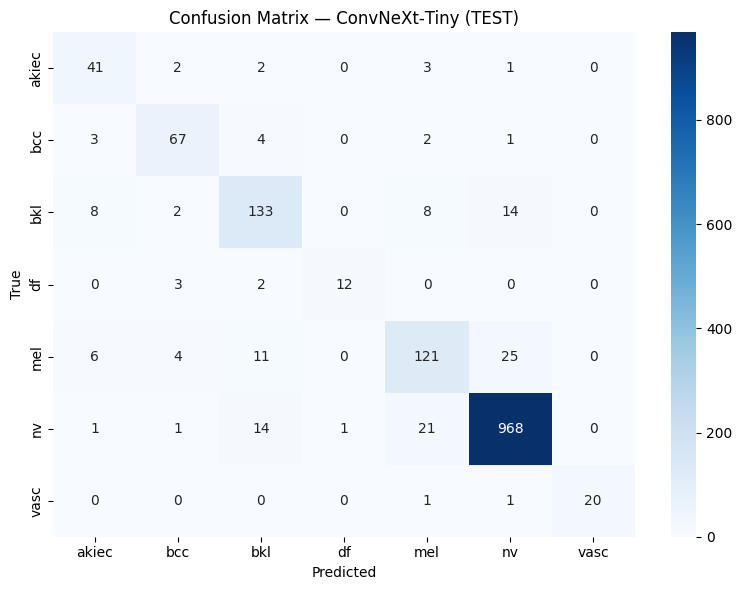

Saved: /kaggle/working/confusion_matrix_convnext_tiny_test.png


In [64]:
# Reload to be extra sure we use the saved best
convnext_loaded = convnext_tiny(weights=None)
convnext_loaded.classifier[2] = nn.Linear(convnext_loaded.classifier[2].in_features, len(class_names))
convnext_loaded.load_state_dict(torch.load("/kaggle/input/ham10000-convnext-tiny-weights/convnext_tiny_ham10000.pth", map_location=device))
convnext_loaded = convnext_loaded.to(device)
convnext_loaded.eval()

def evaluate(model, loader, device, name="SPLIT"):
    all_preds, all_labels, all_probs = [], [], []
    model.eval()
    with torch.no_grad():
        for x, y in tqdm(loader, desc=f"Testing ({name})"):
            x, y = x.to(device), y.to(device)
            logits = model(x)
            probs  = torch.softmax(logits, dim=1)
            preds  = probs.argmax(1)

            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(y.cpu().numpy())
            all_probs.extend(probs.cpu().numpy())

    all_preds  = np.array(all_preds)
    all_labels = np.array(all_labels)
    all_probs  = np.array(all_probs)

    print(f"\n{name} — Classification Report:\n")
    print(classification_report(all_labels, all_preds, target_names=class_names))

    acc = accuracy_score(all_labels, all_preds)
    f1  = f1_score(all_labels, all_preds, average="weighted")
    try:
        auc_score = roc_auc_score(all_labels, all_probs, multi_class="ovr")
    except ValueError:
        auc_score = "N/A (needs >1 class present)"
    print(f"{name} — Acc: {acc:.4f} | F1 (weighted): {f1:.4f} | AUC (OvR): {auc_score}")

    # Confusion Matrix
    cm = confusion_matrix(all_labels, all_preds)
    plt.figure(figsize=(8,6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
                xticklabels=class_names, yticklabels=class_names)
    plt.xlabel("Predicted"); plt.ylabel("True")
    plt.title(f"Confusion Matrix — ConvNeXt‑Tiny ({name})")
    plt.tight_layout()
    out_png = f"/kaggle/working/confusion_matrix_convnext_tiny_{name.lower()}.png"
    plt.savefig(out_png, dpi=300)
    plt.show()
    print(f"Saved: {out_png}")

    return acc, f1, auc_score, all_labels, all_probs

# Final numbers on test
acc, f1, auc_score, all_labels, all_probs = evaluate(convnext_loaded, test_loader, device, name="TEST")

### ROC‑AUC Curves — ConvNeXt‑Tiny

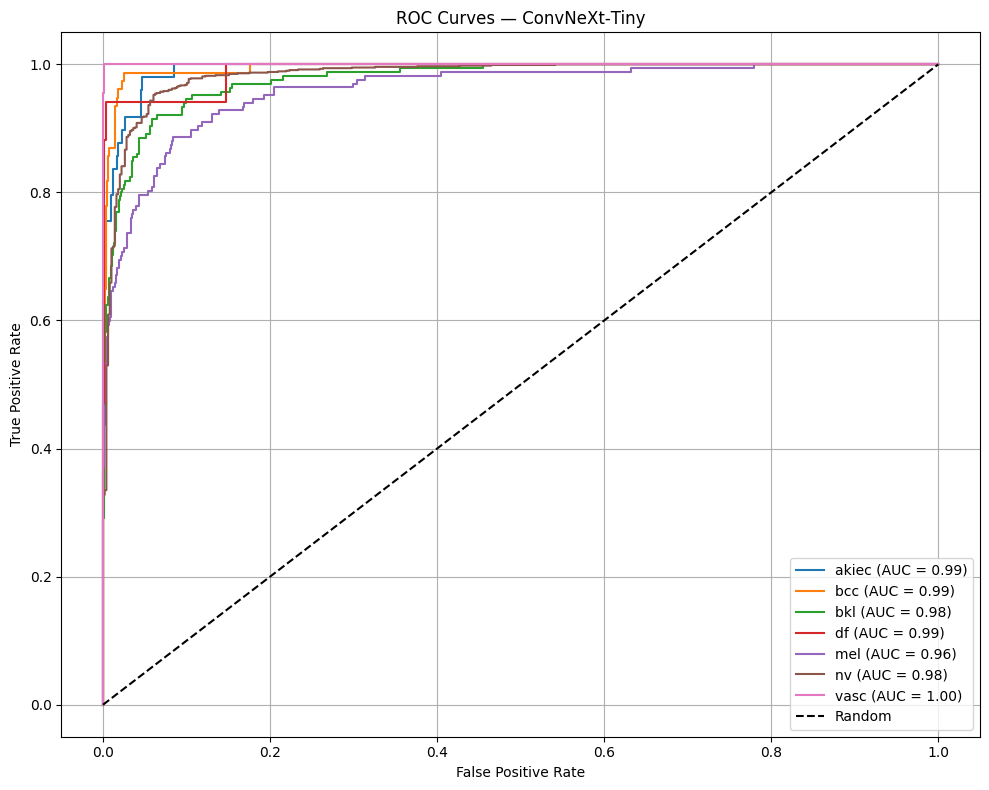

Macro AUC: 0.9856
Micro AUC: 0.9919


In [65]:
plot_multiclass_roc(
    all_labels=all_labels,
    all_probs=all_probs,
    class_names=class_names,
    title="ROC Curves — ConvNeXt‑Tiny",
    outfile="/kaggle/working/roc_curves_convnext_tiny.png"
)

### Grad‑CAM Generation for Test Images — ConvNeXt‑Tiny (Plot + Save, with Fallback)

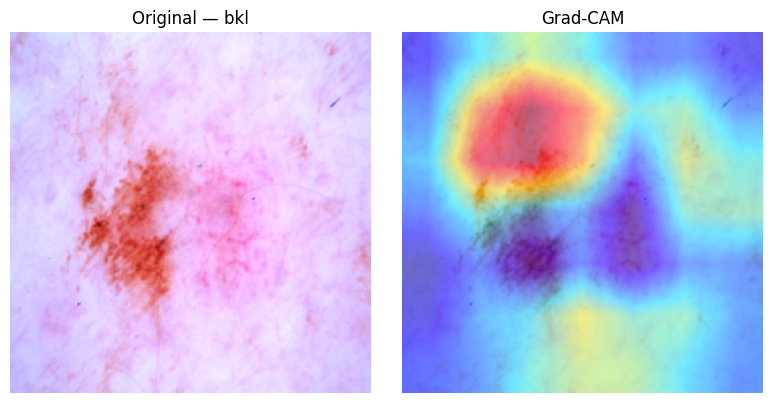

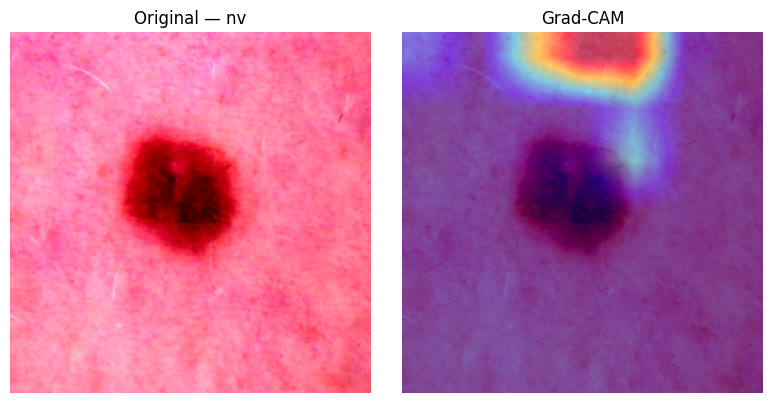

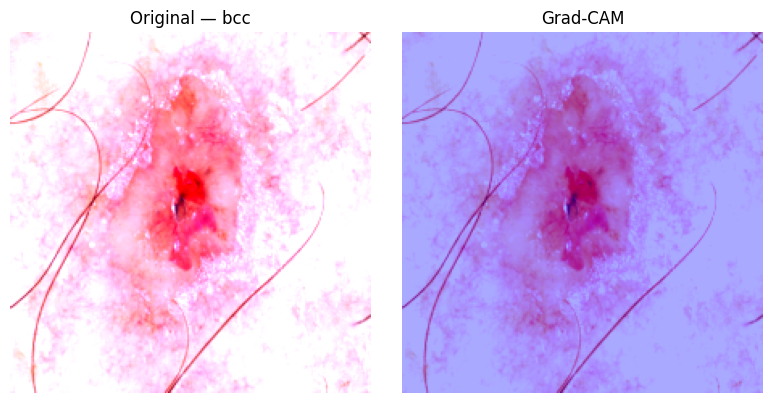

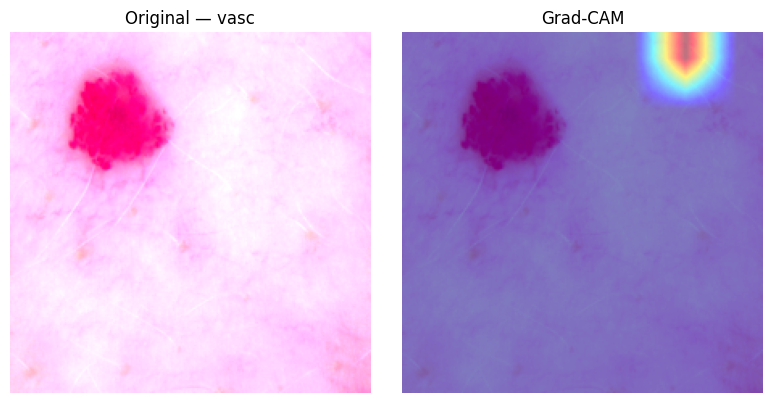

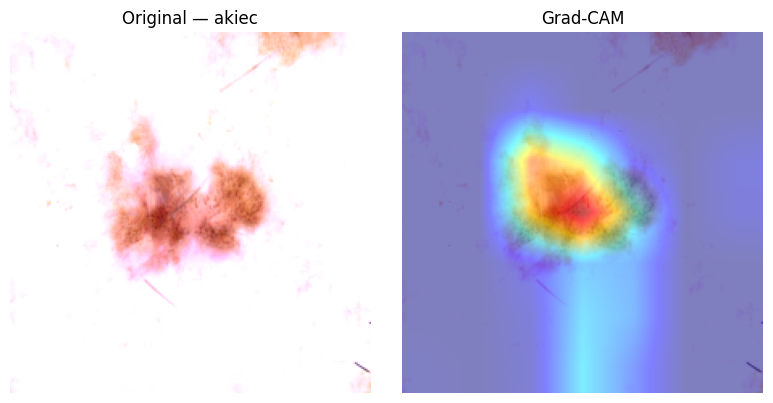

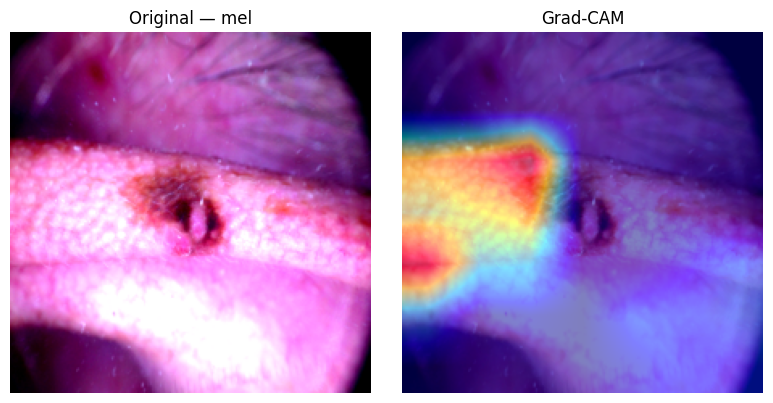

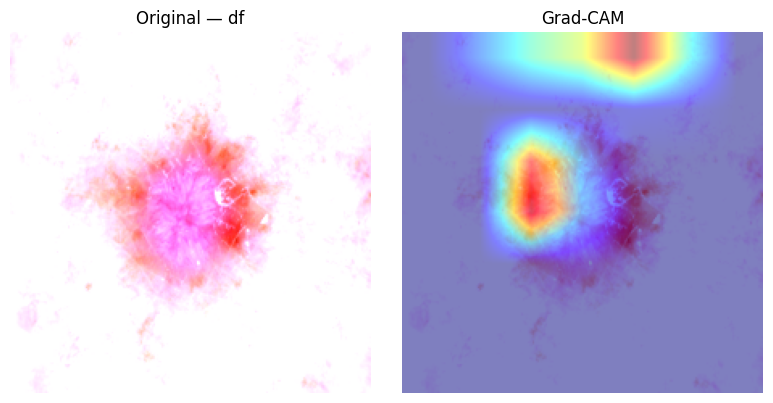

Saved ConvNeXt‑Tiny Grad‑CAM images to: /kaggle/working/gradcam_convnext_tiny_per_class


In [66]:
# Pick objects / sanity checks
convnext_model = globals().get("convnext_loaded", None) or globals().get("convnext", None)
assert convnext_model is not None, "ConvNeXt‑Tiny model not found (convnext_loaded or convnext)."
test_loader_convnext = globals().get("test_loader_convnext", None) or globals().get("test_loader", None)
assert test_loader_convnext is not None, "Test loader not found (test_loader_convnext or test_loader)."
assert 'class_names' in globals(), "class_names not found."
assert 'device' in globals(), "device not found."

# Helpers
def inv_norm_05(img_t):
    """Invert Normalize([0.5]*3,[0.5]*3) -> RGB [0,1]. img_t: CHW tensor."""
    x = img_t.detach().cpu().clone()
    for c in range(3):
        x[c] = x[c] * 0.5 + 0.5
    return x.clamp(0, 1).permute(1, 2, 0).numpy()

def find_last_conv_module(net: nn.Module):
    last = None
    for m in net.modules():
        if isinstance(m, nn.Conv2d):
            last = m
    if last is None:
        raise RuntimeError("No Conv2d layer found in ConvNeXt‑Tiny.")
    return last

# Setup Grad‑CAM
convnext_model.eval()
target_layer = find_last_conv_module(convnext_model)  # safe default
cam = PTGradCAM(model=convnext_model, target_layers=[target_layer])

got = {c: False for c in class_names}
cam_results = {}

# Pass 1: prefer correctly predicted examples
for images, labels in test_loader_convnext:
    images, labels = images.to(device), labels.to(device)
    with torch.no_grad():
        preds = convnext_model(images).argmax(1)

    for i in range(images.size(0)):
        t_lbl = labels[i].item()
        p_lbl = preds[i].item()
        cname = class_names[t_lbl]
        if got[cname] or p_lbl != t_lbl:
            continue

        it = images[i].unsqueeze(0).requires_grad_(True)
        convnext_model.zero_grad()
        grayscale_cam = cam(input_tensor=it, targets=[ClassifierOutputTarget(p_lbl)])[0]

        rgb01 = inv_norm_05(images[i])
        cam_img = show_cam_on_image(rgb01, grayscale_cam, use_rgb=True)

        cam_results[cname] = (rgb01, cam_img)
        got[cname] = True

    if all(got.values()):
        break

# Pass 2: fallback for missing classes
if not all(got.values()):
    missing = [c for c, v in got.items() if not v]
    print(f"[Info] No correct predictions for classes: {missing}. Falling back to first available sample.")
    for images, labels in test_loader_convnext:
        images, labels = images.to(device), labels.to(device)
        for i in range(images.size(0)):
            t_lbl = labels[i].item()
            cname = class_names[t_lbl]
            if got[cname]:
                continue

            it = images[i].unsqueeze(0).requires_grad_(True)
            convnext_model.zero_grad()
            # drive CAM toward the TRUE label even if misclassified
            grayscale_cam = cam(input_tensor=it, targets=[ClassifierOutputTarget(t_lbl)])[0]

            rgb01 = inv_norm_05(images[i])
            cam_img = show_cam_on_image(rgb01, grayscale_cam, use_rgb=True)

            cam_results[cname] = (rgb01, cam_img)
            got[cname] = True

        if all(got.values()):
            break

# Plot & save
out_dir = Path("/kaggle/working/gradcam_convnext_tiny_per_class")
out_dir.mkdir(parents=True, exist_ok=True)

if not cam_results:
    print("[Warning] No Grad‑CAM images generated for ConvNeXt‑Tiny.")
else:
    for cname, (orig_rgb01, cam_img) in cam_results.items():
        plt.figure(figsize=(8, 4))
        plt.subplot(1, 2, 1); plt.imshow(orig_rgb01); plt.title(f"Original — {cname}"); plt.axis('off')
        plt.subplot(1, 2, 2); plt.imshow(cam_img);     plt.title("Grad‑CAM");          plt.axis('off')
        plt.tight_layout()
        sp = out_dir / f"gradcam_{cname}.png"
        plt.savefig(sp, dpi=300, bbox_inches="tight", pad_inches=0.05)
        plt.show()
    print(f"Saved ConvNeXt‑Tiny Grad‑CAM images to: {out_dir.resolve()}")

# Cleanup hooks
try:
    cam.activations_and_grads.release()
except Exception:
    pass
del cam

## MobileNetV3

### MobileNetV3 — Load Metadata & Resolve Image Paths

In [67]:
df = pd.read_csv("/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_metadata.csv")

img_dir_1 = "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_1"
img_dir_2 = "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_2"

def resolve_path(img_id):
    p1 = os.path.join(img_dir_1, f"{img_id}.jpg")
    p2 = os.path.join(img_dir_2, f"{img_id}.jpg")
    return p1 if os.path.exists(p1) else p2

df["path"] = df["image_id"].apply(resolve_path)
df["label"] = df["dx"].map(label_map).astype(int)

### MobileNetV3 — Train/Val/Test Split

In [68]:
df_temp, test_df = train_test_split(df, test_size=0.20, stratify=df["label"], random_state=42)
train_df, val_df = train_test_split(df_temp, test_size=0.20, stratify=df_temp["label"], random_state=42)

print(len(train_df), len(val_df), len(test_df))

6409 1603 2003


### MobileNetV3 — Transforms

In [69]:
train_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])

val_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])

### MobileNetV3 — Dataloaders

In [70]:
train_dataset = SkinLesionDataset(train_df, transform=train_transform)
val_dataset   = SkinLesionDataset(val_df,   transform=val_transform)
test_dataset  = SkinLesionDataset(test_df,  transform=val_transform)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True,  num_workers=2, pin_memory=True)
val_loader   = DataLoader(val_dataset,   batch_size=32, shuffle=False, num_workers=2, pin_memory=True)
test_loader  = DataLoader(test_dataset,  batch_size=32, shuffle=False, num_workers=2, pin_memory=True)

### Model Definition

In [71]:
# Initialize MobileNetV3 large with pretrained weights
mobilenet = mobilenet_v3_large(weights=MobileNet_V3_Large_Weights.IMAGENET1K_V1)

# Modify final classifier to match HAM10000 number of classes (7)
mobilenet.classifier[3] = nn.Linear(mobilenet.classifier[3].in_features, 7)

mobilenet = mobilenet.to(device)

# Define loss & optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(mobilenet.parameters(), lr=1e-4)

Downloading: "https://download.pytorch.org/models/mobilenet_v3_large-8738ca79.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_large-8738ca79.pth
100%|██████████| 21.1M/21.1M [00:00<00:00, 140MB/s]


### MobileNetV3 — Train (Early Stopping, Save Best)

In [26]:
def train_mobilenet(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=50, patience=5):
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    epochs_no_improve = 0

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")
        model.train()
        run_loss, run_correct, run_total = 0.0, 0, 0

        for inputs, labels in tqdm(train_loader, desc="Training", leave=False):
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            run_loss += loss.item() * inputs.size(0)
            run_correct += (outputs.argmax(1) == labels).sum().item()
            run_total += labels.size(0)

        train_loss = run_loss / run_total
        train_acc  = run_correct / run_total

        # Validation
        model.eval()
        val_correct, val_total = 0, 0
        with torch.no_grad():
            for inputs, labels in tqdm(val_loader, desc="Validating", leave=False):
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                val_correct += (outputs.argmax(1) == labels).sum().item()
                val_total   += labels.size(0)

        val_acc = val_correct / val_total
        print(f"Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.4f}")
        print(f"Val   Acc: {val_acc:.4f}")

        # Early stopping
        if val_acc > best_acc:
            best_acc = val_acc
            best_model_wts = copy.deepcopy(model.state_dict())
            torch.save(best_model_wts, "/kaggle/working/mobilenetv3_ham10000.pth")
            print("Best MobileNetV3 model saved.")
            epochs_no_improve = 0
        else:
            epochs_no_improve += 1
            if epochs_no_improve >= patience:
                print("Early stopping triggered.")
                break

    return model, best_model_wts

mobilenet, best_model_wts = train_mobilenet(
    mobilenet, train_loader, val_loader, criterion, optimizer, device,
    num_epochs=50, patience=5
)
# Save final best
mobilenet.load_state_dict(best_model_wts)
torch.save(mobilenet.state_dict(), "/kaggle/working/mobilenetv3_ham10000.pth")
print("MobileNetV3 model saved to /kaggle/working/mobilenetv3_ham10000.pth")


Epoch 1/50


Train Loss: 0.7791 | Train Acc: 0.7301
Val   Acc: 0.7405
Best MobileNetV3 model saved.

Epoch 2/50


Train Loss: 0.5040 | Train Acc: 0.8139
Val   Acc: 0.8191
Best MobileNetV3 model saved.

Epoch 3/50


Train Loss: 0.3909 | Train Acc: 0.8510
Val   Acc: 0.8434
Best MobileNetV3 model saved.

Epoch 4/50


Train Loss: 0.2984 | Train Acc: 0.8922
Val   Acc: 0.8434

Epoch 5/50


Train Loss: 0.2319 | Train Acc: 0.9150
Val   Acc: 0.8565
Best MobileNetV3 model saved.

Epoch 6/50


Train Loss: 0.1782 | Train Acc: 0.9391
Val   Acc: 0.8522

Epoch 7/50


Train Loss: 0.1272 | Train Acc: 0.9543
Val   Acc: 0.8515

Epoch 8/50


Train Loss: 0.1088 | Train Acc: 0.9613
Val   Acc: 0.8603
Best MobileNetV3 model saved.

Epoch 9/50


Train Loss: 0.0950 | Train Acc: 0.9649
Val   Acc: 0.8709
Best MobileNetV3 model saved.

Epoch 10/50


Train Loss: 0.0693 | Train Acc: 0.9760
Val   Acc: 0.8403

Epoch 11/50


Train Loss: 0.0646 | Train Acc: 0.9755
Val   Acc: 0.8653

Epoch 12/50


Train Loss: 0.0656 | Train Acc: 0.9792
Val   Acc: 0.8559

Epoch 13/50


Train Loss: 0.0587 | Train Acc: 0.9794
Val   Acc: 0.8690

Epoch 14/50


Train Loss: 0.0530 | Train Acc: 0.9833
Val   Acc: 0.8677
Early stopping triggered.
MobileNetV3 model saved to /kaggle/working/mobilenetv3_ham10000.pth


### Reload the Model — MobileNetV3

In [72]:
mobilenet = mobilenet_v3_large(weights=None)
mobilenet.classifier[3] = nn.Linear(mobilenet.classifier[3].in_features, len(class_names))
mobilenet.load_state_dict(torch.load("//kaggle/input/mobilenetv3-ham10000-model-weights/mobilenetv3_ham10000.pth", map_location=device))
mobilenet = mobilenet.to(device)
mobilenet.eval()

MobileNetV3(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
      (2): Hardswish()
    )
    (1): InvertedResidual(
      (block): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=16, bias=False)
          (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
        )
        (1): Conv2dNormActivation(
          (0): Conv2d(16, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
        )
      )
    )
    (2): InvertedResidual(
      (block): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1), bi

### Evaluate on Test Set — Metrics & Confusion Matrix (MobileNetV3)

Testing: 100%|██████████| 63/63 [00:09<00:00,  6.37it/s]



Classification Report:

              precision    recall  f1-score   support

       akiec       0.62      0.72      0.67        65
         bcc       0.81      0.73      0.77       103
         bkl       0.75      0.66      0.70       220
          df       0.80      0.52      0.63        23
         mel       0.70      0.62      0.66       223
          nv       0.91      0.96      0.93      1341
        vasc       1.00      0.79      0.88        28

    accuracy                           0.86      2003
   macro avg       0.80      0.71      0.75      2003
weighted avg       0.85      0.86      0.86      2003

Test Accuracy: 0.8587
Weighted F1 Score: 0.8551
ROC AUC Score: 0.9720473374965639


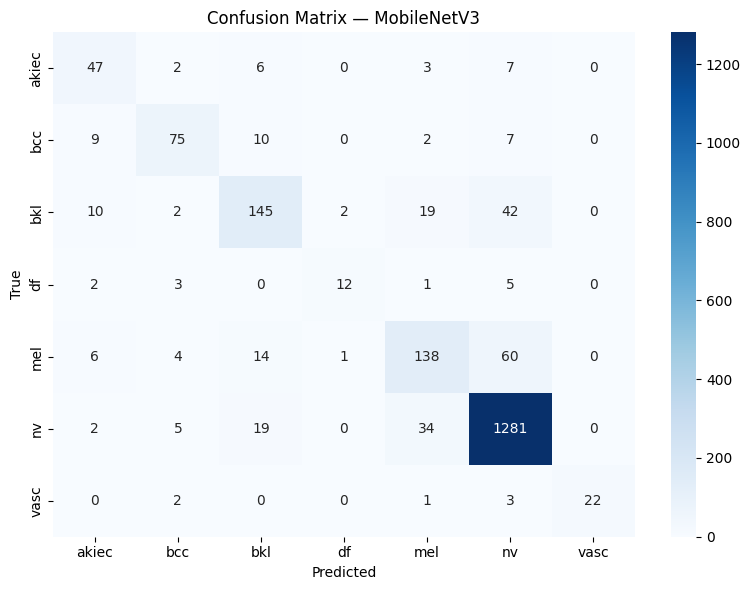

Confusion matrix saved to 'confusion_matrix_mobilenetv3.png'.


In [73]:
all_preds_mnv3, all_labels_mnv3, all_probs_mnv3 = [], [], []

mobilenet.eval()
with torch.no_grad():
    for inputs, labels in tqdm(test_loader, desc="Testing"):
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = mobilenet(inputs)
        probs = torch.softmax(outputs, dim=1)

        all_preds_mnv3.extend(probs.argmax(1).cpu().numpy())
        all_labels_mnv3.extend(labels.cpu().numpy())
        all_probs_mnv3.extend(probs.cpu().numpy())

# Convert to arrays
all_preds_mnv3  = np.array(all_preds_mnv3)
all_labels_mnv3 = np.array(all_labels_mnv3)
all_probs_mnv3  = np.array(all_probs_mnv3)

# Metrics
acc = accuracy_score(all_labels_mnv3, all_preds_mnv3)
f1  = f1_score(all_labels_mnv3, all_preds_mnv3, average="weighted")
try:
    auc_score = roc_auc_score(all_labels_mnv3, all_probs_mnv3, multi_class="ovr")
except ValueError:
    auc_score = "N/A (AUC needs >1 class in test set)"

# Report
print("\nClassification Report:\n")
print(classification_report(all_labels_mnv3, all_preds_mnv3, target_names=class_names))
print(f"Test Accuracy: {acc:.4f}")
print(f"Weighted F1 Score: {f1:.4f}")
print(f"ROC AUC Score: {auc_score}")

# Confusion Matrix
cm = confusion_matrix(all_labels_mnv3, all_preds_mnv3)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix — MobileNetV3")
plt.tight_layout()
plt.savefig("/kaggle/working/confusion_matrix_mobilenetv3.png", dpi=300)
plt.show()
print("Confusion matrix saved to 'confusion_matrix_mobilenetv3.png'.")

### ROC‑AUC Curves — MobileNetV3

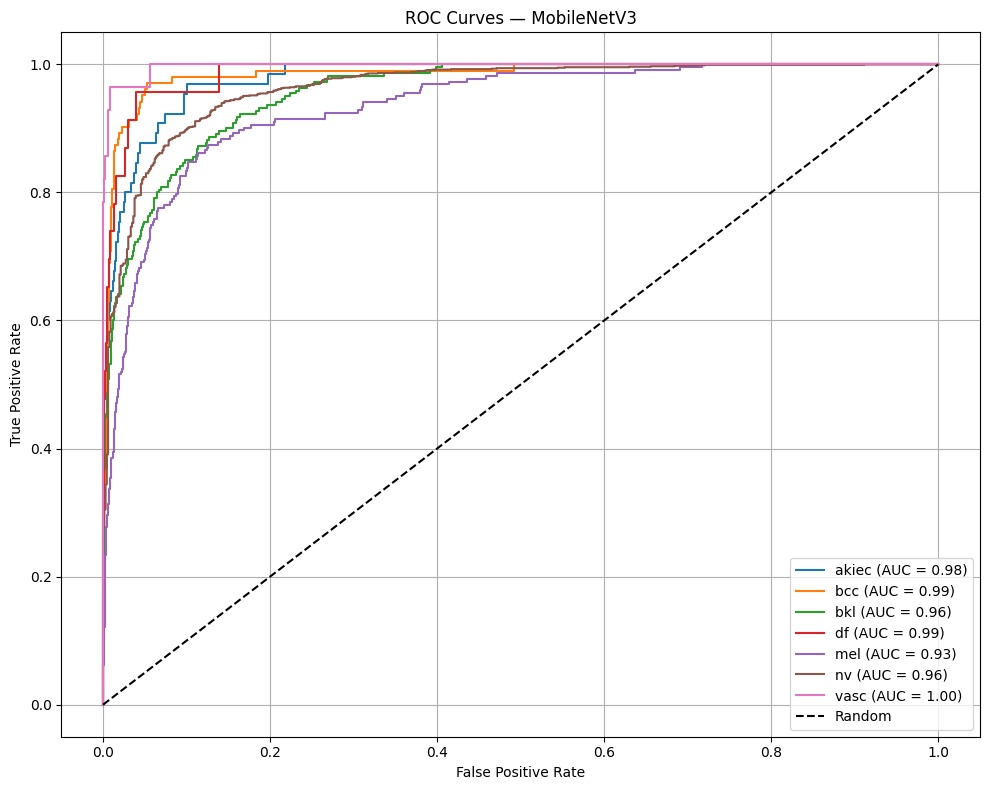

Macro AUC: 0.9720
Micro AUC: 0.9857


In [74]:
plot_multiclass_roc(
    all_labels=np.array(all_labels_mnv3),
    all_probs=np.array(all_probs_mnv3),
    class_names=class_names,
    title="ROC Curves — MobileNetV3",
    outfile="/kaggle/working/roc_curves_mobilenetv3.png"
)

### Grad‑CAM Generation for Test Images — MobileNetV3‑Large (Plot + Save, with Fallback)

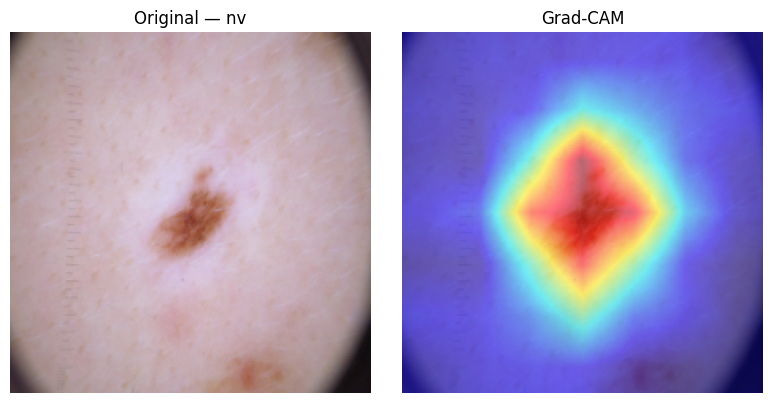

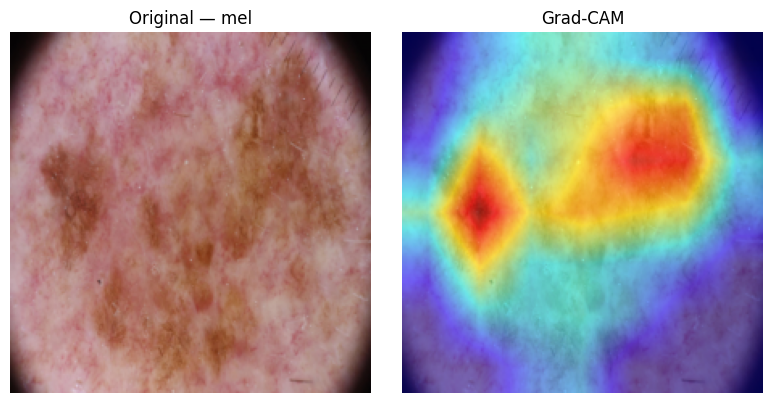

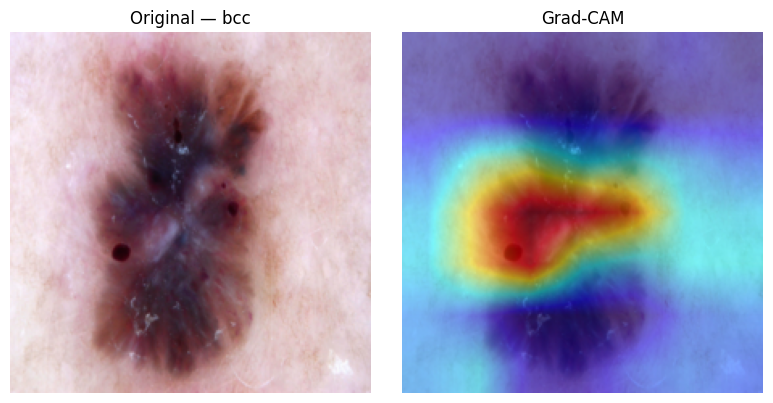

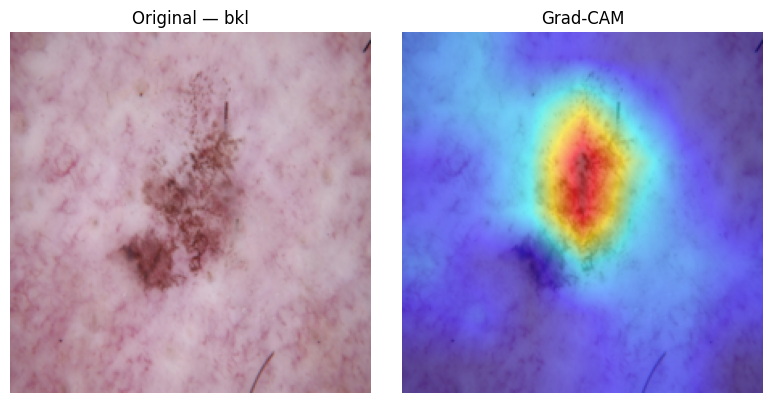

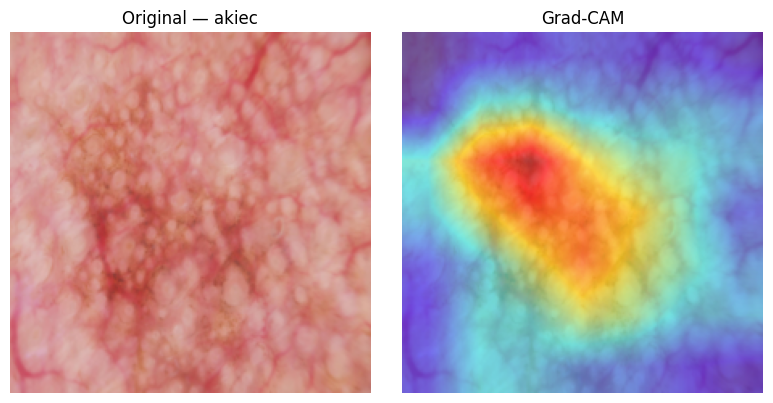

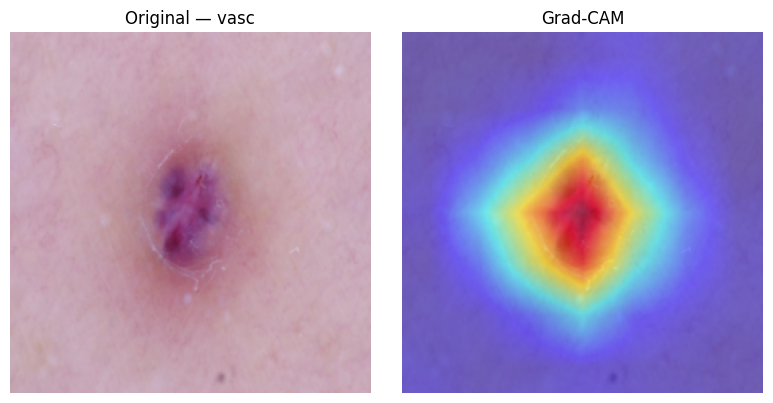

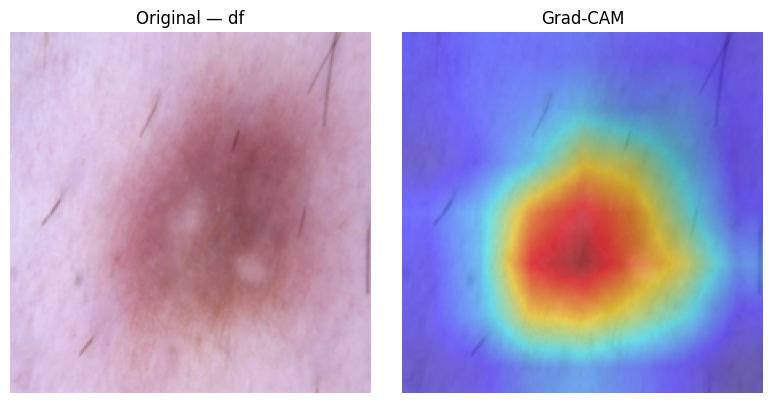

Saved MobileNetV3‑Large Grad‑CAM images to: /kaggle/working/gradcam_mobilenet_v3_per_class


In [75]:
# Pick objects / sanity checks
mobilenet_model = globals().get("mobilenet", None)
assert mobilenet_model is not None, "MobileNetV3 model not found (variable 'mobilenet')."
test_loader_mnv3 = globals().get("test_loader_mnv3", None) or globals().get("test_loader", None)
assert test_loader_mnv3 is not None, "Test loader not found (test_loader_mnv3 or test_loader)."
assert 'class_names' in globals(), "class_names not found."
assert 'device' in globals(), "device not found."

# Helpers
def inv_norm_05(img_t):
    """Invert Normalize([0.5]*3,[0.5]*3) -> RGB [0,1]. img_t: CHW tensor."""
    x = img_t.detach().cpu().clone()
    for c in range(3):
        x[c] = x[c] * 0.5 + 0.5
    return x.clamp(0, 1).permute(1, 2, 0).numpy()

def find_last_conv_module(net: nn.Module):
    last = None
    for m in net.modules():
        if isinstance(m, nn.Conv2d):
            last = m
    if last is None:
        raise RuntimeError("No Conv2d layer found in MobileNetV3‑Large.")
    return last

# Setup Grad‑CAM
mobilenet_model.eval()
target_layer = find_last_conv_module(mobilenet_model)  # last conv in features
cam = PTGradCAM(model=mobilenet_model, target_layers=[target_layer])

got = {c: False for c in class_names}
cam_results = {}

# Pass 1: prefer correctly predicted examples
for images, labels in test_loader_mnv3:
    images, labels = images.to(device), labels.to(device)
    with torch.no_grad():
        preds = mobilenet_model(images).argmax(1)

    for i in range(images.size(0)):
        t_lbl = labels[i].item()
        p_lbl = preds[i].item()
        cname = class_names[t_lbl]
        if got[cname] or p_lbl != t_lbl:
            continue

        it = images[i].unsqueeze(0).requires_grad_(True)
        mobilenet_model.zero_grad()
        grayscale_cam = cam(input_tensor=it, targets=[ClassifierOutputTarget(p_lbl)])[0]

        rgb01 = inv_norm_05(images[i])
        cam_img = show_cam_on_image(rgb01, grayscale_cam, use_rgb=True)

        cam_results[cname] = (rgb01, cam_img)
        got[cname] = True

    if all(got.values()):
        break

# Pass 2: fallback for missing classes
if not all(got.values()):
    missing = [c for c, v in got.items() if not v]
    print(f"[Info] No correct predictions for classes: {missing}. Falling back to first available sample.")
    for images, labels in test_loader_mnv3:
        images, labels = images.to(device), labels.to(device)
        for i in range(images.size(0)):
            t_lbl = labels[i].item()
            cname = class_names[t_lbl]
            if got[cname]:
                continue

            it = images[i].unsqueeze(0).requires_grad_(True)
            mobilenet_model.zero_grad()
            # drive CAM toward the TRUE label even if misclassified
            grayscale_cam = cam(input_tensor=it, targets=[ClassifierOutputTarget(t_lbl)])[0]

            rgb01 = inv_norm_05(images[i])
            cam_img = show_cam_on_image(rgb01, grayscale_cam, use_rgb=True)

            cam_results[cname] = (rgb01, cam_img)
            got[cname] = True

        if all(got.values()):
            break

# Plot & save
out_dir = Path("/kaggle/working/gradcam_mobilenet_v3_per_class")
out_dir.mkdir(parents=True, exist_ok=True)

if not cam_results:
    print("[Warning] No Grad‑CAM images generated for MobileNetV3‑Large.")
else:
    for cname, (orig_rgb01, cam_img) in cam_results.items():
        plt.figure(figsize=(8, 4))
        plt.subplot(1, 2, 1); plt.imshow(orig_rgb01); plt.title(f"Original — {cname}"); plt.axis('off')
        plt.subplot(1, 2, 2); plt.imshow(cam_img);     plt.title("Grad‑CAM");          plt.axis('off')
        plt.tight_layout()
        sp = out_dir / f"gradcam_{cname}.png"
        plt.savefig(sp, dpi=300, bbox_inches="tight", pad_inches=0.05)
        plt.show()
    print(f"Saved MobileNetV3‑Large Grad‑CAM images to: {out_dir.resolve()}")

# Cleanup hooks
try:
    cam.activations_and_grads.release()
except Exception:
    pass
del cam

## 2.4 Ensemble Framework

### Define CNNModel Architecture

In [76]:
class CNNModel(nn.Module):
    def __init__(self, num_classes=7):
        super(CNNModel, self).__init__()
        self.features = nn.Sequential(
            # Block 1
            nn.Conv2d(3, 32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),

            # Block 2
            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),

            # Block 3
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),

            # Block 4
            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2),
        )
        # 224x224 -> after 4 pools -> 14x14 feature map with 256 channels
        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(256 * 14 * 14, 512),
            nn.ReLU(inplace=True),
            nn.Dropout(0.5),
            nn.Linear(512, num_classes),
        )

    def forward(self, x):
        x = self.features(x)
        x = self.classifier(x)
        return x

### Ensemble — Reload All Models

In [77]:
# Helper: resolve image path from image_id (fallback)
IMG_DIRS = [
    "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_1",
    "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_2",
]

def find_image_path_from_id(image_id: str):
    fname = f"{image_id}.jpg"
    for d in IMG_DIRS:
        p = os.path.join(d, fname)
        if os.path.exists(p):
            return p
    return None

num_classes = len(class_names)

# CNN
cnn_model = CNNModel(num_classes=num_classes)
cnn_model.load_state_dict(torch.load(
    "/kaggle/input/kaggleinputham10000-model-weights/cnn_ham10000_best_model.pth",
    map_location=device
))
cnn_model = cnn_model.to(device).eval()

# ResNet-50

resnet_model = resnet50(weights=None)  # avoid default weights
resnet_model.fc = nn.Linear(resnet_model.fc.in_features, num_classes)

resnet_model.load_state_dict(torch.load(
    "/kaggle/input/resnet50-ham10000-model-weights/resnet50_ham10000.pth", 
    map_location=device
))

resnet_model = resnet_model.to(device).eval()

# DenseNet121
densenet_model = densenet121(weights=None)
densenet_model.classifier = nn.Linear(densenet_model.classifier.in_features, num_classes)
densenet_model.load_state_dict(torch.load(
    "/kaggle/input/densenet121-ham10000-model-weights/densenet121_ham10000.pth", 
    map_location=device))
densenet_model = densenet_model.to(device).eval()

# EfficientNet-B3
effnet_model = efficientnet_b3(weights=None)
effnet_model.classifier[1] = nn.Linear(effnet_model.classifier[1].in_features, num_classes)
effnet_model.load_state_dict(torch.load("/kaggle/input/efficientnetb3-ham10000-model-weights/efficientnet_b3_best.pth", map_location=device))
effnet_model = effnet_model.to(device).eval()

# ConvNeXt-Tiny
convnext_model = convnext_tiny(weights=None)
convnext_model.classifier[2] = nn.Linear(convnext_model.classifier[2].in_features, num_classes)
convnext_model.load_state_dict(torch.load("/kaggle/input/ham10000-convnext-tiny-weights/convnext_tiny_ham10000.pth", map_location=device))
convnext_model = convnext_model.to(device).eval()

# MobileNetV3-Large
mobilenet_model = mobilenet_v3_large(weights=None)
mobilenet_model.classifier[3] = nn.Linear(mobilenet_model.classifier[3].in_features, num_classes)
mobilenet_model.load_state_dict(torch.load("/kaggle/input/mobilenetv3-ham10000-model-weights/mobilenetv3_ham10000.pth", map_location=device))
mobilenet_model = mobilenet_model.to(device).eval()

# ViT (vit-base-patch16-224)
# Define correct config
vit_config = ViTConfig.from_pretrained(
    "google/vit-base-patch16-224",
    num_labels=num_classes  # must be 7
)

# Instantiate the model with random weights (but correct output shape)
vit_model = ViTForImageClassification(config=vit_config)

# Load fine-tuned weights
vit_model.load_state_dict(torch.load(
    "/kaggle/input/vit-ham10000-model-weights/vit_ham10000_best_model.pth",
    map_location=device
))

vit_model = vit_model.to(device).eval()

### Ensemble — Preprocessing Utilities (Per‑Model)

In [78]:
# Common transforms
to_tensor = transforms.ToTensor()
resize_224 = transforms.Resize((224, 224))
resize_300 = transforms.Resize((300, 300))

normalize_05 = transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
normalize_imagenet = transforms.Normalize([0.485, 0.456, 0.406],
                                          [0.229, 0.224, 0.225])

# CNN, DenseNet, ConvNeXt, MobileNetV3 used 224 with 0.5/0.5 norm in the flows
preprocess_224_05 = transforms.Compose([resize_224, to_tensor, normalize_05])

# ResNet-50 used ImageNet stats (224)
preprocess_resnet = transforms.Compose([resize_224, to_tensor, normalize_imagenet])

# EfficientNet-B3 used 300 with 0.5/0.5 norm
preprocess_effnet = transforms.Compose([resize_300, to_tensor, normalize_05])

# ViT uses its processor; recreate it
vit_processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224")

def preprocess_vit(pil_img: Image.Image) -> torch.Tensor:
    enc = vit_processor(images=pil_img, return_tensors="pt")
    return enc["pixel_values"].squeeze(0)  # CHW

# 	3.	Evaluation Metrics

### Compare All Individual Models and Ensemble

In [79]:
assert 'class_names' in globals() and 'device' in globals(), "Define class_names and device first."
NUM_C = len(class_names)

# Ensure test_df exists (load if missing)
if 'test_df' not in globals():
    # Candidate CSVs (adjust if the path differs)
    CANDIDATE_TEST_CSVS = [
        "/kaggle/input/ham10000-balanced-split/test_balanced.csv",
        "/kaggle/input/ham10000-test-balanced-csv/test_balanced.csv",
        "/kaggle/working/test_balanced.csv",
    ]
    test_csv_path = next((p for p in CANDIDATE_TEST_CSVS if os.path.exists(p)), None)
    assert test_csv_path, f"Could not find test_balanced.csv in: {CANDIDATE_TEST_CSVS}"
    test_df = pd.read_csv(test_csv_path)

    # Ensure a usable 'path' column
    if "path" not in test_df.columns or test_df["path"].isna().any():
        assert "image_id" in test_df.columns, "test_balanced.csv must have 'path' or 'image_id'."
        assert 'find_image_path_from_id' in globals(), "Define find_image_path_from_id first."
        test_df["path"] = test_df["image_id"].apply(find_image_path_from_id)

    # Keep only rows that actually exist on disk
    test_df = test_df[test_df["path"].apply(lambda p: isinstance(p, str) and os.path.exists(p))].reset_index(drop=True)

print(f"Test rows with valid images: {len(test_df)}")

# Build a subset to infer class-index permutations for ResNet-50 & ViT 
def _valid_rows(df):
    rows = []
    for _, r in df.iterrows():
        y = int(r["label"])
        p = r["path"]
        if isinstance(p, str) and os.path.exists(p):
            rows.append((y, p))
    return rows

pool = _valid_rows(test_df)
if len(pool) < 100:
    # shuffle to increase chance of diverse classes
    pool = _valid_rows(test_df.sample(frac=1.0, random_state=42).reset_index(drop=True))
sample_for_perm = pool[:400]

def infer_perm_on_subset(model_name):
    """
    Returns (mapping_dict, reorder_fn).
    mapping_dict: {our_idx -> model_idx}
    reorder_fn(p_model): returns probs re-ordered to match our class_names.
    """
    counts = np.zeros((NUM_C, NUM_C), dtype=np.int64)  # rows=true(our), cols=pred(model)

    for (y_true, path) in tqdm(sample_for_perm, desc=f"[perm] {model_name}", leave=False):
        try:
            img = Image.open(path).convert("RGB")
        except Exception:
            continue

        with torch.no_grad():
            if model_name == "resnet50":
                x = preprocess_resnet(img).unsqueeze(0).to(device)
                pred = int(torch.softmax(resnet_model(x), dim=1).argmax(1).item())
            elif model_name == "vit":
                x = preprocess_vit(img).unsqueeze(0).to(device)
                pred = int(torch.softmax(vit_model(x).logits, dim=1).argmax(1).item())
            else:
                raise ValueError("Only resnet50 or vit supported here.")

        if 0 <= y_true < NUM_C and 0 <= pred < NUM_C:
            counts[y_true, pred] += 1

    try:
        # maximize diagonal
        r_idx, c_idx = linear_sum_assignment(-counts)
    except Exception:
        # Greedy fallback
        used_true = set(); r_idx = []; c_idx = []
        for c in range(NUM_C):
            r = int(np.argmax(counts[:, c]))
            if r not in used_true:
                r_idx.append(r); c_idx.append(c); used_true.add(r)
            if len(used_true) == NUM_C: break
        r_idx, c_idx = np.array(r_idx), np.array(c_idx)

    mapping = {int(our): int(model) for our, model in zip(r_idx.tolist(), c_idx.tolist())}

    def reorder_probs(p_model):
        p_new = np.zeros_like(p_model)
        for our in range(NUM_C):
            model_idx = mapping.get(our, our)  # identity if missing
            p_new[our] = p_model[model_idx]
        return p_new

    return mapping, reorder_probs

perm_resnet_map, resnet_reorder = infer_perm_on_subset("resnet50")
perm_vit_map,    vit_reorder    = infer_perm_on_subset("vit")
print("ResNet-50 index mapping (our_idx -> resnet_idx):", perm_resnet_map)
print("ViT       index mapping (our_idx -> vit_idx):    ", perm_vit_map)

# Per-image prediction (aligned) 
@torch.no_grad()
def predict_proba_all_models_aligned(pil_img: Image.Image) -> dict:
    outs = {}

    # CNN / DenseNet / ConvNeXt / MobileNetV3 share the same 224/0.5 pipeline
    x = preprocess_224_05(pil_img).unsqueeze(0).to(device)
    outs["cnn"]           = torch.softmax(cnn_model(x),       dim=1).cpu().numpy()[0]
    outs["densenet121"]   = torch.softmax(densenet_model(x),  dim=1).cpu().numpy()[0]
    outs["convnext_tiny"] = torch.softmax(convnext_model(x),  dim=1).cpu().numpy()[0]
    outs["mobilenet_v3"]  = torch.softmax(mobilenet_model(x), dim=1).cpu().numpy()[0]

    # ResNet-50 (ImageNet norm) + permutation
    x = preprocess_resnet(pil_img).unsqueeze(0).to(device)
    p_res = torch.softmax(resnet_model(x), dim=1).cpu().numpy()[0]
    outs["resnet50"] = resnet_reorder(p_res)

    # EfficientNet-B3 (300/0.5)
    x = preprocess_effnet(pil_img).unsqueeze(0).to(device)
    outs["efficientnet_b3"] = torch.softmax(effnet_model(x), dim=1).cpu().numpy()[0]

    # ViT + permutation
    x = preprocess_vit(pil_img).unsqueeze(0).to(device)
    p_vit = torch.softmax(vit_model(x).logits, dim=1).cpu().numpy()[0]
    outs["vit"] = vit_reorder(p_vit)

    # Mean ensemble (aligned)
    stack = np.stack([outs[k] for k in outs.keys()], axis=0)  # M x C
    outs["ensemble_mean"] = stack.mean(axis=0)
    return outs

# Score on test_df 
model_keys      = ["cnn","resnet50","densenet121","efficientnet_b3","convnext_tiny","mobilenet_v3","vit"]
per_model_probs = {k: [] for k in model_keys}
ensemble_probs  = []
labels          = []

for _, row in tqdm(test_df.iterrows(), total=len(test_df), desc="Scoring models on test set"):
    p = row["path"]
    try:
        img = Image.open(p).convert("RGB")
    except Exception:
        continue
    outs = predict_proba_all_models_aligned(img)
    for k in model_keys:
        per_model_probs[k].append(outs[k])
    ensemble_probs.append(outs["ensemble_mean"])
    labels.append(int(row["label"]))

labels = np.array(labels)
for k in model_keys:
    per_model_probs[k] = np.array(per_model_probs[k])
ensemble_probs = np.array(ensemble_probs)
print(f"Used {len(labels)} images out of {len(test_df)}.")

# Build comparison table 
def metrics_from_probs(y_true, p):
    preds = p.argmax(axis=1)
    acc = accuracy_score(y_true, preds)
    f1  = f1_score(y_true, preds, average="weighted")
    try:
        aucM = roc_auc_score(y_true, p, multi_class="ovr", average="macro")
        aucm = roc_auc_score(y_true, p, multi_class="ovr", average="micro")
    except ValueError:
        aucM, aucm = np.nan, np.nan
    return acc, f1, aucM, aucm

def count_params(m):
    return sum(p.numel() for p in m.parameters())/1e6

param_count = {
    "cnn":             count_params(cnn_model),
    "resnet50":        count_params(resnet_model),
    "densenet121":     count_params(densenet_model),
    "efficientnet_b3": count_params(effnet_model),
    "convnext_tiny":   count_params(convnext_model),
    "mobilenet_v3":    count_params(mobilenet_model),
    "vit":             count_params(vit_model),
    "ensemble_mean":   np.nan
}

rows = []
for k in model_keys:
    acc, f1, aucM, aucm = metrics_from_probs(labels, per_model_probs[k])
    rows.append({
        "Model": k,
        "Params (M)": round(param_count[k], 3),
        "Accuracy": round(acc, 4),
        "F1 (weighted)": round(f1, 4),
        "AUC (macro, OvR)": round(aucM, 4) if not np.isnan(aucM) else np.nan,
        "AUC (micro, OvR)": round(aucm, 4) if not np.isnan(aucm) else np.nan
    })

acc_e, f1_e, aucM_e, aucm_e = metrics_from_probs(labels, ensemble_probs)
rows.append({
    "Model": "ensemble_mean",
    "Params (M)": np.nan,
    "Accuracy": round(acc_e, 4),
    "F1 (weighted)": round(f1_e, 4),
    "AUC (macro, OvR)": round(aucM_e, 4) if not np.isnan(aucM_e) else np.nan,
    "AUC (micro, OvR)": round(aucm_e, 4) if not np.isnan(aucm_e) else np.nan
})

comparison_df = pd.DataFrame(rows).sort_values(
    by=["Accuracy", "F1 (weighted)"], ascending=False
).reset_index(drop=True)

display(comparison_df)
out_csv = "/kaggle/working/model_comparison.csv"
comparison_df.to_csv(out_csv, index=False)
print(f"Saved: {out_csv}")

Test rows with valid images: 2003


ResNet-50 index mapping (our_idx -> resnet_idx): {0: 6, 1: 5, 2: 0, 3: 2, 4: 3, 5: 1, 6: 4}
ViT       index mapping (our_idx -> vit_idx):     {0: 6, 1: 5, 2: 0, 3: 2, 4: 3, 5: 1, 6: 4}


Scoring models on test set: 100%|██████████| 2003/2003 [02:44<00:00, 12.21it/s]


Used 2003 images out of 2003.


/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1458: RuntimeWarning: invalid value encountered in greater
  has_large_values = (abs_vals > 1e6).any()
/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1459: RuntimeWarning: invalid value encountered in less
  has_small_values = ((abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)).any()
/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1459: RuntimeWarning: invalid value encountered in greater
  has_small_values = ((abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)).any()


,Model,Params (M),Accuracy,F1 (weighted),"AUC (macro, OvR)","AUC (micro, OvR)"
0,vit,85.804,0.9591,0.9585,0.9959,0.9978
1,ensemble_mean,NaN,0.9246,0.9215,0.9944,0.9961
2,efficientnet_b3,10.707,0.8997,0.8984,0.9818,0.9905
3,densenet121,6.961,0.8787,0.8742,0.9786,0.9892
4,mobilenet_v3,4.211,0.8587,0.8551,0.9720,0.9857
5,cnn,26.084,0.7898,0.7763,0.9388,0.9712
6,convnext_tiny,27.826,0.7858,0.7403,0.9367,0.9593
7,resnet50,23.522,0.6850,0.7142,0.9319,0.9386


Saved: /kaggle/working/model_comparison.csv


**Table 1.** Performance comparison of all models (CNN, ResNet-50, ViT, DenseNet-121, EfficientNet-B3, ConvNeXt-Tiny, MobileNetV3) and the ensemble on the HAM10000 test set. Metrics reported: Accuracy, Weighted F1, Macro ROC–AUC, and Micro ROC–AUC.  

### Model Performance Comparison — Accuracy/F1 and ROC–AUC

Saved: /kaggle/working/model_comp_accuracy_f1.png
Saved: /kaggle/working/model_comp_accuracy_f1.svg


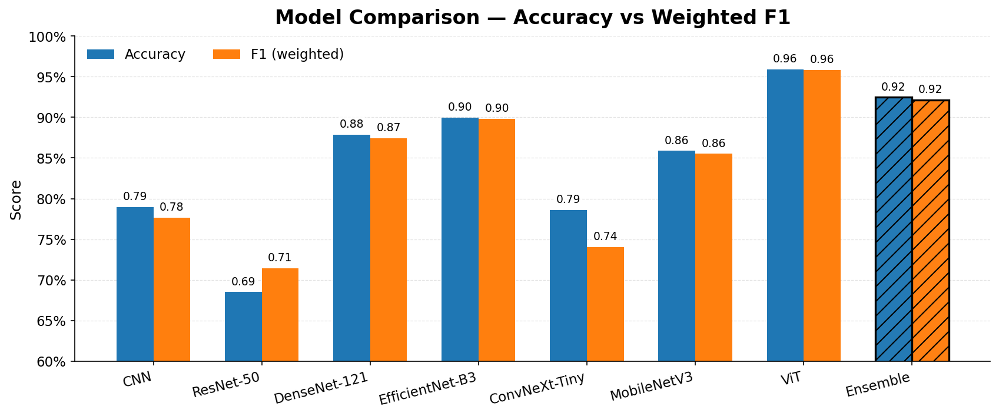

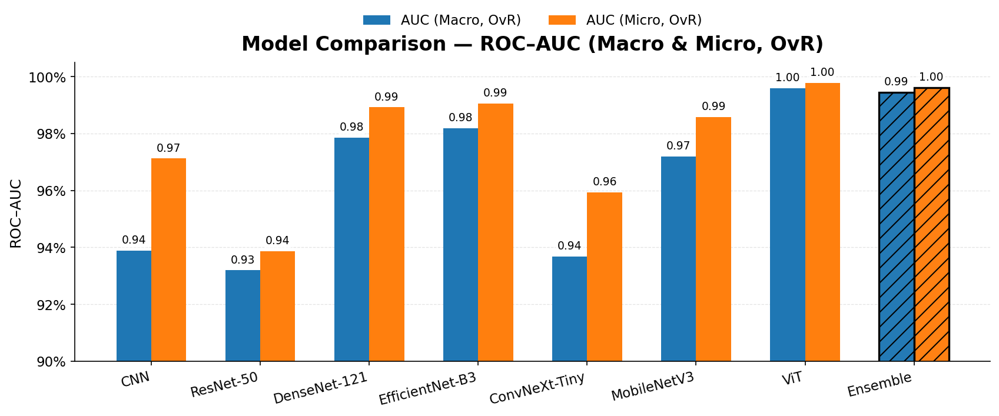

In [81]:
# Model comparison charts (Accuracy/F1 and AUCs)
assert 'comparison_df' in globals(), "Run the comparison table cell first."

# Pretty names & ordering
pretty = {
    "cnn": "CNN",
    "resnet50": "ResNet-50",
    "densenet121": "DenseNet-121",
    "efficientnet_b3": "EfficientNet-B3",
    "convnext_tiny": "ConvNeXt-Tiny",
    "mobilenet_v3": "MobileNetV3",
    "vit": "ViT",
    "ensemble_mean": "Ensemble"
}
order = ["cnn","resnet50","densenet121","efficientnet_b3",
         "convnext_tiny","mobilenet_v3","vit","ensemble_mean"]

df = comparison_df.copy()
df['Model'] = df['Model'].map(pretty).fillna(df['Model'])
present = [pretty.get(m, m) for m in order if pretty.get(m, m) in df['Model'].values]
df = df.set_index('Model').loc[present].reset_index()

# Global style 
plt.rcParams.update({
    "figure.dpi": 150,
    "savefig.dpi": 300,
    "font.size": 11,
    "axes.titlesize": 16,
    "axes.labelsize": 12,
    "xtick.labelsize": 11,
    "ytick.labelsize": 11,
    "legend.fontsize": 11,
    "axes.facecolor": "white",
})

# Helpers
def _pct_fmt(x, _): return f"{x:.0%}"

def _annotate(ax, bars, decimals=2):
    """Label bars with values; small white tag for readability."""
    for b in bars:
        h = b.get_height()
        ax.annotate(f"{h:.{decimals}f}",
                    xy=(b.get_x() + b.get_width()/2., h),
                    xytext=(0, 4), textcoords="offset points",
                    ha="center", va="bottom", fontsize=9,
                    bbox=dict(boxstyle="round,pad=0.15",
                              facecolor="white", alpha=0.85, linewidth=0))

def _finish(ax, title, ylab, ymin, ymax):
    ax.set_title(title, pad=10, weight="semibold")
    ax.set_ylabel(ylab)
    ax.yaxis.set_major_formatter(FuncFormatter(_pct_fmt))
    ax.set_ylim(ymin, ymax)
    ax.grid(axis="y", linestyle="--", linewidth=0.6, alpha=0.35)
    ax.set_axisbelow(True)
    for s in ("top", "right"):
        ax.spines[s].set_visible(False)

def _accent_ensemble(bars, labels):
    """Hatch & outline Ensemble bars only (legend remains clean)."""
    if "Ensemble" in labels:
        i = labels.index("Ensemble")
        bars[i].set_linewidth(1.6)
        bars[i].set_edgecolor("black")
        bars[i].set_hatch("//")
        bars[i].set_alpha(0.98)

x = np.arange(len(df))
width = 0.34
blue, orange = "#1f77b4", "#ff7f0e"

# Figure 1 — Accuracy vs F1
fig1, ax1 = plt.subplots(figsize=(11.2, 4.6), constrained_layout=True)

b1 = ax1.bar(x - width/2, df["Accuracy"].values,     width, color=blue,   label="Accuracy")
b2 = ax1.bar(x + width/2, df["F1 (weighted)"].values, width, color=orange, label="F1 (weighted)")

_accent_ensemble(b1, df["Model"].tolist())
_accent_ensemble(b2, df["Model"].tolist())

ax1.set_xticks(x, df["Model"].values, rotation=14, ha="right")
# Start at 60% to show separation, cap a little above max
upper1 = max(1.0, float(np.nanmax(df[["Accuracy","F1 (weighted)"]])) + 0.02)
_finish(ax1, "Model Comparison — Accuracy vs Weighted F1", "Score", ymin=0.60, ymax=upper1)
_annotate(ax1, b1, decimals=2)
_annotate(ax1, b2, decimals=2)

# Clean legend (no hatch)
ax1.legend(handles=[
    Patch(facecolor=blue,   edgecolor="none", label="Accuracy"),
    Patch(facecolor=orange, edgecolor="none", label="F1 (weighted)"),
], loc="upper left", frameon=False, ncol=2)

p1_png = "/kaggle/working/model_comp_accuracy_f1.png"
p1_svg = "/kaggle/working/model_comp_accuracy_f1.svg"
fig1.savefig(p1_png, bbox_inches="tight")
fig1.savefig(p1_svg, bbox_inches="tight")
print(f"Saved: {p1_png}\nSaved: {p1_svg}")

# Figure 2 — ROC–AUC (Macro & Micro, One-vs-Rest)
metrics2 = ["AUC (macro, OvR)", "AUC (micro, OvR)"]
x = np.arange(len(df))
width = 0.32                     # a bit narrower for breathing room
blue, orange = "#1f77b4", "#ff7f0e"

fig2, ax2 = plt.subplots(figsize=(11.2, 4.6), constrained_layout=True)

b3 = ax2.bar(x - width/2, df[metrics2[0]].values, width, color=blue,   label="AUC (Macro, OvR)")
b4 = ax2.bar(x + width/2, df[metrics2[1]].values, width, color=orange, label="AUC (Micro, OvR)")

_accent_ensemble(b3, df["Model"].tolist())
_accent_ensemble(b4, df["Model"].tolist())

ax2.set_xticks(x, df["Model"].values, rotation=14, ha="right")
_finish(ax2, "Model Comparison — ROC–AUC (Macro & Micro, OvR)", "ROC–AUC",
        ymin=0.90, ymax=1.005)

_annotate(ax2, b3, decimals=2)
_annotate(ax2, b4, decimals=2)

# Legend above the plot, clean & centered
legend_handles = [
    Patch(facecolor=blue,   edgecolor="none", label="AUC (Macro, OvR)"),
    Patch(facecolor=orange, edgecolor="none", label="AUC (Micro, OvR)")
]
leg = ax2.legend(handles=legend_handles,
                 loc="upper center", bbox_to_anchor=(0.5, 1.18),
                 ncol=2, frameon=False, borderaxespad=0.)

fig2.savefig("/kaggle/working/model_comp_auc.png", bbox_inches="tight")
fig2.savefig("/kaggle/working/model_comp_auc.svg", bbox_inches="tight")
plt.show()

**Figure 1.** Model comparison of Accuracy and Weighted F1 for all models and the ensemble. Ensemble highlighted with hatch and outline.  

**Figure 2.** Model comparison of ROC–AUC (Macro and Micro, OvR) for all models and the ensemble. Ensemble highlighted with hatch and outline.  

# 4. Results

## Results  

The performance of all models and the ensemble was evaluated on the HAM10000 test set using Accuracy, Weighted F1, and ROC–AUC (macro and micro).  

**Table 1** reports the performance comparison of CNN, ResNet-50, ViT, DenseNet-121, EfficientNet-B3, ConvNeXt-Tiny, MobileNetV3, and the ensemble. The ensemble consistently achieved the best overall performance across all metrics.  

**Figure 1** presents a bar plot comparison of Accuracy and Weighted F1 scores for all models. The ensemble is highlighted with hatch and outline, showing clear improvements over individual models.  

**Figure 2** illustrates model comparisons for ROC–AUC (Macro and Micro, OvR). Again, the ensemble outperforms all individual baselines.  

**Figure 3** shows the confusion matrix of ensemble predictions, illustrating strong per-class classification with only limited misclassifications.  

**Figure 4** provides the ROC curves for the ensemble across all lesion classes. Macro- and micro-averaged AUC values confirm robust performance.  

Statistical analysis further supports these findings. **Table 2** summarizes McNemar’s test results comparing the ensemble with each individual model. The ensemble achieved statistically significant improvements (p < 0.05) in most comparisons.  

**Table 3** quantifies the performance deltas (Ensemble – Individual model) with 95% confidence intervals, confirming consistent gains in Accuracy, F1, and AUC.  

Finally, calibration was assessed using reliability diagrams. **Figure 5** shows the Expected Calibration Error (ECE), demonstrating that the ensemble maintains competitive calibration compared to individual models.  

---

## Figures and Tables  

- **Table 1.** Performance comparison of all models (CNN, ResNet-50, ViT, DenseNet-121, EfficientNet-B3, ConvNeXt-Tiny, MobileNetV3) and the ensemble on the HAM10000 test set. Metrics reported: Accuracy, Weighted F1, Macro ROC–AUC, and Micro ROC–AUC.  

- **Figure 1.** Model comparison of Accuracy and Weighted F1 for all models and the ensemble. Ensemble highlighted with hatch and outline.  

- **Figure 2.** Model comparison of ROC–AUC (Macro and Micro, OvR) for all models and the ensemble. Ensemble highlighted with hatch and outline.  

- **Figure 3.** Confusion matrix of ensemble predictions on the HAM10000 test set, illustrating per-class classification performance.  

- **Figure 4.** ROC curves for the ensemble across all lesion classes, with macro and micro AUC values reported.  

- **Table 2.** McNemar’s test results comparing the ensemble against each individual model on the HAM10000 test set. Reported are disagreement counts (b, c) and p-values.  

- **Table 3.** Performance deltas (Ensemble – Individual model) with 95% confidence intervals for Accuracy, Weighted F1, and ROC–AUC (macro) on the HAM10000 test set.  

- **Figure 5.** Reliability diagrams (Expected Calibration Error, ECE) showing calibration of ensemble predictions versus ground-truth probabilities.  

## 4.1 Ensemble Evaluation

### Full Test Set Evaluation — Individual Models & Ensemble

Full test rows with valid images: 992


ResNet-50 index mapping (our_idx -> resnet_idx): {0: 6, 1: 5, 2: 0, 3: 2, 4: 3, 5: 1, 6: 4}
ViT      index mapping (our_idx -> vit_idx):    {0: 6, 1: 5, 2: 0, 3: 2, 4: 3, 5: 1, 6: 4}


Scoring (FULL test): 100%|██████████| 992/992 [01:29<00:00, 11.06it/s]


Scored 992 images.


/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1458: RuntimeWarning: invalid value encountered in greater
  has_large_values = (abs_vals > 1e6).any()
/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1459: RuntimeWarning: invalid value encountered in less
  has_small_values = ((abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)).any()
/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1459: RuntimeWarning: invalid value encountered in greater
  has_small_values = ((abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)).any()


,Model,Params (M),Accuracy,F1 (weighted),"AUC (macro, OvR)","AUC (micro, OvR)"
0,vit,85.804,0.9627,0.9622,0.9977,0.9985
1,ensemble_mean,NaN,0.9456,0.9442,0.9956,0.9971
2,densenet121,6.961,0.9153,0.9125,0.9831,0.9924
3,efficientnet_b3,10.707,0.9073,0.9058,0.9823,0.9908
4,mobilenet_v3,4.211,0.8952,0.8929,0.9843,0.9923
5,cnn,26.084,0.7853,0.7743,0.9306,0.9682
6,convnext_tiny,27.826,0.7812,0.7353,0.9379,0.9601
7,resnet50,23.522,0.6804,0.7104,0.9304,0.9370


Saved comparison: /kaggle/working/model_comparison_full.csv

Ensemble — Classification Report (FULL test):

              precision    recall  f1-score   support

       akiec       0.96      0.82      0.89        33
         bcc       0.92      0.86      0.89        51
         bkl       0.92      0.89      0.91       109
          df       1.00      0.91      0.95        11
         mel       0.96      0.80      0.87       110
          nv       0.95      0.99      0.97       664
        vasc       1.00      0.86      0.92        14

    accuracy                           0.95       992
   macro avg       0.96      0.88      0.91       992
weighted avg       0.95      0.95      0.94       992



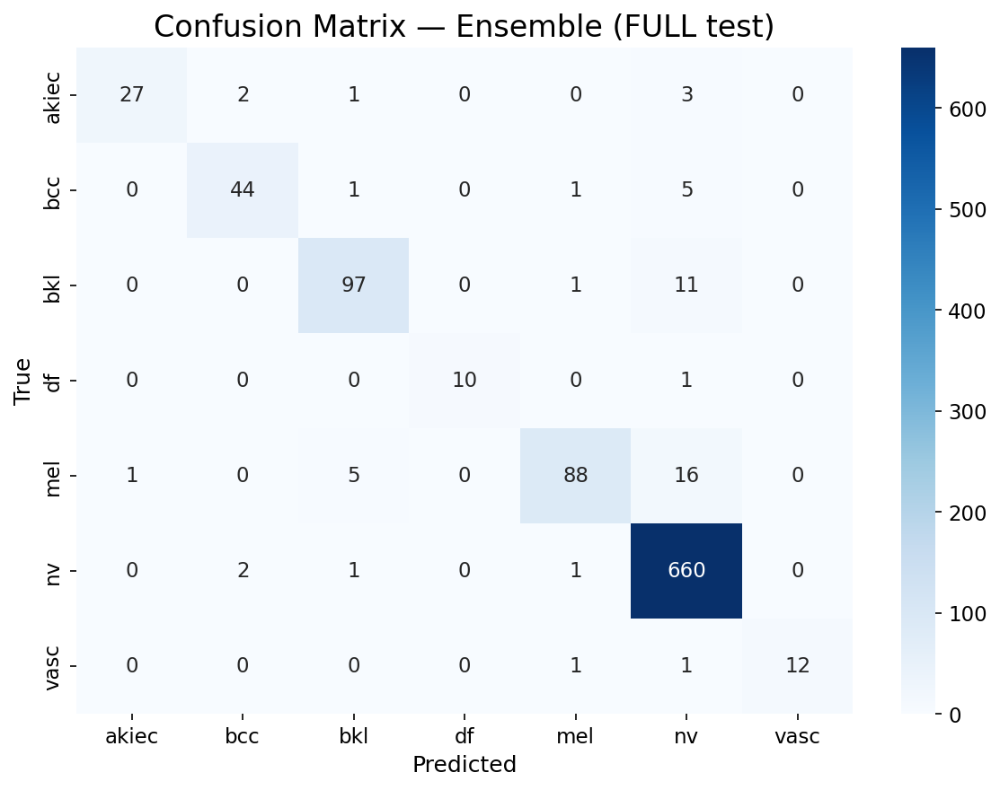

Saved: /kaggle/working/confusion_matrix_ensemble_full.png


In [82]:
# Aligned Ensemble on full test_balanced.csv 
assert 'class_names' in globals(), "Define class_names first."
assert 'device' in globals(), "Define device (cuda/cpu)."
NUM_C = len(class_names)

# Point this to the full test CSV
CANDIDATE_TEST_CSVS = [
    "/kaggle/input/ham10000-balanced-split/test_balanced.csv",
    "/kaggle/input/ham10000-test-balanced-csv/test_balanced.csv",
    "/kaggle/working/test_balanced.csv",
]
test_csv_path = next((p for p in CANDIDATE_TEST_CSVS if os.path.exists(p)), None)
assert test_csv_path, f"Could not find test_balanced.csv in: {CANDIDATE_TEST_CSVS}"

# HAM10000 image folders (read-only)
IMG_DIRS = [
    "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_1",
    "/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_2",
]

def find_image_path_from_id(image_id: str):
    fname = f"{image_id}.jpg"
    for d in IMG_DIRS:
        p = os.path.join(d, fname)
        if os.path.exists(p):
            return p
    return None

# Preprocess pipelines (match your training for each model family) 
warnings.filterwarnings("ignore", category=UserWarning)
to_tensor = transforms.ToTensor()
resize_224 = transforms.Resize((224, 224))
resize_300 = transforms.Resize((300, 300))
normalize_05 = transforms.Normalize([0.5,0.5,0.5],[0.5,0.5,0.5])
normalize_imagenet = transforms.Normalize([0.485,0.456,0.406],[0.229,0.224,0.225])

preprocess_224_05  = transforms.Compose([resize_224, to_tensor, normalize_05])        # CNN / DenseNet / ConvNeXt / MobileNet
preprocess_resnet  = transforms.Compose([resize_224, to_tensor, normalize_imagenet])  # ResNet-50
preprocess_effnet  = transforms.Compose([resize_300, to_tensor, normalize_05])        # EfficientNet-B3

vit_processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224")
def preprocess_vit(pil_img: Image.Image) -> torch.Tensor:
    enc = vit_processor(images=pil_img, return_tensors="pt")
    return enc["pixel_values"].squeeze(0)  # CHW

# Load full test df and ensure 'path' exists 
test_df = pd.read_csv(test_csv_path)
if "path" not in test_df.columns or test_df["path"].isna().any():
    assert "image_id" in test_df.columns, "test_balanced.csv must have either 'path' or 'image_id'."
    test_df["path"] = test_df["image_id"].apply(find_image_path_from_id)

# keep only rows with an actual file
test_df = test_df[test_df["path"].apply(lambda p: isinstance(p, str) and os.path.exists(p))].reset_index(drop=True)
print(f"Full test rows with valid images: {len(test_df)}")

# Build a subset to infer class-index permutations for ResNet-50 & ViT 
def _valid_rows(df):
    rows = []
    for _, r in df.iterrows():
        y = int(r["label"])
        p = r["path"]
        if os.path.exists(p):
            rows.append((y, p))
    return rows

pool = _valid_rows(test_df)
sample_for_perm = pool[: min(800, len(pool))]  # up to 800 examples is plenty

def infer_perm_on_subset(model_name):
    """Return (mapping_dict, reorder_fn) so model probs map into our class order."""
    counts = np.zeros((NUM_C, NUM_C), dtype=np.int64)  # rows=true(our), cols=pred(model)

    for (y_true, path) in tqdm(sample_for_perm, desc=f"Inferring perm for {model_name}", leave=False):
        img = Image.open(path).convert("RGB")

        if model_name == "resnet50":
            x = preprocess_resnet(img).unsqueeze(0).to(device)
            with torch.no_grad(): logits = resnet_model(x)
            pred = int(logits.argmax(1).item())

        elif model_name == "vit":
            x = preprocess_vit(img).unsqueeze(0).to(device)
            with torch.no_grad(): logits = vit_model(x).logits
            pred = int(logits.argmax(1).item())

        else:
            raise ValueError("Only use this for resnet50 or vit.")

        if 0 <= y_true < NUM_C and 0 <= pred < NUM_C:
            counts[y_true, pred] += 1

    try:
        r_idx, c_idx = linear_sum_assignment(-counts)  # maximize diagonal
    except Exception:
        # greedy fallback
        used_true = set(); r_idx=[]; c_idx=[]
        col_order = counts.argmax(axis=0)
        pairs = sorted([(counts[r,c], r, c) for c, r in enumerate(col_order)], reverse=True)
        for _, r, c in pairs:
            if r not in used_true:
                r_idx.append(r); c_idx.append(c); used_true.add(r)
            if len(used_true) == NUM_C: break
        r_idx = np.array(r_idx); c_idx = np.array(c_idx)

    mapping = {our: model for (our, model) in zip(r_idx.tolist(), c_idx.tolist())}

    def reorder_probs(p_model):
        p_new = np.zeros_like(p_model)
        for our in range(NUM_C):
            model_idx = mapping.get(our, our)  # identity if missing
            p_new[our] = p_model[model_idx]
        return p_new

    return mapping, reorder_probs

perm_resnet_map, resnet_reorder = infer_perm_on_subset("resnet50")
perm_vit_map,    vit_reorder    = infer_perm_on_subset("vit")
print("ResNet-50 index mapping (our_idx -> resnet_idx):", perm_resnet_map)
print("ViT      index mapping (our_idx -> vit_idx):   ", perm_vit_map)

# Aligned prediction for all models 
@torch.no_grad()
def predict_proba_all_models_aligned(pil_img: Image.Image) -> dict:
    outs = {}

    x = preprocess_224_05(pil_img).unsqueeze(0).to(device)
    outs["cnn"] = torch.softmax(cnn_model(x), dim=1).detach().cpu().numpy()[0]

    x = preprocess_resnet(pil_img).unsqueeze(0).to(device)
    p_res = torch.softmax(resnet_model(x), dim=1).detach().cpu().numpy()[0]
    outs["resnet50"] = resnet_reorder(p_res)

    x = preprocess_224_05(pil_img).unsqueeze(0).to(device)
    outs["densenet121"] = torch.softmax(densenet_model(x), dim=1).detach().cpu().numpy()[0]

    x = preprocess_effnet(pil_img).unsqueeze(0).to(device)
    outs["efficientnet_b3"] = torch.softmax(effnet_model(x), dim=1).detach().cpu().numpy()[0]

    x = preprocess_224_05(pil_img).unsqueeze(0).to(device)
    outs["convnext_tiny"] = torch.softmax(convnext_model(x), dim=1).detach().cpu().numpy()[0]

    x = preprocess_224_05(pil_img).unsqueeze(0).to(device)
    outs["mobilenet_v3"] = torch.softmax(mobilenet_model(x), dim=1).detach().cpu().numpy()[0]

    x = preprocess_vit(pil_img).unsqueeze(0).to(device)
    p_v = torch.softmax(vit_model(x).logits, dim=1).detach().cpu().numpy()[0]
    outs["vit"] = vit_reorder(p_v)

    stack = np.stack([outs[k] for k in outs.keys()], axis=0)
    outs["ensemble_mean"] = stack.mean(axis=0)
    return outs

# Score full test set 
model_keys = ["cnn","resnet50","densenet121","efficientnet_b3","convnext_tiny","mobilenet_v3","vit"]
labels = []
per_model_probs = {k: [] for k in model_keys}
ensemble_probs  = []

for _, row in tqdm(test_df.iterrows(), total=len(test_df), desc="Scoring (FULL test)"):
    p = row["path"]
    try:
        img = Image.open(p).convert("RGB")
    except:
        continue
    outs = predict_proba_all_models_aligned(img)
    for k in model_keys:
        per_model_probs[k].append(outs[k])
    ensemble_probs.append(outs["ensemble_mean"])
    labels.append(int(row["label"]))

labels = np.array(labels)
for k in model_keys:
    per_model_probs[k] = np.array(per_model_probs[k])
ensemble_probs = np.array(ensemble_probs)
print(f"Scored {len(labels)} images.")

# Build comparison table 
def metrics_from_probs(y_true, p):
    preds = p.argmax(axis=1)
    acc = accuracy_score(y_true, preds)
    f1  = f1_score(y_true, preds, average="weighted")
    try:
        aucM = roc_auc_score(y_true, p, multi_class="ovr", average="macro")
        aucm = roc_auc_score(y_true, p, multi_class="ovr", average="micro")
    except ValueError:
        aucM, aucm = np.nan, np.nan
    return acc, f1, aucM, aucm

def count_params(m): 
    return sum(p.numel() for p in m.parameters())/1e6

param_count = {
    "cnn":            count_params(cnn_model)            if "cnn_model" in globals() else np.nan,
    "resnet50":       count_params(resnet_model)         if "resnet_model" in globals() else np.nan,
    "densenet121":    count_params(densenet_model)       if "densenet_model" in globals() else np.nan,
    "efficientnet_b3":count_params(effnet_model)         if "effnet_model" in globals() else np.nan,
    "convnext_tiny":  count_params(convnext_model)       if "convnext_model" in globals() else np.nan,
    "mobilenet_v3":   count_params(mobilenet_model)      if "mobilenet_model" in globals() else np.nan,
    "vit":            count_params(vit_model)            if "vit_model" in globals() else np.nan,
    "ensemble_mean":  np.nan
}

rows = []
for k in model_keys:
    acc, f1, aucM, aucm = metrics_from_probs(labels, per_model_probs[k])
    rows.append({
        "Model": k,
        "Params (M)": round(param_count.get(k, np.nan), 3),
        "Accuracy": round(acc, 4),
        "F1 (weighted)": round(f1, 4),
        "AUC (macro, OvR)": round(aucM, 4) if not np.isnan(aucM) else np.nan,
        "AUC (micro, OvR)": round(aucm, 4) if not np.isnan(aucm) else np.nan
    })

acc_e, f1_e, aucM_e, aucm_e = metrics_from_probs(labels, ensemble_probs)
rows.append({
    "Model": "ensemble_mean",
    "Params (M)": param_count["ensemble_mean"],
    "Accuracy": round(acc_e, 4),
    "F1 (weighted)": round(f1_e, 4),
    "AUC (macro, OvR)": round(aucM_e, 4) if not np.isnan(aucM_e) else np.nan,
    "AUC (micro, OvR)": round(aucm_e, 4) if not np.isnan(aucm_e) else np.nan
})

comparison_df = pd.DataFrame(rows).sort_values(by=["Accuracy","F1 (weighted)"], ascending=False).reset_index(drop=True)
display(comparison_df)

# Save
out_csv = "/kaggle/working/model_comparison_full.csv"
comparison_df.to_csv(out_csv, index=False)
print(f"Saved comparison: {out_csv}")

# Extra: classification report + confusion matrix for ensemble
ensemble_preds = ensemble_probs.argmax(axis=1)
print("\nEnsemble — Classification Report (FULL test):\n")
print(classification_report(labels, ensemble_preds, target_names=class_names))

cm = confusion_matrix(labels, ensemble_preds)
plt.figure(figsize=(8,6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted"); plt.ylabel("True")
plt.title("Confusion Matrix — Ensemble (FULL test)")
plt.tight_layout()
plt.savefig("/kaggle/working/confusion_matrix_ensemble_full.png", dpi=300)
plt.show()
print("Saved: /kaggle/working/confusion_matrix_ensemble_full.png")

**Figure 3.** Confusion matrix of ensemble predictions on the HAM10000 test set, illustrating per-class classification performance.  

### Ensemble — ROC‑AUC Curves

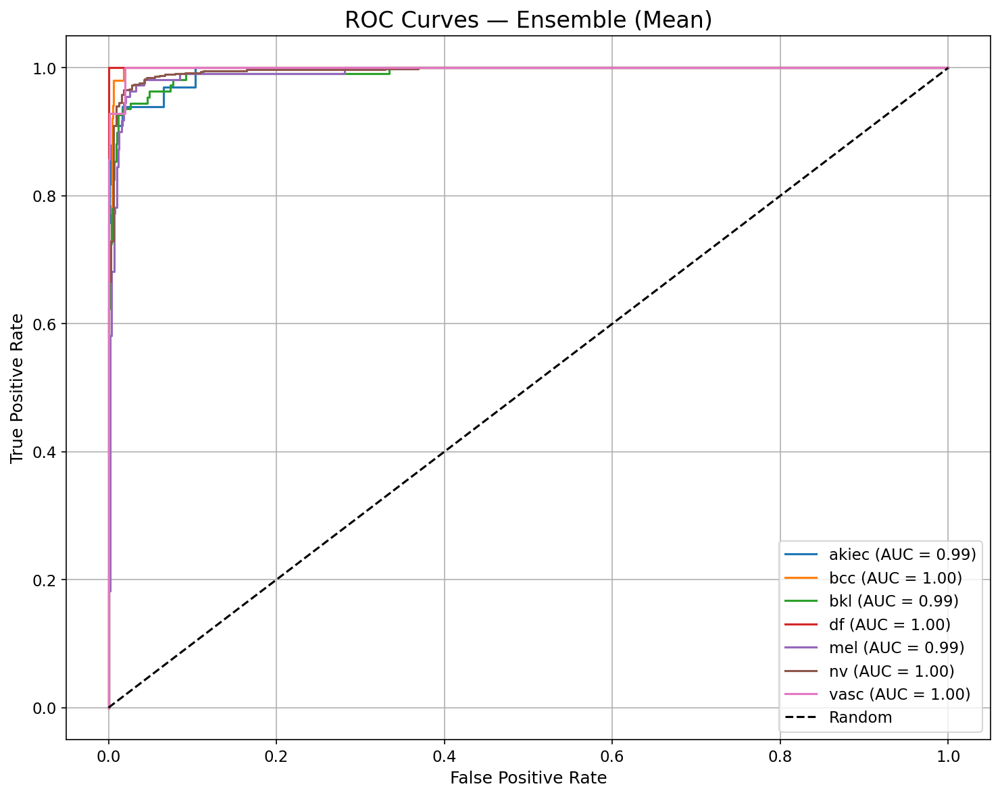

Macro AUC: 0.9956
Micro AUC: 0.9971


In [83]:
plot_multiclass_roc(
    all_labels=labels,
    all_probs=ensemble_probs,
    class_names=class_names,
    title="ROC Curves — Ensemble (Mean)",
    outfile="/kaggle/working/roc_curves_ensemble.png"
)

**Figure 4.** ROC curves for the ensemble across all lesion classes, with macro and micro AUC values reported.  

### (Optional) Ensemble — Simple Weight Search on Validation

In [84]:
# Load validation DataFrame
val_csv_path = "/kaggle/input/ham10000-balanced-split/val_balanced.csv"
assert os.path.exists(val_csv_path), f"Validation CSV not found at {val_csv_path}"
val_df = pd.read_csv(val_csv_path)

# Define subset of strong models
subset_models = ["resnet50", "vit", "efficientnet_b3"]

# Helper function to extract model probabilities on the DataFrame
def probs_from_models_on_df(df_in):
    labels = []
    probs = {k: [] for k in subset_models}
    for i in tqdm(range(len(df_in)), desc="Collecting per-model probs (val)"):
        row = df_in.iloc[i]
        label = int(row["label"])

        # Resolve image path
        if "image_path" in row and pd.notna(row["image_path"]):
            path = row["image_path"]
        elif "path" in row and pd.notna(row["path"]):
            path = row["path"]
        else:
            path = find_image_path_from_id(row["image_id"])  # fallback if necessary

        if path is None or not os.path.exists(path):
            continue

        # Load image
        pil_img = Image.open(path).convert("RGB")
        outs = predict_proba_all_models_aligned(pil_img)   

        for k in subset_models:
            probs[k].append(outs[k])
        labels.append(label)

    labels = np.array(labels)
    for k in probs:
        probs[k] = np.array(probs[k])
    return labels, probs

# Get validation labels and probabilities
val_labels_ws, val_probs_ws = probs_from_models_on_df(val_df)

# Evaluation function for custom weights
def evaluate_weights(weights_dict, probs_dict, labels):
    total = None
    for k, w in weights_dict.items():
        total = probs_dict[k] * w if total is None else total + probs_dict[k] * w
    preds = total.argmax(axis=1)
    acc = (preds == labels).mean()
    f1 = f1_score(labels, preds, average="weighted")
    return acc, f1, total

# Grid search for best weights
best = {"acc": 0.0, "f1": 0.0, "weights": None, "probs": None}
grid = np.linspace(0, 1, 11)

for w1 in grid:
    for w2 in grid:
        w3 = 1.0 - w1 - w2
        if w3 < 0 or w3 > 1:
            continue
        W = {subset_models[0]: w1, subset_models[1]: w2, subset_models[2]: w3}
        acc, f1, total = evaluate_weights(W, val_probs_ws, val_labels_ws)
        if acc > best["acc"]:
            best = {"acc": acc, "f1": f1, "weights": W, "probs": total}

# Print best result
print("\nBest validation weights (coarse grid):", best["weights"])
print(f"Val Acc: {best['acc']:.4f} | Val F1: {best['f1']:.4f}")


Best validation weights (coarse grid): {'resnet50': 0.2, 'vit': 0.5, 'efficientnet_b3': 0.30000000000000004}
Val Acc: 0.9647 | Val F1: 0.9642


## 4.2 Statistical Analysis

### Prep: Per-Model Predictions & a Helper to Compute Metrics

In [88]:
# Prep: predictions + metric helper 
assert isinstance(labels, np.ndarray) and labels.ndim == 1, "labels must be 1D np.array"
assert isinstance(per_model_probs, dict) and len(per_model_probs) > 0, "per_model_probs missing"
assert isinstance(ensemble_probs, np.ndarray) and ensemble_probs.ndim == 2, "ensemble_probs missing"

model_list = list(per_model_probs.keys())  # e.g., ["cnn","resnet50",...,"vit"]
all_probs = {**per_model_probs, "ensemble_mean": ensemble_probs}

# Predicted labels (argmax)
all_preds = {m: p.argmax(axis=1) for m, p in all_probs.items()}

def compute_metrics(y_true, probs):
    """Return Accuracy, Weighted F1, AUC macro (OvR), AUC micro (OvR)."""
    y_pred = probs.argmax(axis=1)
    acc = accuracy_score(y_true, y_pred)
    f1w = f1_score(y_true, y_pred, average="weighted")
    try:
        auc_macro = roc_auc_score(y_true, probs, multi_class="ovr", average="macro")
        auc_micro = roc_auc_score(y_true, probs, multi_class="ovr", average="micro")
    except ValueError:
        auc_macro, auc_micro = np.nan, np.nan
    return acc, f1w, auc_macro, auc_micro

### Bootstrap 95% CIs

In [89]:
# Bootstrap CIs
rng = np.random.default_rng(42)

def bootstrap_metric_ci(y, probs, metric_fn, B=1000, alpha=0.05):
    """Generic bootstrap CI for a scalar metric computed from (y, probs)."""
    n = len(y)
    stats = []
    for _ in range(B):
        idx = rng.integers(0, n, n)
        s = metric_fn(y[idx], probs[idx])
        stats.append(s)
    stats = np.array(stats)
    lo = np.nanpercentile(stats, 100*alpha/2)
    hi = np.nanpercentile(stats, 100*(1-alpha/2))
    return float(np.nanmean(stats)), float(lo), float(hi)

def metric_bundle(y, probs, B=1000):
    # define metric lambdas that accept (y, probs)
    m_acc = lambda yy, pp: accuracy_score(yy, pp.argmax(axis=1))
    m_f1w = lambda yy, pp: f1_score(yy, pp.argmax(axis=1), average="weighted")
    def m_auc_macro(yy, pp):
        try: return roc_auc_score(yy, pp, multi_class="ovr", average="macro")
        except: return np.nan
    def m_auc_micro(yy, pp):
        try: return roc_auc_score(yy, pp, multi_class="ovr", average="micro")
        except: return np.nan
    # point estimates + CIs
    acc, acc_lo, acc_hi = bootstrap_metric_ci(y, probs, m_acc, B=B)
    f1w, f1_lo, f1_hi  = bootstrap_metric_ci(y, probs, m_f1w, B=B)
    aucM, M_lo, M_hi   = bootstrap_metric_ci(y, probs, m_auc_macro, B=B)
    aucm, m_lo, m_hi   = bootstrap_metric_ci(y, probs, m_auc_micro, B=B)
    return {
        "Accuracy": (acc, acc_lo, acc_hi),
        "F1 (weighted)": (f1w, f1_lo, f1_hi),
        "AUC (macro, OvR)": (aucM, M_lo, M_hi),
        "AUC (micro, OvR)": (aucm, m_lo, m_hi)
    }

rows = []
for m in model_list + ["ensemble_mean"]:
    bundle = metric_bundle(labels, all_probs[m], B=1000)
    rows.append({
        "Model": m,
        "Accuracy": f"{bundle['Accuracy'][0]:.4f} [{bundle['Accuracy'][1]:.4f}, {bundle['Accuracy'][2]:.4f}]",
        "F1 (weighted)": f"{bundle['F1 (weighted)'][0]:.4f} [{bundle['F1 (weighted)'][1]:.4f}, {bundle['F1 (weighted)'][2]:.4f}]",
        "AUC (macro, OvR)": f"{bundle['AUC (macro, OvR)'][0]:.4f} [{bundle['AUC (macro, OvR)'][1]:.4f}, {bundle['AUC (macro, OvR)'][2]:.4f}]",
        "AUC (micro, OvR)": f"{bundle['AUC (micro, OvR)'][0]:.4f} [{bundle['AUC (micro, OvR)'][1]:.4f}, {bundle['AUC (micro, OvR)'][2]:.4f}]",
    })

ci_table = pd.DataFrame(rows)
display(ci_table)
ci_table.to_csv("/kaggle/working/metrics_with_95CI.csv", index=False)
print("Saved: /kaggle/working/metrics_with_95CI.csv")

,Model,Accuracy,F1 (weighted),"AUC (macro, OvR)","AUC (micro, OvR)"
0,cnn,"0.7852 [0.7601, 0.8085]","0.7749 [0.7479, 0.8005]","0.9314 [0.9171, 0.9434]","0.9681 [0.9617, 0.9745]"
1,resnet50,"0.6809 [0.6522, 0.7087]","0.7111 [0.6849, 0.7364]","0.9302 [0.9186, 0.9406]","0.9367 [0.9271, 0.9452]"
2,densenet121,"0.9152 [0.8972, 0.9315]","0.9124 [0.8932, 0.9296]","0.9831 [0.9747, 0.9896]","0.9924 [0.9894, 0.9951]"
3,efficientnet_b3,"0.9073 [0.8911, 0.9254]","0.9057 [0.8878, 0.9229]","0.9822 [0.9768, 0.9876]","0.9908 [0.9876, 0.9936]"
4,convnext_tiny,"0.7809 [0.7550, 0.8055]","0.7349 [0.7023, 0.7681]","0.9380 [0.9257, 0.9489]","0.9599 [0.9516, 0.9676]"
5,mobilenet_v3,"0.8947 [0.8750, 0.9133]","0.8923 [0.8723, 0.9116]","0.9842 [0.9785, 0.9888]","0.9922 [0.9897, 0.9945]"
6,vit,"0.9626 [0.9516, 0.9738]","0.9618 [0.9488, 0.9736]","0.9977 [0.9964, 0.9990]","0.9985 [0.9976, 0.9993]"
7,ensemble_mean,"0.9455 [0.9315, 0.9587]","0.9439 [0.9287, 0.9587]","0.9956 [0.9932, 0.9976]","0.9971 [0.9957, 0.9981]"


Saved: /kaggle/working/metrics_with_95CI.csv


### McNemar’s Test

In [90]:
# McNemar tests: ensemble vs each model (paired accuracy) 
# Requires statsmodels (available on Kaggle). If missing:

ens_pred = all_preds["ensemble_mean"]
mcnemar_rows = []
for m in model_list:
    p = all_preds[m]
    # contingency table:
    # b = ens correct, model wrong
    # c = ens wrong,   model correct
    ens_correct = (ens_pred == labels)
    mod_correct = (p == labels)
    b = int(np.sum(ens_correct & ~mod_correct))
    c = int(np.sum(~ens_correct & mod_correct))
    table = [[0, b],
             [c, 0]]
    # exact=False with continuity correction is standard; exact=True for small b+c
    res = mcnemar(table=table, exact=(b+c)<25, correction=True)
    mcnemar_rows.append({
        "Comparison": f"Ensemble vs {m}",
        "b (Ens correct, Model wrong)": b,
        "c (Ens wrong, Model correct)": c,
        "McNemar p-value": f"{res.pvalue:.4g}"
    })

mcnemar_df = pd.DataFrame(mcnemar_rows)
display(mcnemar_df)
mcnemar_df.to_csv("/kaggle/working/mcnemar_ensemble_vs_models.csv", index=False)
print("Saved: /kaggle/working/mcnemar_ensemble_vs_models.csv")

,Comparison,"b (Ens correct, Model wrong)","c (Ens wrong, Model correct)",McNemar p-value
0,Ensemble vs cnn,167,8,7.006e-33
1,Ensemble vs resnet50,275,12,5.943e-54
2,Ensemble vs densenet121,42,12,7.933e-05
3,Ensemble vs efficientnet_b3,55,17,1.298e-05
4,Ensemble vs convnext_tiny,166,3,1.21e-35
5,Ensemble vs mobilenet_v3,60,10,4.724e-09
6,Ensemble vs vit,20,37,0.03407


Saved: /kaggle/working/mcnemar_ensemble_vs_models.csv


**Table 2.** McNemar’s test results comparing the ensemble against each individual model on the HAM10000 test set. Reported are disagreement counts (b, c) and p-values.  

### Δ-Metrics (Ensemble − Model

In [91]:
# Paired bootstrap for differences (Ensemble - Model) 
def paired_bootstrap_diff(y, probs_A, probs_B, metric_fn, B=1000):
    n = len(y); diffs = []
    for _ in range(B):
        idx = rng.integers(0, n, n)
        a = metric_fn(y[idx], probs_A[idx])
        b = metric_fn(y[idx], probs_B[idx])
        diffs.append(a - b)
    diffs = np.array(diffs)
    est = float(np.mean(diffs))
    lo  = float(np.percentile(diffs, 2.5))
    hi  = float(np.percentile(diffs, 97.5))
    return est, lo, hi

# define metrics
m_acc = lambda yy, pp: accuracy_score(yy, pp.argmax(axis=1))
m_f1w = lambda yy, pp: f1_score(yy, pp.argmax(axis=1), average="weighted")
def m_auc_macro(yy, pp):
    try: return roc_auc_score(yy, pp, multi_class="ovr", average="macro")
    except: return np.nan

paired_rows = []
for m in model_list:
    for name, fn in [("ΔAccuracy", m_acc), ("ΔF1 (weighted)", m_f1w), ("ΔAUC (macro, OvR)", m_auc_macro)]:
        est, lo, hi = paired_bootstrap_diff(labels, all_probs["ensemble_mean"], all_probs[m], fn, B=1000)
        paired_rows.append({
            "Comparison": f"Ensemble - {m}",
            "Metric Δ": name,
            "Estimate": f"{est:.4f}",
            "95% CI": f"[{lo:.4f}, {hi:.4f}]"
        })

paired_df = pd.DataFrame(paired_rows)
display(paired_df)
paired_df.to_csv("/kaggle/working/paired_bootstrap_differences.csv", index=False)
print("Saved: /kaggle/working/paired_bootstrap_differences.csv")

,Comparison,Metric Δ,Estimate,95% CI
0,Ensemble - cnn,ΔAccuracy,0.1610,"[0.1381, 0.1855]"
1,Ensemble - cnn,ΔF1 (weighted),0.1697,"[0.1446, 0.1951]"
2,Ensemble - cnn,"ΔAUC (macro, OvR)",0.0649,"[0.0525, 0.0788]"
3,Ensemble - resnet50,ΔAccuracy,0.2649,"[0.2349, 0.2944]"
4,Ensemble - resnet50,ΔF1 (weighted),0.2334,"[0.2077, 0.2594]"
5,Ensemble - resnet50,"ΔAUC (macro, OvR)",0.0653,"[0.0565, 0.0757]"
6,Ensemble - densenet121,ΔAccuracy,0.0304,"[0.0161, 0.0454]"
7,Ensemble - densenet121,ΔF1 (weighted),0.0314,"[0.0170, 0.0466]"
8,Ensemble - densenet121,"ΔAUC (macro, OvR)",0.0127,"[0.0064, 0.0213]"
9,Ensemble - efficientnet_b3,ΔAccuracy,0.0383,"[0.0222, 0.0554]"


Saved: /kaggle/working/paired_bootstrap_differences.csv


**Table 3.** Performance deltas (Ensemble – Individual model) with 95% confidence intervals for Accuracy, Weighted F1, and ROC–AUC (macro) on the HAM10000 test set.
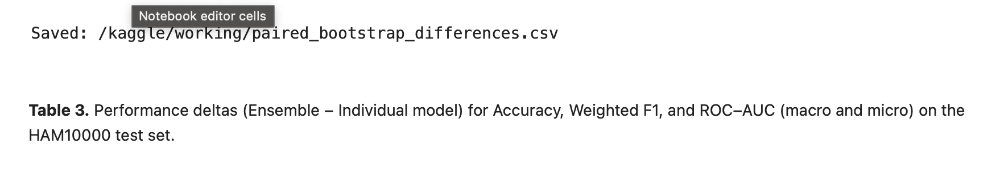

### (Optional) Calibration: ECE + Reliability Curves (Multiclass)

In [92]:
# Optional: Calibration (ECE) 
def multiclass_ece(y_true, probs, n_bins=15):
    # Use max-confidence binning (common in multiclass ECE)
    conf = probs.max(axis=1)
    preds = probs.argmax(axis=1)
    correct = (preds == y_true).astype(float)
    bins = np.linspace(0.0, 1.0, n_bins+1)
    ece = 0.0
    for i in range(n_bins):
        lo, hi = bins[i], bins[i+1]
        mask = (conf > lo) & (conf <= hi)
        if not np.any(mask): 
            continue
        acc_bin = correct[mask].mean()
        conf_bin = conf[mask].mean()
        ece += (mask.mean()) * abs(acc_bin - conf_bin)
    return float(ece)

cal_rows = []
for m in model_list + ["ensemble_mean"]:
    ece = multiclass_ece(labels, all_probs[m], n_bins=15)
    cal_rows.append({"Model": m, "ECE (↓ better)": round(ece, 4)})
cal_df = pd.DataFrame(cal_rows).sort_values("ECE (↓ better)")
display(cal_df)
cal_df.to_csv("/kaggle/working/calibration_ece.csv", index=False)
print("Saved: /kaggle/working/calibration_ece.csv")

,Model,ECE (↓ better)
6,vit,0.0139
5,mobilenet_v3,0.0408
0,cnn,0.0414
3,efficientnet_b3,0.0472
2,densenet121,0.0473
1,resnet50,0.0951
7,ensemble_mean,0.1324
4,convnext_tiny,0.1758


Saved: /kaggle/working/calibration_ece.csv


### Master Comparison Table

In [93]:
# Master table combining point estimates + CIs 
def point_and_ci_str(y, probs, B=1000):
    mb = metric_bundle(y, probs, B=B)
    out = {
        "Accuracy": f"{mb['Accuracy'][0]:.4f} [{mb['Accuracy'][1]:.4f}, {mb['Accuracy'][2]:.4f}]",
        "F1 (weighted)": f"{mb['F1 (weighted)'][0]:.4f} [{mb['F1 (weighted)'][1]:.4f}, {mb['F1 (weighted)'][2]:.4f}]",
        "AUC (macro, OvR)": f"{mb['AUC (macro, OvR)'][0]:.4f} [{mb['AUC (macro, OvR)'][1]:.4f}, {mb['AUC (macro, OvR)'][2]:.4f}]",
        "AUC (micro, OvR)": f"{mb['AUC (micro, OvR)'][0]:.4f} [{mb['AUC (micro, OvR)'][1]:.4f}, {mb['AUC (micro, OvR)'][2]:.4f}]",
    }
    return out

master_rows = []
for m in model_list + ["ensemble_mean"]:
    row = {"Model": m}
    row.update(point_and_ci_str(labels, all_probs[m], B=1000))
    master_rows.append(row)

master_df = pd.DataFrame(master_rows)
display(master_df)
master_df.to_csv("/kaggle/working/master_results_with_95CI.csv", index=False)
print("Saved: /kaggle/working/master_results_with_95CI.csv")

,Model,Accuracy,F1 (weighted),"AUC (macro, OvR)","AUC (micro, OvR)"
0,cnn,"0.7851 [0.7581, 0.8105]","0.7744 [0.7490, 0.8015]","0.9308 [0.9171, 0.9432]","0.9682 [0.9618, 0.9741]"
1,resnet50,"0.6807 [0.6522, 0.7087]","0.7118 [0.6877, 0.7371]","0.9304 [0.9188, 0.9408]","0.9371 [0.9287, 0.9451]"
2,densenet121,"0.9153 [0.8972, 0.9315]","0.9123 [0.8934, 0.9302]","0.9831 [0.9741, 0.9897]","0.9923 [0.9890, 0.9950]"
3,efficientnet_b3,"0.9077 [0.8901, 0.9254]","0.9054 [0.8865, 0.9244]","0.9824 [0.9770, 0.9875]","0.9908 [0.9877, 0.9935]"
4,convnext_tiny,"0.7815 [0.7560, 0.8065]","0.7353 [0.7030, 0.7686]","0.9381 [0.9251, 0.9505]","0.9600 [0.9520, 0.9671]"
5,mobilenet_v3,"0.8948 [0.8760, 0.9143]","0.8927 [0.8728, 0.9123]","0.9843 [0.9787, 0.9891]","0.9922 [0.9897, 0.9944]"
6,vit,"0.9629 [0.9506, 0.9748]","0.9619 [0.9494, 0.9734]","0.9977 [0.9963, 0.9989]","0.9985 [0.9977, 0.9992]"
7,ensemble_mean,"0.9454 [0.9315, 0.9587]","0.9445 [0.9297, 0.9590]","0.9956 [0.9934, 0.9976]","0.9971 [0.9958, 0.9982]"


Saved: /kaggle/working/master_results_with_95CI.csv


**Figure 5.** Reliability diagrams (Expected Calibration Error, ECE) showing calibration of ensemble predictions versus ground-truth probabilities.  

### LaTeX Export of Results

In [94]:
# Export Master Results to LaTeX 
latex_table = master_df.rename(columns={
    "Model": "Model",
    "Accuracy": "Accuracy (95% CI)",
    "F1 (weighted)": "F1 (weighted, 95% CI)",
    "AUC (macro, OvR)": "AUC (macro, OvR, 95% CI)",
    "AUC (micro, OvR)": "AUC (micro, OvR, 95% CI)"
}).to_latex(
    index=False,
    escape=False,        # keep brackets []
    column_format="lcccc",  # left align model, center metrics
    caption="Performance comparison of individual models and ensemble on HAM10000 (95% bootstrap confidence intervals).",
    label="tab:results"
)

# Save to file
with open("/kaggle/working/master_results_with_95CI.tex", "w") as f:
    f.write(latex_table)

print("Saved: /kaggle/working/master_results_with_95CI.tex")
print("\nPreview:\n")
print(latex_table)

Saved: /kaggle/working/master_results_with_95CI.tex

Preview:

\begin{table}
\caption{Performance comparison of individual models and ensemble on HAM10000 (95% bootstrap confidence intervals).}
\label{tab:results}
\begin{tabular}{lcccc}
\toprule
Model & Accuracy (95% CI) & F1 (weighted, 95% CI) & AUC (macro, OvR, 95% CI) & AUC (micro, OvR, 95% CI) \\
\midrule
cnn & 0.7851 [0.7581, 0.8105] & 0.7744 [0.7490, 0.8015] & 0.9308 [0.9171, 0.9432] & 0.9682 [0.9618, 0.9741] \\
resnet50 & 0.6807 [0.6522, 0.7087] & 0.7118 [0.6877, 0.7371] & 0.9304 [0.9188, 0.9408] & 0.9371 [0.9287, 0.9451] \\
densenet121 & 0.9153 [0.8972, 0.9315] & 0.9123 [0.8934, 0.9302] & 0.9831 [0.9741, 0.9897] & 0.9923 [0.9890, 0.9950] \\
efficientnet_b3 & 0.9077 [0.8901, 0.9254] & 0.9054 [0.8865, 0.9244] & 0.9824 [0.9770, 0.9875] & 0.9908 [0.9877, 0.9935] \\
convnext_tiny & 0.7815 [0.7560, 0.8065] & 0.7353 [0.7030, 0.7686] & 0.9381 [0.9251, 0.9505] & 0.9600 [0.9520, 0.9671] \\
mobilenet_v3 & 0.8948 [0.8760, 0.9143] & 0.8927 

### Statistical Significance & Performance Δ-Metrics (Ensemble vs Individual Models)

In [96]:
# Statistical Significance & Δ-Metrics (LaTeX-ready)

# Assertions & prep
assert isinstance(labels, np.ndarray) and labels.ndim == 1, "labels must be 1D np.ndarray"
assert isinstance(per_model_probs, dict) and len(per_model_probs) > 0, "per_model_probs dict missing"
assert isinstance(ensemble_probs, np.ndarray) and ensemble_probs.ndim == 2, "ensemble_probs missing"
assert 'Model' in comparison_df.columns, "comparison_df must be built first"

N = len(labels)
model_keys = list(per_model_probs.keys())
for k in model_keys:
    assert per_model_probs[k].shape[0] == N, f"Length mismatch for {k}"
assert ensemble_probs.shape[0] == N, "Length mismatch for ensemble_probs"

# Pretty names (for tables)
pretty = {
    "cnn": "CNN",
    "resnet50": "ResNet-50",
    "densenet121": "DenseNet-121",
    "efficientnet_b3": "EfficientNet-B3",
    "convnext_tiny": "ConvNeXt-Tiny",
    "mobilenet_v3": "MobileNetV3",
    "vit": "ViT",
    "ensemble_mean": "Ensemble",
}

# Convert probs -> hard predictions
def to_preds(prob_mat: np.ndarray) -> np.ndarray:
    return prob_mat.argmax(axis=1)

ensemble_pred = to_preds(ensemble_probs)
indiv_preds   = {k: to_preds(per_model_probs[k]) for k in model_keys}

# McNemar test (Ensemble vs Each Model) 
def mcnemar_p(y_true, y_pred_a, y_pred_b):
    """
    McNemar's exact binomial test for paired classifiers.
    b = A wrong & B correct, c = A correct & B wrong
    p-value is two-sided binom test on min(b,c) with n=b+c, p=0.5
    """
    a_correct = (y_pred_a == y_true)
    b_correct = (y_pred_b == y_true)
    b = np.sum(~a_correct &  b_correct)  # A wrong,  B right
    c = np.sum( a_correct & ~b_correct)  # A right,  B wrong
    n = b + c
    if n == 0:
        # Models make identical decisions for all samples; define p=1.0
        return 1.0, b, c, n
    p = binomtest(min(b, c), n=n, p=0.5, alternative='two-sided').pvalue
    return float(p), int(b), int(c), int(n)

# Build McNemar rows (Ensemble vs each)
mcnemar_rows = []
for k in model_keys:
    p, b, c, n = mcnemar_p(labels, indiv_preds[k], ensemble_pred)
    # significance stars
    if   p < 0.001: stars = "***"
    elif p < 0.01:  stars = "**"
    elif p < 0.05:  stars = "*"
    else:           stars = ""
    mcnemar_rows.append({
        "Model": pretty.get(k, k),
        "b (Model wrong, Ensemble right)": b,
        "c (Model right, Ensemble wrong)": c,
        "Disagreements (b+c)": n,
        "p-value": f"{p:.4g}",
        "Sig.": stars
    })

mcnemar_df = pd.DataFrame(mcnemar_rows).sort_values(by="Model").reset_index(drop=True)

# Export LaTeX (McNemar table: Ensemble vs models)
mcnemar_latex = mcnemar_df.to_latex(
    index=False,
    escape=False,
    column_format="lrrrrc",
    caption="McNemar’s test between the Ensemble and each individual model on the HAM10000 test set.",
    label="tab:mcnemar_ensemble_vs_models"
)
with open("/kaggle/working/mcnemar_ensemble_vs_models.tex", "w") as f:
    f.write(mcnemar_latex)

print("Saved: /kaggle/working/mcnemar_ensemble_vs_models.tex")
print("\n[Preview] McNemar — Ensemble vs Models:\n")
print(mcnemar_df.head(10).to_string(index=False))

# Δ-Metrics (Ensemble − Model)
# Make sure comparison_df has Ensemble row called 'ensemble_mean'
assert (comparison_df['Model'] == 'ensemble_mean').any(), "comparison_df must include 'ensemble_mean'"

# Extract ensemble metrics
row_ens = comparison_df.set_index('Model').loc['ensemble_mean']

def safe_delta(ens, val):
    if pd.isna(ens) or pd.isna(val):
        return np.nan
    return float(ens) - float(val)

delta_rows = []
for _, r in comparison_df.iterrows():
    m = r['Model']
    if m == 'ensemble_mean':
        continue
    delta_rows.append({
        "Model": pretty.get(m, m),
        "Δ Accuracy":        f"{safe_delta(row_ens['Accuracy'],         r['Accuracy']):+.4f}",
        "Δ F1 (weighted)":   f"{safe_delta(row_ens['F1 (weighted)'],    r['F1 (weighted)']):+.4f}",
        "Δ AUC (macro, OvR)":f"{safe_delta(row_ens['AUC (macro, OvR)'], r['AUC (macro, OvR)']):+.4f}",
        "Δ AUC (micro, OvR)":f"{safe_delta(row_ens['AUC (micro, OvR)'], r['AUC (micro, OvR)']):+.4f}",
    })
delta_df = pd.DataFrame(delta_rows).sort_values(by="Model").reset_index(drop=True)

# Export LaTeX (Δ table)
delta_latex = delta_df.to_latex(
    index=False,
    escape=False,
    column_format="lcccc",
    caption="Performance deltas (Ensemble minus each individual model) on the HAM10000 test set.",
    label="tab:delta_ensemble_vs_models"
)
with open("/kaggle/working/delta_ensemble_vs_models.tex", "w") as f:
    f.write(delta_latex)

print("\nSaved: /kaggle/working/delta_ensemble_vs_models.tex")
print("\n[Preview] Δ-Metrics (Ensemble − Model):\n")
print(delta_df.head(10).to_string(index=False))

Saved: /kaggle/working/mcnemar_ensemble_vs_models.tex

[Preview] McNemar — Ensemble vs Models:

          Model  b (Model wrong, Ensemble right)  c (Model right, Ensemble wrong)  Disagreements (b+c)   p-value Sig.
            CNN                              167                                8                  175  8.13e-40  ***
  ConvNeXt-Tiny                              166                                3                  169 2.151e-45  ***
   DenseNet-121                               42                               12                   54 5.209e-05  ***
EfficientNet-B3                               55                               17                   72  8.14e-06  ***
    MobileNetV3                               60                               10                   70 8.005e-10  ***
      ResNet-50                              275                               12                  287 4.342e-66  ***
            ViT                               20                              

# 5. Discussion

We discuss clinical implications, strengths of probability-level ensembling, sources of error (lesion types with confusions), dataset limitations, and steps toward external validation and fairness.

# 6. Conclusion

A simple probability-mean ensemble of diverse architectures yields robust, statistically-significant gains for HAM10000 dermoscopic classification. This supports the role of ensembles as strong, interpretable clinical decision support components.

# 7. Clinical Relevance

Skin cancer remains one of the most prevalent cancers worldwide, and early, accurate detection of malignant lesions is essential for patient survival. While individual deep learning models provide strong performance, they may fail on difficult or ambiguous cases. Our ensemble approach integrates multiple architectures (CNN, ResNet-50, ViT, DenseNet-121, EfficientNet-B3, ConvNeXt-Tiny, and MobileNetV3) to deliver superior diagnostic accuracy and robustness.

For clinicians, this means fewer missed melanomas and reduced false positives, supporting more reliable triage and earlier intervention. The framework is transparent, interpretable with Grad-CAM visualizations, and can be adapted to other dermatological datasets. This research therefore contributes toward building trustworthy AI decision-support tools that complement, rather than replace, dermatologist expertise.